# Projet IMA - Segmentation de mélanomes 

In [5]:
from PIL import Image
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import cv2
from math import sqrt
import copy
import scipy

Définissons une fonction OpenImage qui permet d'ouvrir l'image à partir du path et qui la met en noir et blanc


In [16]:
def OpenImage(filepath):
    img = cv2.imread(filepath)
    #print(img)
    img=img[:,:,0]
    #img=img[:,:,::-1]
    #plt.imshow(img)
    #plt.show()
    return img




Définissons maintenant une fonction qui permet de retirer le cadre noir autour d'une image, s'il exsite 

In [17]:
def Retirer_cadre(im):
    n=len(im)
    m=len(im[0])
    new_im=im.copy()
    for i in range(10):
        for j in range(m):
            new_im[i][j]=255
            new_im[n-1-i][j]=255
    for j in range(10):
        for i in range(n):
            new_im[i][j]=255
            new_im[i][m-1-j]=255
    for i in range(10,n//2):
        a=10
        while im[i][a]<175:
            new_im[i][a]=255
            a+=1
    for i in range(10,n//2):
        a=m-1-10
        while im[i][a]<175:
            new_im[i][a]=255
            a=a-1
    
    for i in range(n//2,n-1):
        a=10
        while im[i][a]<175:
            new_im[i][a]=255
            a=a+1
    for i in range(n//2,n-1):
        a=m-1-10
        while im[i][a]<175:
            new_im[i][a]=255
            a=a-1
    return new_im

Définissons maintenant une fonction AdjustIntensity qui permet d'augmenter le contraste en étalant les pixels sur l'ensemble de l'histogramme

In [18]:
def AdjustIntensity(im):
    im2 = im.flatten()
    im2.sort()
    onePercent = len(im2)//100
    petit = im2[onePercent]
    grand = im2[im2.shape[0] - onePercent]
    newIm = im.copy()
    (n, m) = (im.shape[0], im.shape[1])
    
    for i in range(0, n):
        for j in range(0, m):
            if (im[i][j] > grand):
                newIm[i][j] = 255
            elif (im[i][j]< petit):
                newIm[i][j] = 0
            else:
                newIm[i][j] = int((float(0 + (im[i][j] - petit) *255) / float(grand - petit)))

    return (newIm)

### Testons sur une image 

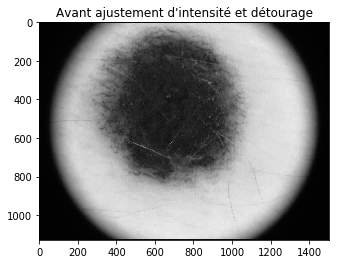

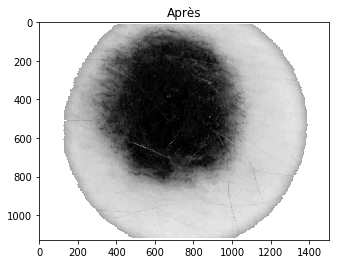

In [19]:
im=OpenImage("./nevus/ISIC_0000045.jpg")
plt.imshow(im,cmap='gray')
plt.title("Avant ajustement d'intensité et détourage")
plt.show()
im1=Retirer_cadre(im)
im2=AdjustIntensity(im1)
plt.imshow(im2, cmap='gray')
plt.title('Après')
plt.show()

On voit que le contraste a bien augmenté, ce qui était l'effet recherché.
De plus, on a bien une seule composante noire au milieu, ce qui sera utile au moment du seuillage. 



### Définissons maintenant la fonction Otsu
Celle-ci recherche le meilleur seuil possible et applique le seuillage à l'image

In [20]:
def otsu(im):
    hist,_ = np.histogram(im,range(0,256))
    Variance = np.zeros(256)         
    for k in range (0,256): 
        omega_1 = hist[0:k].sum().astype(float)
        omega_2 = hist[k:-1].sum().astype(float)
        m1 = np.mean(im[im<=k])
        if (np.isnan(m1)):
            m1 = 0
        m2 = np.mean(im[im>k])
        if (np.isnan(m2)):
            m2 = 0
        Variance[k] = omega_1 * omega_2 * ( (m1 - m2)**2)
    seuil = np.argmax(Variance)
    
    im3=im.copy()
    n=len(im)
    m=len(im[0])
    for i in range(n):
        for j in range(m):
            if im[i][j]>seuil:
                im3[i][j]=255
            else:
                im3[i][j]=0
    return im3
         

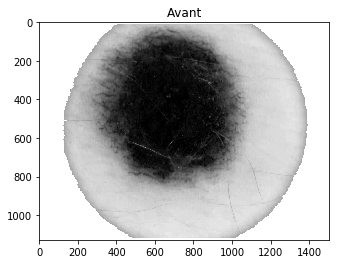

/home/paul/.local/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/paul/.local/lib/python3.6/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


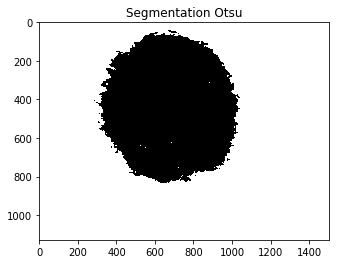

In [21]:
plt.imshow(im2,cmap='gray')
plt.title("Avant")
plt.show()
im3=otsu(im2)
plt.imshow(im3,cmap='gray')
plt.title("Segmentation Otsu")
plt.show()


Reste à effectuer une dilatation pour combler les trous blancs et ainsi obtenir notre composante connexe.

In [25]:
def dilatation_carrée(im,taille):
    t=taille//2
    n=len(im)
    m=len(im[0])
    im1=im.copy()
    for i in range(taille,n-taille):
        for j in range(taille,m-taille):
            for a in range(i-t,i+t):
                for b in range(j-t,j+t):
                    if im[a][b]==0:
                        for a in range(i-t,i+t):
                            for b in range(j-t,j+t):
                                im1[a][b]=0
                    break; 
                break; 
    return im1

def erosion_carrée(im,taille):
    t=taille//2
    n=len(im)
    m=len(im[0])
    im1=im.copy()
    for i in range(taille,n-taille):
        for j in range(taille,m-taille):
            for a in range(i-t,i+t):
                for b in range(j-t,j+t):
                    if im[a][b]==255:
                        for a in range(i-t,i+t):
                            for b in range(j-t,j+t):
                                im1[a][b]=255
                    break; 
                break; 
    return im1

    
        

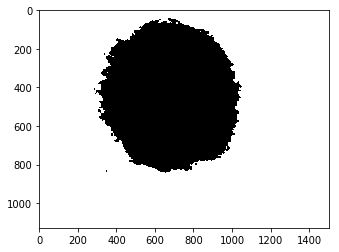

In [26]:
im4=dilatation_carrée(im3,7)
plt.imshow(im4,cmap='gray')
plt.show()
#im5=erosion_carrée(im4,9)
#plt.imshow(im5,cmap='gray')
#plt.show()

In [ ]:
def Retirer_le_cadre_image(im,pas):
    n=len(im)
    m=len(im[0])
    taille_min=(min(n,m)//2)-2
    xm=n//2
    ym=m//2
    avancee=1
    moyenne=0
    cpt=0
    while(moyenne<10 and avancee<taille_min):
        avancee=avancee+1
        for i in range(ym-avancee*pas,ym+avancee*pas):
            for j in range(xm-avancee*pas,xm+avancee*pas):
                moyenne+=im[i][j]
                cpt+=1
        moyenne=moyenne/cpt
    return avancee*pas

In [ ]:
Retirer_le_cadre_image(im3,10)

C'est beaucoup trop faible... On va tester autre chose 

In [ ]:
def estFaux(tab):
    for i in tab:
        if i==True:
            return False
        return True


def retirer(im,pas):
    n=len(im)
    m=len(im[0])
    taille_min=(min(n,m)//2)-2
    xm=n//2
    ym=m//2
    tab=[True,True,True,True]
    avancee=1
    while(not(estFaux(tab))):
        avancee=avancee+1
        if im[xm][ym+avancee*pas]==255:
            tab[0]=False
        if im[xm][ym-avancee*pas]==255:
            tab[1]=False
        if im[xm+avancee*pas][ym]==255:
            tab[2]=False
        if im[xm-avancee*pas][ym]==255:
            tab[3]=False
    return im[xm-avancee*pas:xm+avancee*pas,ym-avancee*pas:ym+avancee*pas]
            
        
        
        

In [ ]:
retirer(im3,10)

In [ ]:
im4=retirer(im3,10)
plt.imshow(im4,cmap='gray')
plt.show()

In [ ]:
def circle(im, r):
    n=len(im[0])
    m=len(im)
    xm=n//2
    ym=m//2
    somme = 0
    card = 0
    for x in range(n):
        for y in range(m):
            if ((x-xm)**2 + (y-ym)**2 >= r**2) :
                somme += im[y][x]
                card += 1       
    return somme/card

In [ ]:
def rayon(im):
    n=len(im[0])
    m=len(im)
    rmin=n//4
    rmax=(1/2)*sqrt(n**2 + m**2)
    nb_pas = 10
    pas=(rmax-rmin)/nb_pas
    Lrayon = []
    Lmoyenne = []
    r = rmin 
    for i in range (nb_pas) : 
        Lrayon.append(r)
        Lmoyenne.append(circle(im,r))
        r += pas
    return [Lrayon, Lmoyenne]

In [ ]:
def minMoyenne(im):   
    Lrayon, Lmoyenne = rayon(im)
    Mmin = 256
    indice = -1
    for i in range (len(Lrayon)):
        if Lmoyenne[i] > Mmin : 
            Mmin = Lmoyenne[i]
            indice = i
    return indice+4

In [ ]:
def nouvelleImage(im):
    n=len(im[0])
    m=len(im)
    xm=n//2
    ym=m//2
    return (im[xm-minMoyenne(im):xm+minMoyenne(im),ym-minMoyenne(im):ym+minMoyenne(im)])
  

In [ ]:
im4=nouvelleImage(im3)
plt.imshow(im4,cmap='gray')
plt.show()

1129 1504


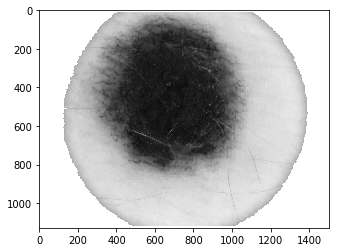

In [11]:
im=OpenImage("./nevus/ISIC_0000045.jpg")

plt.imshow(Retirer_cadre(im),cmap='gray')


1129 1504


/home/paul/.local/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/paul/.local/lib/python3.6/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


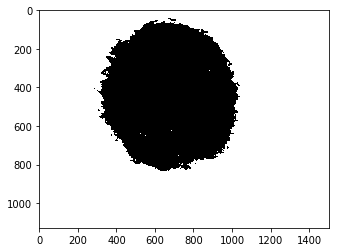

In [13]:
im2=Retirer_cadre(im)
im3=otsu(im2)

plt.imshow(im3,cmap='gray')

In [18]:
for i in range(len(im)):
    for j in range(len(im[0])):
        print(im[i][j])

255
255
255
238
255
246
255
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
254
254
254
254
254
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
254
254
254
254
254
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
254
254
254
254
254
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
254
254
254
254
254
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
254
254
254
254
254
254
255
255


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
14
0
7
22
0
247
255
0
2
0
4
1
0
0
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
5
5
5
5
5
5
5
5
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
7
7
7
7
7
7
7
7
7
7
7
7
7
7
7
7
8
8
8
8
8
8
8
8
7
7
7
7
7
7
7
7
7
7
7
7
7
7
7
7
8
8
8
8
8
8
8
8
8
8
8
8
8
8
8
8
8
8
8
8
8
8
8
8
7
7
7
7
7
7
7
7
8
8
8
8
8
8
8
8
10
10
10
10
10
10
10
10
11
11
11
11
11
11
11
11
13
13
13
13
13
13
13
13
5
5
6
6
7
8
8
8
10
11
14
15
16
17
20
20
28
29
30
31
33
34
35
36
39
40
41
43
44
46
47
48
53
54
55
57
59
61
62
63
66
67
68
71
73
75
77
78
76
77
79
80
82
82
82
82
85
85
8

212
215
212
214
212
214
213
216
217
220
220
221
220
221
220
221
220
218
216
217
215
216
216
217
217
220
218
219
218
218
217
217
216
218
216
216
214
214
212
212
211
215
214
214
212
212
210
210
208
210
209
210
209
210
209
210
209
207
206
207
205
206
204
205
204
204
203
204
203
204
203
204
203
205
204
204
202
202
200
200
198
202
200
199
197
197
195
196
195
198
197
198
197
198
197
198
197
196
195
195
193
193
191
191
190
192
192
191
190
188
187
187
186
184
183
182
181
180
180
181
181
178
176
176
173
173
170
170
168
167
167
168
167
168
166
166
165
166
165
165
164
162
161
161
160
156
155
155
154
152
151
151
150
150
149
148
146
145
141
140
139
138
137
136
133
132
131
131
130
130
129
130
128
128
126
126
125
123
121
120
117
116
113
112
110
106
105
107
105
105
103
102
101
98
96
96
93
92
89
88
87
87
85
84
79
76
74
72
69
66
63
63
62
61
59
58
56
46
43
41
39
37
35
35
34
35
34
33
30
28
26
24
24
18
15
15
13
12
11
10
10
11
11
10
10
9
8
8
7
8
8
8
8
8
8
8
8
5
5
5
5
5
5
5
5
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3


211
211
211
211
211
212
210
201
199
199
200
200
201
202
202
202
203
203
203
204
204
205
205
202
200
201
199
202
201
204
202
205
202
204
201
203
202
204
205
208
209
209
209
208
206
205
204
205
205
206
207
208
209
210
210
209
209
209
209
208
208
208
208
208
208
208
209
209
210
211
211
213
211
212
210
211
209
211
208
206
204
207
205
208
206
209
207
205
206
207
208
208
208
208
207
205
205
205
205
205
205
205
205
205
205
208
206
207
204
205
202
201
199
202
201
204
203
206
205
209
207
209
208
210
209
211
209
211
208
209
205
205
202
202
200
203
202
205
204
206
203
204
201
204
202
203
201
202
200
201
199
195
195
195
195
195
195
195
195
198
197
196
196
196
197
198
196
198
198
198
198
198
198
198
198
198
199
199
199
199
198
197
196
196
196
197
197
197
197
196
196
195
196
197
197
197
197
196
195
198
198
200
200
200
200
198
198
201
201
202
203
203
202
201
201
204
203
203
202
202
201
201
200
200
202
205
205
203
201
202
203
204
204
205
205
204
203
202
201
201
202
203
205
205
206
205
205
206
206
206


112
113
113
114
116
119
121
122
122
123
125
125
126
127
128
129
130
130
130
130
131
132
132
133
134
134
140
140
140
140
139
139
139
139
146
149
152
152
151
151
152
154
156
158
160
160
159
159
161
164
164
165
167
168
169
169
169
169
170
170
171
173
175
176
177
178
176
177
177
177
178
178
179
179
179
179
179
180
180
181
181
179
176
174
177
176
179
178
181
179
186
184
187
186
189
188
191
191
192
193
193
193
193
194
195
196
199
199
199
199
199
199
199
198
201
202
205
204
206
204
206
203
207
205
206
204
207
206
209
210
211
211
212
212
213
213
214
214
213
211
210
210
209
208
208
206
201
200
201
200
202
199
197
196
200
200
200
201
201
201
202
200
196
196
195
195
196
197
198
198
199
200
199
199
199
199
200
201
202
201
202
200
199
196
195
193
197
196
197
196
198
197
198
197
196
196
197
198
200
201
202
202
200
201
203
203
203
202
200
200
201
201
203
200
202
199
201
199
201
199
201
200
202
201
203
201
202
201
202
204
204
204
203
203
199
199
199
199
199
199
199
200
197
198
201
200
202
199
201
198


208
207
207
207
206
206
206
207
207
207
208
208
208
209
209
212
211
210
210
210
210
211
212
211
212
212
213
213
212
212
211
213
213
214
214
215
215
216
216
218
218
218
218
218
218
218
218
218
217
216
216
216
216
217
218
218
218
218
217
217
216
216
214
214
213
213
213
213
213
213
213
213
213
213
214
214
215
215
215
218
218
218
218
218
218
218
218
219
219
218
218
219
220
221
222
221
220
220
219
218
217
216
216
217
218
219
220
221
221
220
220
220
220
221
221
221
221
220
220
218
217
215
216
218
219
217
216
218
218
218
218
218
218
218
218
218
218
217
216
215
214
214
213
216
216
216
216
216
216
216
216
216
216
216
217
217
218
218
218
223
223
223
223
224
224
224
224
223
223
223
223
223
223
223
223
222
221
221
220
219
219
219
219
220
220
220
220
220
220
220
220
223
223
223
223
223
223
223
223
221
222
222
223
223
222
222
221
221
221
221
221
221
221
221
221
218
218
218
218
218
218
218
218
217
217
216
216
215
215
214
214
211
211
212
212
212
212
213
213
212
211
210
210
210
210
211
212
211
211
210


3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
0
3
0
0
4
253
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
6
6
6
6
6
6
6
6
6
6
6
6
6
6
6
6
6
6
6
7
7
7
8
8
8
8
9
9
9
10
10
10
12
12
13
14
15
16
16
17
18
19
22
23
24
26
29
29
37
37
38
40
43
44
4

4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
6
6
6
6
6
6
6
6
6
6
6
7
7
7
8
8
9
9
9
9
9
9
9
9
9
10
10
11
12
12
13
13
13
16
19
20
20
21
24
26
30
32
34
34
34
35
39
42
45
46
49
51
53
55
58
57
56
55
57
58
62
64
67
68
70
70
73
75
77
79
80
81
82
83
84
86
88
90
91
92
97
98
100
102
104
104
104
104
108
109
110
112
114
116
117
118
120
121
123
125
126
127
127
127
127
128
130
133
135
138
140
141
140
141
141
142
143
144
145
145
144
146
148
148
147
148
150
153
154
154
156
157
159
160
161
162
165
165
164
164
165
166
167
167
168
169
171
173
174
175
175
175
182
183
183
183
183
183
184
184
187
188
189
190
191
193
194
192
192
190
190
189
189
188
188
188
189
190
191
193
194
194
194
194
196
195
193
192
192
194
196
197
200
200
200
200
200
200
200
200
199
199
200
200
201
201
201
201
200
200
199
199
200
201
202
203
204
203
203
202
202
203
203
204
203
203
204
205
207
209
211
212
211
211
211
210
207
207
206
205
205
205
203
203
203
204
203
206
207
209
209
210
211
211
208
208
204
204
204

4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
2
0
0
3
253
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
6
6
6
6
6
6
6
6
6
6
6
7
7
7
8
8
10
10
10
10
10
10
10
10
10
11
12
13


11
12
13
14
14
15
16
19
21
23
24
28
28
31
31
32
34
37
39
40
40
45
47
50
51
51
52
55
57
60
61
62
64
66
68
69
70
73
76
78
79
79
80
84
87
89
90
93
94
95
97
98
98
100
101
103
106
108
109
110
110
109
111
114
115
114
114
115
116
119
121
123
126
128
130
131
131
132
133
135
137
138
139
139
139
143
142
141
141
142
144
146
147
147
148
150
151
152
152
152
152
156
156
156
156
157
157
157
157
161
161
162
163
164
164
165
165
168
169
169
170
171
172
173
173
175
176
176
177
178
179
180
180
183
183
184
185
186
187
188
188
188
189
190
191
192
193
194
195
201
201
202
202
201
200
199
198
195
196
198
200
201
202
202
200
200
198
197
198
199
200
202
203
202
202
203
203
203
203
204
204
205
206
206
206
207
207
208
208
205
204
203
202
202
204
206
207
208
208
208
209
210
210
211
211
210
210
211
211
210
209
208
208
211
212
213
214
212
211
211
209
208
208
205
205
206
207
206
206
205
205
204
204
204
204
205
205
204
204
204
203
203
203
202
200
199
198
199
200
201
201
200
200
197
196
195
194
194
194
194
195
192
192
1

8
8
9
9
9
9
9
10
10
11
11
11
12
11
11
12
12
13
14
15
15
20
21
24
27
29
32
35
36
39
39
40
42
45
46
47
48
51
53
56
57
57
58
61
63
66
66
68
70
72
73
75
75
79
81
84
85
85
86
90
92
98
99
102
104
106
108
110
110
105
106
108
111
112
114
114
114
114
117
120
121
120
119
121
122
123
125
127
130
132
134
135
135
134
135
137
139
141
141
142
142
145
145
144
143
144
147
149
150
150
151
152
154
155
155
155
155
158
158
159
160
161
163
163
164
164
164
165
165
166
167
168
168
167
168
168
169
170
171
172
172
180
180
181
182
183
184
184
185
187
188
188
188
188
189
189
189
189
190
191
193
195
197
199
200
201
201
202
202
202
201
199
199
204
204
204
204
203
201
200
197
201
199
199
199
200
202
203
204
202
202
203
204
205
206
207
207
208
208
209
209
210
210
210
211
208
207
205
205
205
207
209
210
210
210
210
210
210
209
209
209
210
210
211
211
210
209
208
208
211
212
212
211
210
209
208
205
207
205
205
204
205
204
205
205
200
198
197
197
197
197
198
198
197
197
197
196
196
196
195
195
200
201
201
202
202
201
20

166
167
170
169
168
168
168
168
169
169
174
173
172
170
170
169
169
170
170
169
168
168
168
168
169
170
171
172
174
175
176
175
174
172
175
175
176
177
177
177
176
176
175
177
179
181
181
181
180
179
176
177
177
178
179
180
181
181
179
179
179
178
178
177
177
176
176
176
176
176
176
175
175
175
175
178
181
182
182
182
183
185
187
187
188
188
189
189
189
189
186
186
185
185
186
187
188
188
191
191
191
191
191
192
193
194
193
193
193
193
193
193
194
194
197
197
197
197
197
197
197
197
197
198
199
200
200
200
200
199
203
205
204
204
205
206
207
208
208
207
206
205
205
205
205
206
209
209
209
209
210
212
213
214
214
213
211
212
214
215
213
212
211
211
212
213
213
214
215
215
217
217
216
216
215
215
214
214
212
212
212
213
213
213
214
214
212
212
212
212
212
212
212
212
217
217
217
218
218
219
219
219
218
218
218
218
219
219
219
219
217
218
218
218
218
217
216
215
216
216
217
217
217
217
218
216
215
214
214
214
214
214
214
214
215
215
215
215
215
215
215
215
214
214
214
214
214
214
214
214


4
4
4
4
4
4
4
4
4
4
6
6
6
6
6
6
6
6
4
5
5
5
6
6
7
7
6
6
6
7
7
7
8
8
8
8
9
10
11
12
13
13
12
12
12
13
16
17
17
18
24
25
26
28
32
34
35
37
37
40
43
46
48
50
51
51
56
58
61
61
63
63
66
68
71
71
73
74
76
78
80
81
82
82
86
88
89
91
93
93
96
99
102
103
104
105
108
113
114
114
114
115
116
118
120
121
118
119
120
122
124
127
128
129
129
129
130
131
133
134
135
136
135
136
140
140
143
142
145
143
145
144
147
146
148
146
147
146
152
153
154
155
157
158
159
160
161
162
164
165
166
167
166
166
161
162
164
166
168
169
169
169
175
176
176
176
176
176
177
177
179
179
180
181
182
183
184
184
184
184
184
184
185
186
188
191
189
189
188
188
189
190
191
192
192
192
193
194
195
196
197
197
200
200
200
201
201
203
203
203
204
204
206
207
210
210
211
209
206
204
201
202
205
208
208
208
207
207
207
206
207
208
209
210
210
210
211
212
212
211
210
210
206
205
205
205
205
206
207
208
209
207
207
208
208
208
209
209
210
210
209
208
207
206
206
205
201
200
201
202
202
202
202
202
203
203
204
205
205
203
203
202
1

105
103
103
101
100
100
100
101
104
105
106
112
113
116
117
119
119
117
117
114
112
113
113
117
120
124
127
127
129
129
131
134
137
141
143
150
150
151
152
153
152
152
151
151
149
150
148
151
150
154
155
158
158
158
158
158
158
158
158
159
158
157
155
154
152
151
151
157
160
162
163
163
163
166
168
170
171
171
172
171
170
169
169
163
163
164
165
165
164
163
163
162
161
159
157
156
155
155
155
155
154
157
159
162
164
166
167
168
168
170
170
172
172
172
173
169
171
174
174
175
174
175
176
177
178
181
183
184
185
187
185
186
184
185
185
186
186
186
187
187
187
187
187
187
187
186
186
187
186
185
184
184
184
187
187
188
188
192
193
195
197
198
199
201
201
200
199
199
200
201
201
202
202
202
201
201
200
200
200
202
202
203
203
204
204
205
205
207
207
207
206
206
206
205
205
206
207
208
209
209
210
211
211
213
213
213
214
214
215
215
215
215
215
215
215
215
215
215
215
215
216
217
218
218
218
218
215
213
214
215
215
215
215
214
213
213
213
213
213
213
213
213
213
213
213
213
213
213
213
213


4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
6
6
6
6
6
6
6
6
7
7
7
8
8
9
9
9
8
8
9
9
9
10
10
10
11
11
12
12
13
14
15
15
18
18
22
24
26
28
31
32
37
38
39
41
45
46
48
49
51
52
55
58
60
62
63
63
65
68
70
71
70
71
73
76
80
81
82
84
86
88
90
91
96
96
100
102
103
105
107
107
110
113
116
117
118
119
122
125
124
124
124
125
126
128
130
131
128
128
130
132
134
136
138
139
138
139
140
141
143
144
145
145
147
148
149
150
150
150
149
149
151
152
154
156
158
159
159
159
160
160
161
163
164
165
166
167
166
167
169
170
171
171
171
171
173
174
176
178
180
181
181
182
180
180
181
181
181
181
181
182
182
182
183
183
184
185
186
186
186
186
186
186
187
189
190
191
186
186
185
185
186
187
188
189
187
187
187
187
186
186
186
186
187
187
190
192
194
195
198
199
205
205
204
204
205
204
204
202
203
202
202
205
208
209
206
204
202
202
201
201
202
203
204
204
202
202
203
204
204
203
202
202
205
205
204
204
204
206
207
207
207
207
207
208
208
208
209
209
210
210
209
208
207
206
2

187
186
186
186
184
183
182
181
179
178
177
176
178
177
176
175
174
172
172
171
169
170
169
169
167
165
163
162
162
161
160
158
157
157
157
157
157
157
155
153
151
150
148
148
144
143
142
141
139
138
137
137
135
135
134
132
131
129
128
128
124
123
121
119
116
114
112
111
113
112
110
107
104
102
100
99
98
97
96
95
92
88
85
82
80
79
78
74
73
71
70
70
63
63
61
59
57
54
49
48
45
43
40
38
36
34
31
27
24
21
20
19
17
16
14
14
13
12
12
11
10
9
8
8
9
8
8
8
7
7
6
6
6
6
6
6
6
6
6
6
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
2
0
0
3
253
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1


3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
6
6
6
6
6
6
6
6
7
7
7
7
7
7
7
7
8
8
9
9
9
10
10
10
12
12
12
13
13
14
14
14
15
17
20
23
27
29
30
30
34
36
38
39
41
43
46
47
51
53
56
57
57
58
63
63
65
65
67
69
72
74
76
77
79
81
82
82
82
83
86
91
95
95
96
96
98
100
102
103
108
109
112
114
116
118
119
120
124
127
130
130
129
129
130
132
134
133
133
134
135
136
138
139
138
138
140
142
144
146
148
149
149
150
151
151
152
151
151
150
156
154
153
152
153
155
158
160
161
162
163
164
165
165
165
165
169
170
172
174
176
178
179
180
182
182
182
182
182
180
179
178
178
179
180
182
183
183
185
185
189
189
190
190
189
188
187
186
188
188
189
190
191
192
192
193
194
194
194
194
194
194
194
193
192
195
197
196
193
192
194
197
194
194
194
194
194
194
194
194
189
188
188
188
188
191
192
192
189
189
187
188
188
188
189
189
189
190
192
194
195
195
195
195
200
201
202
203
203
203
203
200
198
197
198
197
197
194
193
191
198
197
19

3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
4
4
4
5
5
5
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
7
7
7
7
7
7
7
7
7
7
7
8
8
9
9
9
8
8
9
10
11
11
12
12
12
12
13
15
18
19
20
21
26
26
30
32
33
35
38
38
41
44
48
50
50
50
52
54
57
57
59
61
62
64
66
66
72
74
76
78
80
81
82
82
87
88
89
90
91
92
93
94
102
103
104
106
108
110
112
112
114
114
116
118
119
121
123
123
127
129
131
133
135
136
137
137
138
138
138
138
139
141
142
143
146
146
146
147
148
150
152
153
154
155
156
158
159
159
159
159
162
162
162
163
165
166
168
169
171
171
172
173
173
172
171
171
170
173
176
178
178
179
181
183
183
183
184
184
183
182
181
178
178
176
177
179
182
184
185
185
189
189
192
192
191
190
190
188
193
192
194
195
196
196
196
196
196
197
198
198
199
198
197
197
199
199
199
200
200
200
201
201
199
199
200
200
199
198
197
196
197
195
190
188
187
188
189
190
188
188
189
189
189
189
189
189
191
192
192
193
193
193
192
192
191
193
196
199
201
201
201
200
1

126
126
126
128
126
119
117
116
113
114
111
110
109
105
105
109
109
109
105
105
101
100
97
96
95
95
93
93
93
94
93
90
86
84
80
81
79
84
86
88
88
89
88
92
95
92
93
93
96
96
96
96
96
93
92
93
92
92
89
89
87
89
90
94
96
100
101
103
104
101
101
101
100
103
102
106
107
102
101
100
99
96
96
96
98
106
110
112
108
103
102
107
113
115
115
115
115
116
117
119
122
127
130
130
131
131
130
129
128
130
130
131
131
131
130
128
126
126
126
125
124
124
123
122
122
123
123
123
123
123
123
123
121
123
123
122
124
124
124
124
125
128
131
134
137
139
141
141
139
140
140
140
140
139
137
136
135
137
136
135
134
134
136
137
138
143
143
145
148
151
151
148
145
144
145
145
146
147
148
149
151
155
156
156
157
156
158
159
158
156
156
155
152
153
150
149
147
154
153
152
151
151
153
153
154
151
151
152
156
158
159
160
161
158
152
148
146
147
147
146
145
150
150
150
148
145
145
148
153
161
163
165
166
167
168
171
172
173
174
174
175
178
179
180
180
177
177
177
176
175
175
174
174
177
179
180
180
179
178
180
184
182


223
223
223
223
223
223
223
223
223
223
223
223
223
223
222
222
222
222
223
223
223
222
222
221
221
221
221
222
222
223
223
222
222
221
220
220
220
219
219
219
218
218
219
219
218
217
216
215
214
214
209
209
208
208
207
207
207
207
207
207
207
207
206
204
203
202
201
201
200
199
200
200
201
202
200
199
198
197
196
195
194
194
195
195
194
194
191
190
188
188
188
187
184
183
180
178
177
177
181
180
179
177
175
174
172
171
170
170
169
167
166
164
163
163
163
162
161
159
157
155
154
153
151
150
149
147
146
146
146
146
142
141
140
139
138
138
138
139
135
135
133
132
129
126
123
122
122
120
117
116
116
115
112
110
109
107
104
103
103
102
99
96
96
94
92
90
85
82
80
79
76
75
72
70
68
67
63
62
59
58
56
53
50
47
43
42
37
36
33
31
29
28
26
25
22
20
19
17
16
15
15
15
13
12
12
11
10
9
8
8
8
8
7
7
6
6
5
5
6
6
6
5
5
5
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2

93
92
94
95
95
94
91
89
87
86
87
86
87
87
85
86
90
91
92
92
91
89
86
86
86
85
87
86
88
88
86
89
93
95
95
93
90
87
85
86
87
87
87
84
82
79
76
73
72
70
70
70
72
75
83
84
84
83
83
82
82
79
81
82
84
86
87
86
85
85
82
82
83
83
82
81
80
79
76
74
72
68
67
67
64
66
73
75
77
76
79
79
82
81
84
83
85
84
85
82
83
81
79
77
79
79
80
82
85
86
88
90
90
90
93
95
97
98
95
96
96
98
100
103
105
107
107
106
106
106
107
108
110
113
116
117
117
118
118
118
117
116
118
118
118
118
118
118
118
118
120
121
122
122
122
120
119
117
117
117
116
115
113
112
112
109
110
108
109
109
109
110
111
112
117
117
120
120
120
119
118
118
119
119
122
121
125
124
125
126
125
125
125
125
124
124
124
124
126
127
128
130
131
133
134
135
137
139
140
141
142
142
143
144
148
150
151
151
148
145
141
141
135
133
130
129
127
127
128
128
130
132
132
134
139
143
146
149
149
150
150
151
152
151
150
151
149
152
153
154
155
156
157
157
156
156
158
159
161
163
164
165
160
157
158
158
158
158
159
159
156
156
157
157
157
157
156
156
157
157
15

224
223
221
221
220
220
220
220
220
220
220
221
220
220
219
219
220
220
221
223
222
221
221
221
221
222
223
225
225
225
225
225
225
225
225
224
224
223
222
222
223
224
224
223
223
223
222
221
221
220
220
224
224
223
223
222
222
221
221
222
222
223
223
223
223
222
222
224
223
222
221
221
221
221
222
222
222
221
221
221
220
220
220
219
219
218
217
216
215
215
214
214
214
213
212
211
210
210
209
208
208
207
206
205
204
203
203
201
201
201
200
199
198
197
197
197
197
196
196
195
195
194
194
193
193
192
192
191
190
189
189
188
187
186
184
182
180
179
178
176
176
176
176
175
175
174
173
172
171
169
167
165
163
162
161
161
160
159
157
156
156
156
156
154
154
154
153
152
150
148
147
145
145
145
144
142
139
137
136
131
131
129
128
127
127
127
127
125
123
121
119
117
116
115
115
113
112
109
106
103
101
97
97
91
89
86
86
86
84
81
76
75
70
66
65
64
62
58
55
53
52
51
50
47
45
42
41
42
39
35
33
33
31
26
24
23
20
18
17
13
12
12
12
13
12
12
11
10
9
8
8
9
9
8
8
8
7
7
7
6
6
6
5
5
5
4
4
4
4
4
4
4
4
4
4
4

122
122
121
117
114
112
108
108
107
109
108
105
104
101
100
98
97
94
94
89
88
88
88
85
83
82
80
84
85
86
87
91
92
94
95
99
99
100
99
101
100
100
100
103
102
101
100
97
97
97
97
93
93
90
90
89
88
86
85
83
84
87
89
93
94
96
98
96
94
92
90
90
88
86
86
88
90
90
91
91
91
91
88
84
83
85
86
87
84
82
81
80
78
81
79
80
77
75
74
78
76
73
70
68
67
68
70
71
74
77
81
83
83
85
83
82
81
79
76
74
73
71
70
72
74
76
78
80
80
81
81
80
79
78
77
76
75
74
73
73
74
74
75
75
76
77
77
74
75
76
77
78
78
77
77
80
80
80
81
81
82
82
82
85
85
85
86
86
87
87
87
82
81
83
85
87
89
90
93
88
90
90
93
98
103
103
102
99
96
97
94
97
96
100
100
99
98
100
98
99
96
97
94
89
87
86
85
85
86
87
87
93
92
90
89
88
87
87
89
87
89
88
88
89
93
96
97
100
104
111
113
112
110
112
112
113
113
113
110
107
107
111
114
116
115
113
113
117
122
128
134
138
135
132
129
128
129
132
134
139
141
141
140
137
135
136
138
137
138
140
141
142
143
142
142
141
143
146
148
149
148
146
146
150
148
146
144
142
141
140
140
140
141
142
144
146
148
150
150
1

1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
5
5
5
5
6
6
6
6
7
7
7
7
7
7
7
7
9
9
9
10
10
11
11
11
13
14
14
15
16
17
18
18
18
19
22
24
26
28
31
32
38
38
38
40
43
45
47
48
54
55
57
59
61
64
65
66
67
67
69
70
72
74
75
76
78
79
81
83
88
90
94
95
98
99
102
103
105
107
108
107
105
107
109
112
114
116
117
117
119
121
122
124
126
127
127
127
134
134
134
135
136
136
137
137
139
139
140
141
143
145
147
149
154
155
157
158
158
159
161
161
164
164
164
165
167
169
171
171
172
170
170
170
171
173
174
175
179
179
181
182
182
182
182
181
184
184
185
186
187
188
188
189
189
190
191
192
193
193
192
192
189
190
192
193
194
195
195
194
197
196
196
195
195
196
196
197
195
196
197
199
202
202
204
204
203
203
204
204
206
206
206
2

179
188
201
211
214
214
214
215
217
218
219
220
220
220
220
219
222
221
220
218
218
218
218
218
222
222
221
221
220
219
219
219
220
219
218
217
217
217
217
218
220
220
221
220
221
221
221
221
225
225
227
227
227
227
227
225
223
221
223
220
222
219
221
219
222
220
222
220
222
220
222
222
225
225
225
225
225
225
225
225
225
225
225
225
225
225
225
225
228
228
228
228
228
228
228
228
227
228
229
230
230
230
230
229
229
230
230
230
230
229
228
227
227
227
228
229
229
228
227
227
226
226
226
225
225
225
224
224
223
223
223
222
221
221
220
220
221
221
221
221
220
220
219
219
222
220
218
218
220
220
218
216
217
217
217
217
217
217
217
217
216
215
213
211
209
209
208
208
211
211
210
210
209
209
209
208
206
205
205
204
203
202
201
201
201
201
201
201
200
199
197
196
196
196
196
196
195
194
192
191
186
186
185
184
183
182
182
181
183
181
178
175
173
173
173
173
171
171
171
170
169
167
165
164
163
163
161
160
158
156
154
154
150
150
149
147
146
145
144
143
141
140
138
136
135
134
134
134
128
128


209
212
212
212
212
212
212
212
212
211
211
211
212
212
213
213
213
216
215
214
213
214
215
215
215
215
216
217
218
219
219
218
218
220
219
218
218
218
219
220
220
220
220
220
220
220
220
221
221
221
221
220
219
218
218
219
219
220
220
220
220
220
220
221
221
225
225
227
227
227
227
227
227
225
225
224
224
223
223
222
222
222
222
222
222
222
222
222
222
225
225
225
225
225
225
225
225
225
225
225
225
225
225
225
225
228
228
228
228
228
228
228
228
227
228
229
230
230
230
230
229
229
230
230
230
230
229
228
227
227
227
228
229
229
228
227
227
226
226
226
225
225
225
224
224
224
224
224
224
225
225
225
225
223
223
222
222
222
221
221
221
223
221
219
220
221
222
220
218
219
219
219
219
219
219
219
219
219
217
216
214
212
212
211
211
214
213
213
213
212
212
211
211
209
209
208
207
206
205
205
204
204
204
204
204
203
201
200
199
199
199
199
199
198
196
195
194
190
190
189
188
187
187
186
186
185
184
183
182
180
178
176
175
174
174
174
173
172
170
168
167
166
166
164
162
161
159
157
157
155


1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
0
2
0
0
4
254
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
5
5
4
3
3
4
5
5
4
4
4
4
4
4
4
4
7
7
7
8
8
9
9
9
7
7
8
9
10
11
12
12
13
14
15
17
19
21
22
23
26
26
26
27
29
32
34
36
41
41
43
44
47
49
50
51
56
57
60
63
65
67
71
72
72
73
75
77
80
82
84
84
85
88
90
90
90
90
93
95
100
101
103
105
107
110
111
112
115
116
117
119
121
122
124
123
125
124
128
130
132
132
135
135
134
136
137
139
143
144
144
142
143
143
144
145
146
148
149
149
153
153
154
154
154
155
155
155
158
159
161
163
164
165
165
165
169
169
169
169
171
173
175
176
174
174
175
175
176
176
176
177
177
177
178
180
181
183
184
184
183
183
185
186
189
190
190
189
193
195
198
197
195
194
197
199
200
20

206
205
205
206
207
207
207
207
206
205
209
209
208
208
208
207
207
207
207
207
207
208
208
208
209
209
211
211
211
211
211
211
211
211
212
212
212
212
212
212
212
212
213
213
212
212
213
214
215
215
215
215
214
213
212
212
213
213
215
215
215
215
215
215
215
215
216
216
216
216
217
219
220
221
220
220
220
219
219
218
218
218
218
218
219
219
219
219
219
219
219
219
218
218
218
217
218
218
222
222
224
224
224
224
224
224
223
223
223
223
223
223
224
224
225
225
224
223
222
222
223
223
223
223
224
224
225
225
226
226
224
224
224
223
223
222
222
222
225
225
226
226
227
227
228
228
227
227
228
229
228
228
227
226
228
228
229
230
230
229
228
228
229
229
228
228
228
227
227
227
227
227
227
227
227
227
227
227
228
228
228
228
228
228
228
228
228
228
227
227
227
226
226
226
225
225
224
223
223
224
225
225
224
224
224
224
224
224
224
224
223
223
223
223
222
221
219
218
215
216
216
217
217
216
216
215
215
214
214
214
214
213
213
213
212
212
211
209
208
207
206
205
205
205
205
205
204
203
201
200


2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
3
0
0
3
252
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
6
6
6
6
6
6
6
6
6
6
6
7
7
7
8
8
6
6
7
8
9
10
10
11
11
12
13
14
15
17
18
18
24
25
26
28
31
33
34
35
40
43
47
48
48
50
56
57
58
57
60
62
64
66
69
70
73
74
75
77
81
83
84
85
89
89
90
91
93
95
97
99
101
101
103
104
106
108
109
110
116
117
118
119
121
122
123
124
126
128
130
132
134
135
136
136
138
138
139
140
142
143
144
145
147
147
147
147
148
148
148
146
149
148
149
150
152
153
154
155
155
155
156
158
159
160
161
162
167
167
169
170
171
172
172
171
171
171
173
175
176
178
180
180
181
181
182
183
184
185
186
186
186
186
185
185
185
1

174
175
177
181
184
188
190
188
187
189
189
192
193
195
196
198
200
202
203
203
203
202
202
203
203
203
203
203
203
203
203
203
204
206
208
209
209
208
207
207
207
207
207
207
207
207
207
208
208
208
208
208
208
208
208
210
210
210
209
209
209
208
208
209
209
208
208
209
210
211
212
210
211
212
213
214
214
213
213
211
211
211
212
212
213
213
213
213
212
212
211
211
212
212
213
215
216
217
217
217
217
216
215
217
217
216
216
216
215
215
215
217
217
217
217
217
217
217
217
218
218
218
218
218
218
218
218
218
218
218
217
217
216
216
216
218
218
218
218
218
218
218
218
216
216
216
217
217
218
218
218
219
219
218
217
217
218
219
219
220
220
220
220
220
220
220
220
220
220
220
220
220
220
220
220
221
222
223
224
224
224
224
223
224
224
223
223
222
222
222
221
227
227
227
227
227
227
227
227
226
226
227
227
227
228
228
228
227
227
228
229
229
228
227
227
228
228
228
228
228
228
228
228
230
230
230
230
230
230
230
230
229
229
228
228
228
228
229
229
228
228
228
227
227
227
226
226
226
226
227


90
88
85
79
74
70
66
65
67
68
68
68
68
67
66
65
64
61
58
56
57
58
57
56
49
49
48
48
50
50
51
52
56
61
64
60
63
66
65
61
61
62
63
64
66
67
68
71
68
67
66
64
62
63
62
60
59
58
58
59
60
60
58
57
55
54
53
53
52
53
53
53
49
49
48
47
46
45
45
44
46
48
50
49
46
43
42
41
39
39
38
38
39
40
41
42
42
42
42
42
44
45
47
48
54
58
61
60
60
58
59
59
51
49
44
39
36
37
37
39
35
38
42
44
47
48
51
54
56
58
62
64
64
62
60
56
49
48
49
50
52
55
57
58
62
62
62
61
60
59
58
57
55
55
55
54
54
53
53
53
51
51
52
52
51
50
49
48
50
52
54
57
62
64
65
65
62
62
65
64
62
59
57
51
42
42
44
47
52
53
54
55
55
52
50
50
53
55
58
56
56
57
59
60
61
62
65
66
71
72
73
75
77
76
75
74
75
75
74
73
74
72
73
72
78
77
77
76
76
73
70
69
76
79
80
81
78
77
76
77
78
79
79
80
80
81
81
82
83
85
87
86
86
89
97
101
102
99
96
93
94
96
100
101
102
105
107
107
104
101
100
101
97
99
101
103
106
109
112
115
117
119
120
121
123
125
128
129
132
133
136
137
137
136
135
132
130
128
130
130
131
131
132
133
133
133
133
134
138
141
145
147
147
148
149
15

189
191
193
194
197
197
197
197
197
197
197
197
194
194
193
193
192
192
191
191
190
189
188
187
186
185
182
182
180
179
176
177
178
178
175
172
173
173
172
172
169
168
165
165
166
166
164
164
163
163
163
162
159
155
154
152
155
156
161
164
163
160
156
153
153
153
153
154
154
154
155
156
156
157
158
158
160
159
157
155
153
151
149
149
151
151
151
151
150
150
150
150
145
145
142
142
142
142
141
142
139
136
132
128
126
126
126
127
128
129
129
131
132
133
134
133
130
126
124
120
115
112
111
110
113
114
117
119
119
119
119
113
106
100
97
93
90
89
87
87
88
89
88
89
90
91
93
93
85
83
84
82
86
86
91
91
95
95
92
91
88
86
82
81
85
86
89
91
94
94
96
96
95
93
93
90
87
85
83
84
89
91
94
95
94
92
90
88
84
81
76
68
65
60
60
58
67
68
68
68
68
67
66
65
68
66
64
64
64
63
59
56
48
47
44
42
41
41
41
42
46
47
47
43
44
48
50
46
47
47
47
47
47
48
48
50
46
44
41
40
39
40
43
45
45
47
48
49
51
51
49
49
49
46
43
44
47
49
48
44
41
41
40
39
38
37
37
36
40
43
45
45
42
39
38
37
36
36
35
34
33
34
34
34
35
35
34
35
35

121
122
124
125
126
127
129
129
131
131
130
131
134
137
140
139
135
133
134
137
140
140
137
134
135
133
132
129
125
121
124
127
141
148
153
156
158
158
158
160
162
162
165
165
166
167
169
169
173
173
174
175
176
176
177
177
176
175
174
174
174
174
175
176
176
177
180
181
184
182
183
181
187
188
193
195
199
199
199
199
198
198
197
198
199
202
204
206
204
204
204
204
204
204
204
204
205
205
206
206
206
207
207
207
208
208
208
208
207
207
207
207
206
206
206
206
207
208
210
211
208
208
208
209
209
209
210
210
212
212
213
213
213
214
214
214
212
212
212
212
212
212
212
212
214
215
215
213
211
210
212
214
216
216
216
216
216
216
216
216
218
217
215
214
214
215
217
218
217
217
217
217
217
217
217
217
220
219
218
217
217
218
219
220
221
220
220
219
219
220
220
221
219
219
218
218
218
217
217
217
217
217
216
216
216
216
217
217
220
219
218
217
216
217
217
217
218
218
218
219
219
220
220
220
218
218
218
218
218
218
218
218
221
221
221
220
220
219
219
219
215
214
214
213
213
212
212
212
208
210


90
91
94
97
98
100
101
103
104
108
111
112
114
116
115
113
112
117
116
115
113
114
117
119
120
121
120
120
123
125
129
132
134
135
133
132
133
135
136
134
133
131
133
133
131
129
129
133
135
143
147
149
148
147
147
148
150
154
154
158
159
161
163
166
167
171
171
172
173
174
175
175
176
176
175
174
174
174
174
175
176
178
179
180
182
186
189
192
193
187
187
189
189
191
192
194
194
196
197
198
199
200
200
199
199
202
202
202
202
202
202
202
202
205
205
206
206
206
207
207
207
205
206
206
207
208
209
209
210
206
206
206
206
207
208
210
211
208
208
208
209
209
209
210
210
212
212
213
213
213
214
214
214
212
212
212
212
212
212
212
212
214
215
215
213
211
210
212
214
214
214
214
214
214
214
214
214
217
215
214
213
213
214
215
217
218
218
218
218
218
218
218
218
216
217
217
218
218
217
217
216
219
219
218
217
217
218
219
219
219
219
218
218
218
217
217
217
217
217
216
216
216
216
217
217
218
217
217
217
217
218
219
220
218
218
218
219
219
220
220
220
218
218
218
218
218
218
218
218
218
217
2

16
14
14
14
14
12
12
11
10
9
8
7
7
6
6
6
6
6
6
6
6
7
7
6
6
5
5
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
3
0
0
3
252
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
4
5
5
5
5
4
3
4
4
4
4
4
4
4
4
4
4
5
5
6
6
7
7
6
6
6
7
7
7
8
8
7
8
8
8
9
9
10
10
13
14
15
16
17
19
20
20
24
27
28
30
33
35
36
37
40
42
48
49
49
51
56
57
55
56
58
60
62
64
66
67
69
71
73
73
73
73
75
77
85
86
89
91
94
97
99
101
102
105
108
109
109
110
113
115
117
118
120
123
125
126
126
126
127
127
127
128
128
129
129
130
131
132
132
133
134
135
136
136
137
138
139
141
143
144
146
14

191
191
190
191
192
193
194
194
193
193
191
189
189
190
190
190
191
191
192
192
192
192
190
189
187
186
190
189
188
186
185
184
182
182
182
183
184
186
186
186
185
184
184
182
180
178
178
178
179
180
182
180
177
175
174
174
175
177
179
177
175
173
172
172
173
173
174
174
173
171
170
168
167
167
163
161
161
161
161
161
159
159
154
153
151
146
144
143
143
144
146
149
150
152
155
157
158
159
162
161
160
162
165
166
164
162
158
156
156
157
159
161
158
156
153
154
153
153
154
154
154
153
153
153
153
153
154
154
154
154
152
150
148
149
151
152
150
147
138
137
137
136
135
135
135
134
141
140
139
138
137
135
134
135
136
138
135
132
131
129
127
124
125
120
117
113
111
107
104
100
93
92
94
98
103
108
114
118
116
116
116
113
112
109
107
105
103
101
99
98
94
92
89
89
85
83
82
78
76
71
69
69
64
65
66
69
73
76
82
84
87
88
91
93
95
95
96
89
72
63
62
61
67
68
69
64
68
63
61
55
56
55
59
61
61
59
59
60
62
59
54
50
50
50
50
50
52
55
58
58
56
54
52
51
51
51
53
55
58
59
63
65
67
66
65
64
65
63
59
56
54
54


107
105
103
100
99
98
95
93
91
88
86
84
83
81
71
69
67
66
63
61
59
57
57
55
53
50
46
43
41
39
37
36
33
31
28
25
21
20
16
15
13
12
9
9
9
9
11
10
10
9
8
7
6
6
7
7
6
6
5
5
4
4
5
5
5
4
4
4
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
3
0
0
3
252
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
6
6
6
7
7
7
8
8
6
6
7
7
8
8
8
9
7
8
11
12
14
15
18
19
22
23
25
27
30
33
34
35
41
41
43
45
47
48
50
50
53
54
55
57
59
61
62
63
69
70
71
73
75
76
78
79
81
82
83
85
87
89
90
91
92
93
95
97
99
101
103
104
107
108
109
111
113
115
116
117
120
121
123
12

79
74
71
67
64
64
62
56
53
51
49
48
49
48
49
43
45
46
48
46
46
45
46
47
46
44
41
39
39
44
49
53
53
54
52
51
50
47
46
46
47
46
45
43
43
46
49
54
55
58
60
61
61
60
59
56
57
57
58
59
59
59
58
61
62
62
63
62
64
63
63
56
56
57
59
63
68
74
77
79
78
77
75
77
76
77
77
72
73
77
79
83
85
87
88
91
90
90
91
94
93
91
87
89
87
82
79
78
80
80
84
82
84
87
91
96
101
106
107
110
110
111
114
115
119
123
124
133
137
140
139
140
143
147
150
148
149
152
154
158
161
166
168
166
166
167
168
171
172
173
173
176
176
176
177
178
178
179
179
184
184
186
186
187
187
189
190
191
192
192
193
192
191
190
190
190
190
191
192
194
195
196
196
200
202
202
200
197
196
199
201
199
201
202
201
198
197
198
200
201
201
202
202
204
206
207
209
209
209
210
210
209
208
207
206
206
206
207
207
208
208
209
209
207
207
206
206
207
208
209
210
215
215
214
213
213
214
215
215
216
215
213
211
210
210
211
211
212
211
210
209
209
209
209
210
211
211
212
212
212
213
213
213
214
214
214
214
214
214
214
214
216
216
216
216
217
217
218
218


182
182
181
177
177
175
173
170
168
166
165
163
161
159
160
161
161
159
157
153
151
149
147
145
144
142
141
136
135
133
131
128
126
125
124
120
120
120
119
118
116
114
113
109
107
105
103
100
97
95
94
94
91
88
86
85
83
79
76
74
72
70
68
65
62
60
59
56
53
51
48
45
41
39
35
35
34
32
29
26
24
22
19
15
14
14
13
12
11
10
10
9
8
8
8
7
7
6
6
6
6
6
5
5
4
4
4
4
4
4
4
4
4
4
4
2
3
3
4
4
3
3
2
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
3
0
0
3
252
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
4
5
6
7
7
6
6
6
6
6
7
7
7
8
8
9
10
10
11
12
13
13
14
14
14
17
18
20
22
27
28
31
34
37
38
39
40
43

71
71
71
71
70
69
67
64
58
47
40
40
40
39
41
46
49
47
45
44
44
45
47
48
46
43
40
41
41
43
47
49
52
53
51
49
50
49
50
47
40
37
36
37
40
42
48
53
50
54
61
65
71
71
73
68
52
45
40
39
40
43
43
43
46
47
45
45
44
43
42
44
51
53
52
51
52
55
58
60
61
62
63
64
65
66
67
68
72
73
73
70
67
62
58
55
57
61
60
55
55
55
56
48
45
42
42
44
46
51
55
58
65
69
74
77
80
79
80
78
81
78
82
84
85
87
90
92
99
99
98
94
91
85
79
77
80
80
79
76
74
72
70
69
68
69
71
72
75
79
81
82
79
84
89
94
99
105
113
120
127
131
135
141
144
146
148
146
144
141
144
145
148
151
157
159
162
162
161
161
162
163
165
165
168
171
174
177
180
178
176
175
177
177
180
181
181
180
181
181
179
178
180
181
182
183
183
182
184
185
185
183
180
179
181
185
191
194
195
195
194
194
196
199
200
202
204
203
201
199
199
200
200
200
200
201
202
204
206
207
205
205
205
205
205
205
205
205
208
208
208
209
209
209
210
210
210
209
208
208
208
208
209
210
212
211
211
210
210
211
211
212
212
212
212
212
212
212
212
212
214
213
212
211
211
211
211
212
214
2

41
41
38
38
35
35
35
38
48
58
65
68
75
85
88
86
85
82
79
73
66
60
55
53
51
46
42
42
39
36
38
41
42
41
40
42
42
43
46
45
43
43
43
43
44
46
48
49
51
51
51
51
49
48
46
45
45
45
46
49
50
50
51
51
52
52
53
52
51
52
52
51
53
50
46
43
44
47
51
52
58
55
55
54
53
51
52
50
50
51
51
49
47
48
51
54
57
58
59
61
61
62
61
60
61
59
61
60
59
57
56
55
50
52
54
57
61
63
63
60
53
48
48
47
48
48
48
48
50
52
55
56
59
61
67
70
69
71
73
75
75
76
83
85
91
90
88
87
82
79
77
76
82
84
84
82
83
83
84
84
78
76
76
74
75
77
78
81
84
84
84
86
91
97
103
109
119
123
126
131
133
132
133
131
129
130
132
133
136
141
148
153
155
155
157
155
153
154
159
162
162
163
169
174
175
175
175
173
176
176
175
174
176
175
175
174
177
177
176
176
177
178
179
180
182
182
181
180
181
181
182
185
189
190
189
189
189
189
190
191
193
195
196
198
200
202
203
204
205
204
204
204
203
203
203
203
199
199
199
200
200
201
201
201
204
203
203
205
208
210
210
209
208
207
206
206
206
207
208
208
210
210
210
210
210
210
210
210
211
211
211
211
211
21

215
215
215
214
214
216
215
213
212
211
211
211
211
210
210
211
211
211
210
209
208
208
208
207
206
206
205
204
204
202
200
197
194
192
191
190
190
191
191
190
189
188
187
186
186
185
185
185
185
185
185
185
185
182
181
178
175
173
171
170
170
169
168
167
165
163
161
159
159
159
159
157
156
155
154
152
151
148
146
144
142
138
137
136
136
137
136
135
134
131
129
126
125
122
122
121
120
118
115
113
112
108
106
104
103
104
103
99
96
92
89
84
82
81
79
76
73
74
73
71
68
64
62
58
57
55
54
50
47
42
39
37
36
31
30
26
24
22
21
18
18
14
14
13
12
9
8
7
7
7
7
6
6
5
5
4
4
6
6
6
6
5
5
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
3
0
0
3
252
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3


96
98
98
101
103
106
108
109
109
112
112
113
115
118
121
124
125
132
133
135
136
138
138
138
138
138
138
138
138
139
141
142
143
144
144
145
147
148
149
150
151
153
153
154
156
157
158
159
160
161
161
161
161
162
163
165
166
167
168
169
170
172
173
174
174
179
178
178
177
178
178
179
180
182
182
181
181
182
183
184
185
183
184
186
188
189
190
190
190
191
191
192
192
193
193
194
194
194
195
196
197
197
197
197
196
199
198
198
198
198
199
200
201
203
203
202
201
200
199
196
196
196
197
196
196
193
191
189
187
188
186
187
187
188
189
190
190
190
190
188
187
184
182
180
179
185
185
185
185
184
184
184
184
181
182
181
180
179
176
172
170
170
169
168
167
166
167
167
167
171
170
169
169
168
169
170
170
168
166
164
162
161
162
163
165
166
165
165
165
164
164
163
163
165
162
159
158
158
160
158
157
147
147
143
142
139
137
135
135
131
131
131
130
128
127
126
124
122
121
119
118
118
118
117
117
116
113
111
110
108
107
107
107
107
106
106
106
106
107
110
111
113
115
116
116
117
117
117
117
114
114

227
227
226
225
224
224
225
225
226
226
225
224
223
222
223
223
223
222
222
221
221
219
221
220
219
219
219
218
219
219
220
219
220
219
219
219
219
220
221
221
221
220
220
219
219
219
217
216
215
213
212
212
212
212
214
214
213
212
211
210
210
209
210
209
207
205
204
203
203
201
199
197
196
195
193
192
191
190
189
189
188
187
186
185
185
184
188
185
183
182
183
182
180
178
174
174
173
172
170
169
168
167
167
167
164
163
161
159
155
155
152
152
151
150
146
145
144
143
138
138
138
137
135
132
130
129
129
128
127
125
123
121
120
120
121
120
117
115
115
113
108
106
100
99
97
94
92
90
88
87
84
83
81
79
75
73
69
69
66
65
61
58
53
50
48
47
46
45
44
41
37
35
33
30
26
26
23
21
19
17
14
13
9
9
9
8
8
7
7
7
7
7
6
6
5
5
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
3
0
0
3
252
253
4
0
0
4
0
3
1
1
1

56
57
60
63
65
66
68
68
71
72
71
71
72
69
66
64
67
68
71
73
78
79
77
75
75
72
69
67
66
66
64
66
67
68
68
67
66
66
65
65
66
66
65
64
62
62
58
57
55
56
57
58
57
56
57
56
55
53
53
52
53
53
57
55
53
50
52
55
60
60
53
51
52
54
56
53
51
48
41
38
38
37
38
40
43
44
47
46
44
41
37
34
31
30
27
30
34
36
39
41
42
41
36
32
32
33
36
35
35
33
37
37
35
35
35
37
39
40
44
45
46
45
42
41
43
45
40
42
45
47
49
46
42
39
32
32
32
32
31
30
31
32
32
33
33
34
36
40
41
42
45
46
47
47
49
50
50
48
48
47
46
46
46
47
48
48
41
43
46
47
47
45
43
41
38
39
40
42
46
49
54
56
56
56
57
57
59
58
57
56
52
50
45
40
36
33
33
31
32
35
41
48
53
57
58
57
58
58
59
59
58
56
54
53
47
48
50
51
52
51
51
50
55
54
53
53
55
58
64
66
75
76
78
77
76
78
81
85
82
81
80
79
79
80
81
82
87
88
88
89
88
86
85
84
82
82
83
84
89
94
102
106
107
108
111
112
115
117
120
120
122
123
126
129
132
135
139
140
141
141
141
142
145
146
147
147
143
142
143
144
146
149
153
155
163
165
167
166
166
164
164
163
163
161
161
161
161
161
161
161
160
160
160
160
161


220
221
221
222
222
222
222
222
222
222
222
226
226
226
226
226
226
226
226
225
225
224
224
224
224
225
225
227
227
226
226
225
225
225
225
225
225
225
225
225
225
225
225
226
226
226
226
226
226
226
226
226
226
225
225
224
224
223
223
223
224
225
225
225
225
224
223
224
224
223
222
221
221
220
220
221
222
223
224
223
222
220
218
220
219
218
217
216
217
217
217
218
218
218
217
217
217
216
216
213
213
212
210
209
208
207
206
205
204
204
203
202
201
200
200
200
199
199
198
197
196
195
195
190
191
191
190
189
188
186
186
185
184
183
181
179
177
176
175
174
174
172
170
168
166
164
163
163
162
161
160
158
157
156
155
150
150
149
149
147
145
143
142
141
141
140
139
137
134
132
131
129
128
127
124
122
120
118
117
113
110
107
105
104
102
99
96
98
97
95
93
89
86
85
84
81
78
73
71
70
68
63
60
62
61
57
55
52
49
45
44
37
36
33
31
27
26
25
22
16
14
13
12
11
10
10
9
8
8
8
8
8
8
8
8
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3

6
6
6
6
6
6
6
7
7
8
8
8
9
9
9
11
12
13
14
15
17
18
18
23
24
25
27
29
31
32
33
36
36
37
39
41
44
46
48
53
54
57
59
62
64
64
65
69
70
71
73
75
76
78
79
82
83
85
87
89
91
93
94
96
97
99
101
104
106
108
109
109
108
109
111
112
113
114
115
120
121
122
124
126
128
129
129
134
134
135
135
136
137
138
138
140
140
141
143
144
146
147
149
153
153
154
155
155
156
157
157
158
159
161
164
166
167
168
168
168
168
169
171
172
174
175
175
175
176
178
179
180
180
180
180
185
185
184
184
185
186
187
188
189
189
189
189
190
192
193
194
195
195
195
195
195
195
195
195
196
196
198
199
199
199
198
198
198
197
197
196
196
197
197
198
199
199
199
199
199
199
199
197
199
197
197
196
196
195
195
195
196
196
196
197
196
195
194
193
189
188
186
185
182
182
183
183
181
180
176
175
175
176
175
177
179
178
177
175
173
171
169
168
170
171
171
171
170
169
167
164
157
153
151
151
150
150
147
144
136
137
135
136
136
136
134
134
133
133
133
134
134
134
134
135
134
134
134
134
133
133
133
133
131
129
129
129
128
126
124
1

51
51
50
50
47
45
46
43
43
40
41
39
44
42
45
43
45
42
43
44
50
48
47
47
43
35
30
30
34
31
33
34
37
36
35
32
32
29
30
32
37
38
39
36
33
34
37
41
42
43
41
39
45
43
43
43
42
44
44
44
47
49
50
49
48
49
51
56
60
63
64
66
65
67
71
74
71
71
72
71
70
67
65
63
62
57
53
52
53
55
54
53
56
55
52
50
48
48
49
48
44
42
43
43
42
41
39
39
39
39
39
38
36
34
32
31
36
36
36
35
36
36
37
37
34
31
30
27
26
26
27
29
42
41
37
33
31
30
29
29
36
39
42
42
41
41
42
48
53
55
54
52
49
48
45
45
47
48
49
50
47
45
42
40
49
49
49
50
52
54
56
57
58
57
56
55
54
55
55
58
69
70
70
70
71
73
74
76
73
74
74
71
69
68
62
54
52
47
44
42
40
41
41
41
42
41
42
44
47
49
48
47
51
48
48
47
45
43
37
33
37
35
33
31
31
33
33
37
41
46
49
49
48
50
54
57
55
54
52
50
48
47
47
47
42
43
44
46
50
52
56
56
58
57
54
53
52
53
55
55
51
50
49
50
52
52
50
47
46
45
44
42
41
39
38
37
42
45
49
53
55
56
55
54
61
63
63
65
68
69
68
66
62
62
64
65
66
67
67
66
67
67
67
66
64
62
59
58
55
51
49
58
71
83
89
90
95
97
101
104
109
111
116
115
116
115
117
118
116
11

3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
5
5
6
6
7
7
6
6
6
7
7
8
8
8
6
7
9
10
11
12
15
15
20
21
22
24
27
29
30
31
32
35
38
40
40
42
45
48
47
49
52
54
54
55
58
61
66
66
68
70
71
73
75
75
78
79
80
82
84
86
87
88
91
92
94
96
98
101
102
103
106
107
109
112
115
117
119
121
123
124
124
125
126
127
128
128
131
131
132
133
135
136
137
138
141
141
142
143
145
146
147
148
149
149
150
151
152
153
154
154
153
153
152
152
153
154
155
156
157
158
159
161
164
166
168
169
173
174
174
175
176
178
178
179
177
178
178
178
179
179
180
180
180
180
181
181
182
182
182
183
183
183
182
183
184
185
187
188
190
189
188
188
190
193
196
198
203
200
196
194
194
193
191
189
195
195
193
193
192
192
189
189
185
185
185
185
184
184
184
184
186
186
187
187
187
186
184
184
182
181
181
180
179
178
177
175
165
161
159
156
153
151
150
147
144
141
141
139
139
139
139
140
142
141
141
139
139
137
138
136
137
137
139
140
142
140
141
139
139
139
139
139
138
137
135
134
135
135
136
137
138
138
138
138
140
138
136
134


3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
5
5
6
6
7
7
6
6
6
7
7
7
8
8
9
9
10
10
11
13
16
17
23
24
26
27
30
32
33
34
36
39
42
44
45
47
50
53
54
55
56
58
60
62
64
65
66
68
70
73
76
78
79
80
84
85
86
88
90
92
93
94
94
96
98
101
104
105
106
106
112
112
114
115
117
119
121
121
128
128
129
130
131
131
132
132
131
132
134
135
137
139
140
141
144
144
145
146
147
148
148
149
152
153
154
155
155
155
154
154
156
157
157
158
159
160
161
161
163
164
166
169
171
172
173
173
180
180
181
182
182
183
184
184
183
183
183
183
183
183
183
183
185
186
187
188
188
188
188
187
188
189
189
190
191
192
193
193
195
195
195
196
196
196
196
196
197
196
195
195
195
195
196
197
196
196
195
195
196
197
195
196
195
195
195
194
193
193
192
192
195
195
195
194
194
193
193
193
191
190
189
188
187
186
187
186
176
174
174
174
172
167
163
159
157
157
157
155
154
154
154
153
146
145
145
145
145
144
144
143
144
144
143
143
142
141
140
140
145
145
146
145
142
138
134
132
135
136
139

3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
5
5
6
6
7
7
7
7
8
8
8
9
9
9
10
10
12
13
15
17
21
22
26
27
28
30
33
35
36
37
39
42
45
47
48
50
54
56
62
62
63
63
64
65
65
66
74
75
77
79
80
80
80
80
87
88
89
91
93
94
96
97
99
100
103
105
108
110
110
111
113
114
115
117
119
121
122
123
129
129
130
131
132
133
134
134
136
137
138
140
142
143
145
146
147
147
148
149
150
151
151
152
154
155
157
159
160
160
160
160
165
165
166
167
168
169
169
170
169
170
172
174
175
175
176
176
180
180
181
182
182
183
184
184
187
187
187
187
187
187
187
187
186
187
188
189
190
190
189
189
188
189
189
190
191
192
193
193
193
193
194
195
196
197
198
199
198
198
197
196
196
197
198
198
201
201
198
198
197
196
194
193
194
194
193
193
192
191
191
191
192
192
192
192
191
191
190
190
190
189
187
185
184
183
183
183
187
184
183
182
180
176
174
171
173
173
172
169
168
166
166
165
161
158
157
153
153
151
153
151
154
152
153
150
151
149
150
148
145
145

188
188
192
194
197
199
199
202
203
204
204
204
205
204
204
207
208
209
210
209
209
209
208
209
210
211
213
214
215
216
215
215
214
213
213
213
214
215
214
213
212
212
212
212
213
214
216
216
216
216
217
217
217
217
218
218
217
217
216
216
215
215
215
216
217
218
218
218
218
217
216
217
217
218
218
217
217
216
217
218
218
219
219
220
220
221
218
219
219
220
220
219
219
218
220
220
220
219
219
218
218
218
221
221
221
220
220
220
219
219
220
220
220
219
219
218
218
218
219
218
218
218
218
219
220
221
222
222
222
222
222
222
222
222
222
222
221
221
221
221
222
222
221
221
221
221
221
221
221
221
225
225
225
225
225
225
225
225
225
225
225
226
226
227
227
227
226
226
226
226
226
226
226
226
229
229
228
228
227
227
227
227
227
226
226
225
223
222
222
221
222
222
223
223
222
221
220
219
221
220
219
218
218
218
218
219
220
221
221
220
219
217
215
214
215
214
214
214
213
213
212
212
207
207
207
207
206
206
206
206
203
202
201
200
198
197
196
195
192
192
192
192
191
189
188
187
186
183
181
181


2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
3
3
3
4
5
5
6
6
7
7
7
7
7
7
7
7
9
9
9
9
10
12
13
14
14
15
18
20
22
24
27
28
34
35
36
38
41
43
44
45
51
52
54
57
60
62
64
66
67
68
70
72
74
77
78
79
82
83
84
86
88
90
91
92
94
95
96
97
100
103
105
107
108
110
112
114
116
117
118
118
121
122
124
127
129
130
130
131
133
133
134
135
136
137
138
138
141
142
144
147
149
150
150
151
155
155
156
157
158
159
160
160
163
164
165
166
167
168
169
170
174
174
175
176
178
179
180
181
181
181
181
182
182
182
183
183
183
183
184
185
186
187
188
188
188
188
189
189
189
190
190
190
191
193
195
195
193
192
192
193
193
193
193
193
193
193
193
191
192
191
192
193
194
196
197
197
198
196
195
197
199
200
199
197
196
197
197
197
197
196
193
192
191
190
188
188
188
189
189
189
192
192
192
191
190
189
187
187
185
185
184
184
183
183
182
182
182
183
182
183
183
182
178
177
173
171
172
172
170
169
168


28
28
31
32
33
31
31
31
35
35
36
37
37
37
36
36
35
33
33
36
40
42
40
37
39
39
39
37
35
36
38
41
41
40
37
35
34
34
35
37
41
42
43
44
43
41
39
38
34
35
37
39
41
41
42
44
47
48
50
51
50
48
45
43
41
41
40
40
41
42
44
44
40
41
42
42
41
39
37
35
39
35
32
31
33
34
32
32
32
33
35
36
37
35
35
33
39
41
43
44
45
43
41
40
39
40
40
37
31
27
27
29
36
36
37
36
35
34
33
32
39
38
34
32
32
32
32
33
34
32
31
29
30
30
33
33
29
30
32
34
35
35
34
33
34
35
37
39
40
40
39
36
32
35
38
39
36
32
30
30
33
34
36
38
39
38
37
36
38
38
38
36
34
33
35
35
37
36
35
34
33
31
34
36
37
35
36
38
43
41
44
49
46
44
38
36
35
39
44
46
46
41
41
39
42
39
37
35
38
38
41
41
40
39
39
38
36
36
36
35
35
35
35
35
38
41
44
45
44
46
51
55
51
48
46
47
53
55
55
53
56
61
69
70
68
67
70
69
62
58
54
51
49
51
53
55
52
52
53
54
55
56
56
57
57
57
55
54
55
55
54
55
53
52
51
50
46
45
44
43
47
50
52
52
51
48
44
42
50
53
58
60
61
62
65
69
87
88
87
81
76
75
78
81
84
81
90
105
104
88
80
81
73
67
69
78
84
76
63
55
62
56
50
49
55
59
60
55
56
59
62
62
59

41
42
41
40
39
38
37
36
35
33
32
31
29
29
29
30
30
35
34
32
31
33
34
35
36
31
30
29
26
28
28
30
31
36
35
34
34
33
32
32
32
28
29
30
32
34
37
38
37
39
38
37
34
31
29
30
32
39
40
42
43
42
41
39
38
30
28
28
29
32
33
33
31
37
37
39
38
36
31
26
26
31
28
30
33
35
31
30
32
33
34
34
38
41
46
49
51
45
41
42
41
43
43
40
38
41
41
42
43
43
40
38
35
36
35
34
34
35
38
41
42
40
39
39
41
43
46
47
46
42
40
39
40
41
42
45
47
49
53
61
69
73
71
69
63
56
54
54
54
54
53
53
53
54
55
55
56
57
58
59
59
59
58
56
55
54
54
53
53
51
51
50
49
47
46
45
47
47
50
51
52
53
53
54
54
58
61
64
64
63
62
63
65
67
76
86
92
89
81
72
67
66
67
71
76
77
73
70
70
63
65
70
74
70
65
66
73
61
59
59
58
59
61
61
59
60
60
62
63
65
66
65
65
66
66
66
66
65
64
62
61
63
67
68
64
57
54
60
65
62
60
61
59
58
57
56
53
51
49
49
50
51
48
44
38
33
33
36
40
43
45
48
47
41
40
38
35
32
33
36
40
38
39
41
46
52
55
55
54
53
53
54
54
55
58
59
62
66
70
74
78
84
87
90
91
95
94
93
92
91
90
89
88
91
91
90
90
90
89
89
89
89
90
92
93
93
92
92
91
96
98
100
104

2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
252
3
0
0
4
0
4
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
6
6
6
7
7
7
8
8
7
7
8
9
10
11
11
12
13
14
15
17
19
21
22
23
31
32
34
36
38
40
42
44
44
47
50
52
52
54
57
59
63
63
66
69
72
75
77
78
80
83
88
88
88
89
92
94
93
96
99
102
103
105
108
111
112
114
116
118
120
121
122
122
121
122
123
123
124
125
126
126
131
132
134
135
137
139
140
141
144
144
144
144
145
147
148
149
151
152
153
154
155
157
158
158
161
160
160
161
162
163
165
165
167
167
168
170
172
173
174
175
177
178
179
180
181
183
186
186
188
188
189
190
190
189
190
188
189
189
190
190
190
191
191
191
193
192
192
193
194
195
196
197
200
200
200
199
199
198
198
198
197
197
197
198
198
198
199
199
202
202
202
202
202
202
202
202
201
200
199
199
199
199
200
201
197
197
197
196
196
196
193
193
193
193
191
190
190
189
189
189
195

81
80
77
75
72
70
69
68
65
65
66
66
64
62
59
57
60
61
63
64
65
64
64
61
55
55
55
55
54
53
53
52
48
47
44
42
40
39
38
36
36
37
38
39
40
40
41
41
42
43
45
46
48
49
50
50
48
49
51
52
51
50
47
46
47
45
43
41
41
43
46
48
51
48
43
39
37
38
40
42
44
43
41
39
37
35
34
33
35
36
37
37
37
36
35
35
31
31
32
32
31
30
29
30
30
32
30
29
30
28
27
27
31
32
37
40
44
43
44
43
33
33
33
34
36
38
39
41
39
38
37
36
37
38
38
38
33
35
37
39
40
39
39
38
41
35
32
32
36
40
41
39
32
31
33
34
38
38
37
35
36
35
36
35
35
35
36
38
40
39
39
39
39
40
41
42
40
41
42
43
43
43
42
42
40
38
36
34
36
34
32
29
30
30
31
30
31
30
29
31
34
33
33
31
32
32
31
31
40
41
42
42
42
39
40
40
40
44
44
45
44
40
35
32
32
33
35
36
37
36
34
32
33
32
31
31
31
32
34
34
31
32
36
39
43
43
45
45
42
39
37
39
40
39
38
35
40
40
42
43
46
45
44
42
46
44
41
39
40
38
38
37
36
35
33
30
31
29
31
31
30
30
32
37
41
46
51
55
63
64
67
67
65
58
50
43
46
41
40
37
38
40
45
48
53
53
54
55
58
58
57
55
51
50
51
51
51
50
49
49
51
51
51
52
52
53
53
54
51
52
54
56
58
5

96
92
92
92
91
91
91
91
91
90
88
88
87
86
84
81
80
74
73
69
66
64
60
59
58
62
61
61
61
62
64
66
68
69
66
64
64
64
64
62
60
57
57
58
58
57
55
53
52
44
47
47
45
47
51
51
45
44
41
41
44
46
47
47
44
44
44
44
43
42
42
42
42
42
43
43
44
45
46
47
47
42
43
43
43
43
42
41
40
46
42
39
40
43
46
46
45
47
44
40
36
32
30
30
30
30
30
31
34
36
35
31
27
31
31
31
31
30
28
26
25
34
34
32
31
33
34
35
37
36
37
40
41
43
42
42
40
40
40
40
41
43
42
39
37
35
36
37
39
40
41
42
42
41
40
39
37
35
34
35
34
36
35
36
32
30
30
33
36
35
36
38
38
39
36
34
32
37
35
35
36
38
38
36
35
41
43
43
44
44
44
43
43
40
45
46
41
38
39
40
37
37
36
38
40
44
43
38
33
36
34
32
31
32
30
26
25
32
35
38
39
40
40
41
39
40
39
40
43
45
44
43
44
46
46
43
44
45
44
41
38
39
36
33
29
28
29
32
35
35
33
28
25
25
29
32
35
40
39
40
41
44
46
46
44
39
39
42
40
38
39
43
47
49
49
48
46
42
36
30
29
36
39
39
37
35
34
38
41
42
42
42
42
43
42
42
44
40
38
39
44
51
51
57
63
69
69
68
66
65
61
58
55
55
44
34
30
33
35
33
29
34
36
42
45
48
50
51
50
45
46
48
48
4

4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
253
4
0
0
4
0
3
1
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
5
5
5
6
6
7
7
7
6
7
8
9
9
9
9
8
12
12
12
13
15
17
18
20
22
24
27
28
28
29
32
36
43
45
46
46
46
48
53
57
58
59
61
63
66
68
70
70
71
73
75
78
82
83
84
84
88
90
94
96
99
102
106
107
108
109
111
113
115
117
117
117
122
123
124
126
128
130
131
132
132
132
133
134
135
136
136
137
139
140
141
143
145
147
148
149
154
154
155
155
157
159
161
162
163
164
165
167
169
170
170
170
172
172
173
173
174
174
174
175
176
176
177
178
179
180
180
181
181
181
183
183
183
184
188
188
192
193
193
194
195
194
193
191
191
190
191
191
192
192
193
193
195
196
196
197
198
199
200
200
200
200
200
200
200
200
200
200
200
201
203
201
199
198
199
201
203
203
204
204

82
90
84
83
82
82
83
83
82
79
72
73
77
81
85
88
92
93
91
93
96
94
92
89
90
89
84
82
83
83
83
82
81
81
81
84
87
86
82
79
78
78
81
82
83
84
88
92
97
100
108
110
112
115
118
120
120
120
116
116
118
119
120
122
126
127
132
131
131
131
133
134
135
136
137
137
138
137
138
140
145
149
150
152
153
152
156
163
166
162
163
162
160
159
157
156
155
155
153
154
156
158
160
162
163
164
170
170
171
171
171
170
169
168
175
163
154
159
172
182
184
182
181
180
180
179
181
182
183
184
186
189
194
194
193
193
196
198
199
199
199
200
201
203
205
206
202
201
200
199
200
201
203
205
207
207
206
206
207
208
209
210
209
209
208
208
207
207
207
207
209
210
211
212
213
214
214
213
212
212
211
211
211
210
210
210
209
210
212
213
213
212
210
209
209
209
210
210
210
211
211
211
207
208
210
212
214
214
215
215
215
215
216
216
215
214
213
213
209
210
211
211
213
213
214
215
216
215
215
215
215
216
218
218
213
214
214
215
216
217
218
218
219
219
218
217
217
218
219
219
222
222
222
222
222
222
222
222
219
219
219
219
2

55
58
61
60
62
72
82
84
77
67
66
65
66
61
56
56
64
71
67
65
63
64
65
65
62
60
63
64
66
68
71
72
73
73
75
76
80
83
87
87
84
79
71
69
70
69
69
67
66
65
66
67
71
74
76
74
69
63
65
65
67
69
75
78
83
87
90
94
97
103
105
107
105
106
112
114
114
115
119
120
122
123
127
127
128
127
128
129
132
133
135
137
138
137
138
140
144
148
148
151
152
151
156
163
167
163
160
161
163
165
165
164
163
162
164
165
166
167
169
171
172
173
169
166
162
160
160
163
167
170
172
174
167
156
158
171
179
178
177
177
177
178
180
182
184
185
184
187
192
193
192
191
194
196
199
199
198
198
199
200
202
202
204
203
202
201
201
203
205
206
207
207
206
206
207
208
209
210
211
210
210
210
209
209
208
208
209
210
211
212
213
214
214
213
212
212
211
211
211
210
210
210
210
210
209
208
208
209
210
210
211
211
211
212
212
213
213
213
214
215
216
217
218
218
217
217
217
217
218
218
217
216
215
214
212
212
212
212
212
212
212
212
215
214
213
212
212
212
213
213
213
214
214
215
216
217
218
218
219
219
218
217
217
218
219
219
222
2

116
114
113
115
116
116
115
111
108
106
105
105
103
104
104
107
108
111
113
116
117
115
114
113
113
115
115
115
115
117
118
118
118
119
119
120
118
116
117
120
122
122
121
127
125
122
116
112
109
107
105
96
90
87
89
93
96
94
92
88
88
89
92
95
97
96
95
94
94
95
95
95
95
92
91
82
81
78
76
75
75
75
77
78
79
78
79
80
82
81
81
80
78
75
72
68
68
68
68
62
63
66
61
58
53
56
57
59
58
60
59
60
58
59
58
59
58
59
60
61
59
52
48
46
44
39
40
42
43
43
42
41
42
42
42
39
35
31
28
38
39
41
43
44
43
42
43
48
46
45
45
48
50
50
49
48
47
46
43
40
37
34
32
35
34
33
32
30
29
28
27
30
31
34
37
41
44
46
46
44
47
51
49
42
36
37
38
37
35
33
32
34
36
39
39
40
39
40
41
40
38
38
37
34
34
34
30
27
27
30
34
37
38
38
34
30
30
34
39
38
35
34
34
36
38
38
37
34
34
35
35
36
36
37
37
30
31
32
34
36
37
38
39
40
40
40
41
41
41
41
41
43
42
41
40
39
37
36
35
36
35
36
35
34
33
33
33
35
33
33
30
28
26
27
29
31
31
33
32
32
33
32
33
29
30
33
33
34
35
37
34
31
33
38
40
42
41
41
40
40
40
43
44
46
44
42
38
30
29
30
31
34
37
36
35
30
2

222
222
222
222
222
223
224
224
223
222
222
222
222
223
224
224
223
222
222
222
222
221
221
221
221
222
222
224
224
224
224
224
224
224
224
224
224
223
223
222
222
222
221
223
223
223
223
223
223
223
223
221
221
221
221
221
220
220
220
221
221
220
219
219
218
217
217
218
218
218
217
217
216
216
216
213
214
215
216
217
217
217
216
213
213
212
211
210
209
209
208
209
208
206
204
201
199
197
196
196
196
195
195
195
194
194
192
186
184
183
181
180
178
179
178
176
175
176
174
174
172
171
170
168
167
166
164
162
161
159
158
159
157
155
154
155
154
152
149
146
144
142
142
142
140
137
134
132
131
129
126
123
121
119
118
113
111
109
107
104
101
99
98
96
93
89
87
87
85
81
76
73
71
67
64
61
59
55
54
47
46
44
41
36
33
31
27
25
22
20
18
16
14
14
14
14
14
12
11
10
8
7
6
8
8
7
7
6
6
6
5
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
2
2
2

166
164
162
161
159
158
157
156
155
153
152
152
148
148
148
147
145
143
141
140
134
133
132
129
127
125
123
122
122
121
119
117
113
110
106
105
102
99
96
94
93
91
87
85
82
79
75
74
71
69
66
63
59
58
54
51
47
44
40
38
30
30
28
26
23
21
20
19
14
14
11
10
9
8
6
5
7
7
7
6
6
5
5
5
5
5
5
4
4
4
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
252
3
0
0
4
0
4
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
3
3
4
4
4
5
5
5
4
4
5
5
6
6
7
7
7
7
8
9
9
10
11
11
13
14
15
17
18
20
21
24
31
34
36
38
40
43
44
45
47
48
50
53
56
59
61
60
63
63
64
67
70
72
74
75
79
80
82
84
87
89
94
95
96
97
99
102
105
108
110
111
110
112
115
116
116
117
120
123
122
123
125
127
130
132
133
134
134
134
135
135
136
136
137
137
143
144
145
146
148
149
150
151
153
154
155
156
157
159
160
160
159
160
162
164
167
169

45
47
48
49
42
46
51
51
50
50
53
55
54
57
59
57
53
48
51
52
55
63
71
76
75
71
68
66
66
66
64
63
59
54
49
44
35
36
41
46
50
52
52
52
56
56
56
55
55
55
55
55
52
53
53
54
54
55
56
56
56
59
64
67
67
65
62
60
64
66
67
64
59
54
53
54
50
56
57
53
53
60
67
69
73
72
72
73
74
76
78
79
71
72
73
75
77
80
83
85
79
82
87
90
91
99
107
114
116
113
112
113
115
113
109
98
96
92
92
91
91
91
91
91
88
88
87
84
81
82
85
88
89
90
93
99
107
110
110
109
109
108
107
106
103
102
101
100
107
106
105
106
109
113
116
118
118
117
117
116
115
114
114
111
109
110
112
112
112
110
110
111
111
113
118
122
126
130
135
139
137
140
141
143
147
149
150
151
156
156
157
157
158
160
164
165
168
168
168
168
169
170
172
173
171
171
172
172
172
170
169
168
151
160
170
175
174
173
176
179
183
182
185
188
193
196
199
196
190
187
188
192
196
198
199
196
192
189
188
189
195
200
203
204
206
206
205
205
205
206
207
208
207
207
206
205
205
206
207
207
210
209
208
208
208
208
209
210
209
208
208
208
208
209
210
211
212
212
212
212
212
212

210
209
208
208
207
206
205
204
203
201
200
199
198
193
193
192
191
190
189
189
188
187
184
181
180
179
178
175
172
174
174
173
171
170
168
167
166
163
162
161
160
158
157
156
155
156
156
155
153
151
148
145
144
142
141
139
137
135
133
131
130
125
124
123
121
118
115
112
110
106
104
101
99
99
97
94
91
87
86
84
81
76
74
72
71
67
64
59
57
56
54
48
45
40
39
37
35
31
29
27
26
22
19
13
12
13
13
9
7
9
8
8
8
7
7
6
6
6
6
6
6
6
6
6
6
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
4
5
6
6
5
5
6
6
7
7
8
8
9
9
9
10
11
13
15
16
18
19
20
23
25
27
29
32
37
40
42
45
48
51
53
54
56
57
59
61
63
65
67
66
69
69
71
73
77
80
82
83
86
87
90
93
95
97
101
102
104
105
107
109
111
114
115
116
120
121
122
123
125
126
127
128
127
128


37
34
33
32
33
31
35
37
40
41
40
39
39
40
44
49
51
53
58
66
71
67
59
50
41
38
39
43
45
47
46
46
45
45
44
45
45
37
37
38
40
39
39
39
38
42
48
57
67
73
77
73
69
78
79
77
73
63
53
44
37
44
46
49
52
55
64
76
84
68
59
52
51
54
56
54
50
51
49
47
50
55
61
64
66
61
61
60
59
59
59
60
60
65
67
70
73
76
80
83
85
80
76
66
58
53
52
55
56
52
51
55
57
60
62
66
67
74
70
69
73
85
94
85
71
75
75
76
75
76
76
77
77
73
74
78
82
91
97
99
102
106
107
107
106
104
103
102
100
97
95
95
95
94
96
95
95
92
93
96
97
95
92
92
95
97
98
99
100
102
100
96
93
96
95
96
98
101
105
107
108
111
110
111
111
112
115
116
117
120
120
120
122
122
122
124
124
125
126
127
127
127
127
126
124
120
119
115
114
115
118
121
125
124
128
130
132
134
138
139
140
145
147
150
153
152
152
153
154
153
154
156
157
158
157
156
155
155
153
150
150
153
155
155
157
166
152
143
151
168
175
176
175
173
173
175
177
181
183
184
185
181
181
182
186
191
195
195
193
196
196
197
199
200
200
200
201
204
205
207
206
202
196
190
187
202
202
203
203
204
205
2

185
184
182
180
178
176
183
183
182
182
182
182
183
183
182
183
183
183
184
184
185
185
190
190
190
191
191
191
192
192
192
192
191
191
190
190
190
190
186
185
183
181
180
181
182
183
182
182
183
183
182
181
180
179
178
177
175
173
172
171
171
169
168
167
168
166
163
163
165
167
169
169
168
167
165
164
163
163
161
161
161
161
159
159
159
157
160
157
151
146
144
143
143
144
140
140
139
138
135
134
133
133
131
132
133
134
134
133
129
128
128
128
125
124
123
122
120
120
118
116
114
112
109
111
113
115
115
116
118
116
115
112
108
105
103
98
94
90
86
86
87
88
93
93
94
95
94
92
89
88
89
91
93
92
88
85
83
81
83
82
81
78
75
71
67
65
63
64
65
66
67
69
70
71
75
75
75
76
77
77
78
78
81
78
76
76
78
79
79
80
84
86
90
91
90
84
80
75
71
68
67
64
66
67
71
70
61
55
54
51
51
52
56
57
52
54
53
55
57
63
67
69
61
58
55
53
50
47
43
40
41
41
40
41
41
43
45
48
51
51
48
44
42
37
36
34
33
34
38
34
32
28
27
28
29
32
34
35
33
33
33
35
35
35
35
34
34
33
33
31
31
30
30
31
34
35
38
38
42
41
43
44
40
29
24
26
35
33
3

224
224
225
225
225
224
224
223
224
224
226
226
228
228
228
228
228
228
227
227
226
226
225
225
225
225
226
225
225
224
223
222
221
221
223
223
223
223
223
223
223
223
223
222
222
221
220
219
218
218
218
217
216
215
213
212
211
210
210
210
209
208
207
206
206
205
205
205
204
202
201
199
198
198
195
193
190
190
191
190
188
186
180
179
179
178
176
173
171
170
163
163
163
162
161
159
157
156
157
156
156
155
153
150
148
147
145
145
144
142
141
139
138
138
136
136
135
133
130
126
124
122
119
119
118
116
114
111
108
107
101
100
97
94
89
87
85
85
79
78
74
71
68
65
61
60
61
58
53
51
50
48
43
40
35
32
28
26
24
24
21
17
15
13
12
11
10
9
8
8
8
8
7
7
6
6
6
6
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
1
2
2
3
3
4
4
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
255
3
0
3
7
0
4
5
3
3
3
3
3
3
3
3
2
2
2
3
3
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
6
6
6
7
7
7
8
8
8
8
8

29
29
27
33
33
36
38
42
45
46
45
43
39
37
35
33
33
33
33
37
38
40
40
38
38
40
41
38
36
38
38
39
41
43
43
47
47
48
45
45
45
43
40
43
43
42
42
42
41
39
38
35
34
35
36
39
41
41
38
39
37
34
32
31
33
35
37
37
38
39
38
37
38
41
45
49
52
58
57
56
54
53
53
48
47
47
45
45
43
47
48
53
58
60
58
53
49
48
48
46
48
53
54
52
47
41
37
39
40
41
41
40
41
41
40
38
38
39
40
33
28
33
39
40
37
35
33
34
39
44
45
43
45
47
46
44
44
46
51
55
58
59
63
64
65
65
64
57
56
52
49
49
48
50
48
51
51
54
57
57
55
51
49
49
50
51
53
55
57
58
61
65
68
72
79
85
88
88
86
86
88
90
92
88
82
77
73
78
78
81
77
76
75
79
81
81
79
78
77
73
71
70
69
67
68
73
77
81
82
83
84
83
82
81
78
75
72
68
68
68
69
71
75
79
84
89
91
87
85
83
82
81
82
83
86
97
98
97
98
101
104
108
110
111
112
115
115
118
118
118
120
130
133
132
131
130
128
124
122
122
122
122
122
120
120
120
120
120
122
125
124
122
123
126
128
132
134
135
137
136
136
141
144
145
145
145
147
149
153
156
159
159
158
156
154
153
154
155
158
164
168
170
170
169
165
158
151
170
172
174

189
189
190
186
187
189
190
192
193
193
193
197
196
194
193
192
191
191
191
188
189
190
192
193
195
196
197
194
194
195
195
196
196
197
197
196
196
197
197
197
198
198
198
200
199
197
195
194
193
193
193
193
193
193
192
192
191
191
191
192
191
189
188
186
184
183
182
184
183
181
180
179
180
181
181
181
180
179
177
176
176
176
176
182
182
181
181
181
181
179
179
178
177
176
175
173
174
175
176
175
177
178
178
178
177
177
176
173
174
174
174
174
174
173
171
167
167
166
166
166
166
167
167
169
168
166
164
162
161
161
160
157
157
157
157
157
157
155
155
153
152
152
151
148
147
145
144
142
142
139
138
136
135
131
130
130
130
130
130
130
130
130
130
127
128
127
126
125
125
126
126
125
125
125
125
125
125
125
126
131
131
129
124
117
109
103
98
87
85
86
86
88
88
93
93
95
95
98
98
99
98
99
98
92
91
91
88
88
86
86
84
84
83
80
78
77
76
77
77
74
73
73
73
72
72
71
71
78
80
81
79
77
76
77
78
79
77
74
72
71
70
71
72
74
73
71
70
67
66
65
65
65
65
61
59
56
53
51
50
48
49
52
56
59
62
64
66
67
64
58
52
4

215
216
217
218
218
218
218
217
216
216
216
215
215
214
214
214
215
216
216
216
215
214
212
212
216
214
212
210
209
210
211
212
214
214
214
214
215
215
216
216
215
215
215
215
215
215
215
215
215
215
215
216
216
217
218
218
222
223
224
224
224
224
223
222
223
223
223
223
223
223
223
223
224
224
224
224
224
224
224
224
222
222
222
222
221
221
221
221
218
219
219
220
220
219
219
218
217
218
219
220
220
220
220
219
221
221
221
220
220
219
219
219
215
215
214
214
213
213
212
210
209
206
205
203
203
202
200
200
197
197
199
199
198
197
198
195
191
189
188
187
185
183
180
179
179
177
174
173
173
172
170
167
169
168
166
163
161
159
157
156
154
154
153
152
150
149
148
148
144
141
138
137
136
135
132
129
127
127
126
124
121
117
115
113
111
110
108
105
102
100
98
96
94
92
90
87
83
80
78
76
72
71
70
68
64
61
56
54
51
50
45
42
37
34
31
30
26
24
22
20
16
15
12
12
8
8
6
5
3
2
2
2
6
6
6
6
6
6
6
6
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2


160
161
161
162
165
166
167
169
171
174
176
178
178
178
179
179
180
180
181
181
182
183
183
184
185
186
187
187
190
190
190
190
190
190
190
190
188
189
191
193
194
195
195
195
195
195
194
194
195
196
197
198
194
195
195
195
196
197
197
197
194
194
195
195
196
196
197
197
196
196
195
194
195
195
196
197
196
196
196
195
195
194
194
194
196
195
194
193
193
192
193
193
194
192
189
186
183
182
182
181
177
175
175
175
175
175
175
175
173
172
171
170
170
170
171
171
173
171
168
165
161
161
162
161
163
163
162
162
161
161
159
159
164
163
162
161
160
159
160
160
161
159
156
153
152
152
154
155
158
158
158
158
158
158
158
158
153
153
152
152
151
150
149
147
147
146
145
143
140
138
137
135
135
133
128
125
124
124
123
124
123
120
118
119
121
122
122
119
120
119
116
115
114
114
113
113
116
116
115
115
114
114
113
113
114
113
112
111
111
112
112
111
110
107
104
101
96
94
96
98
104
103
103
103
102
101
98
99
100
102
106
108
111
111
112
111
111
107
103
101
100
96
90
85
83
83
85
85
83
80
77
75
77
77
77


216
216
215
215
214
215
216
216
217
218
219
219
220
218
218
219
219
218
217
216
215
216
216
216
217
217
218
218
218
220
220
221
221
222
222
222
223
220
220
221
222
222
221
220
220
221
221
220
220
219
219
218
218
220
221
222
222
222
222
221
220
222
222
223
224
224
223
222
222
223
223
223
223
223
223
223
223
222
223
223
223
224
224
225
225
223
223
223
222
222
222
221
221
224
224
224
224
224
224
224
224
226
226
226
226
226
226
226
226
227
227
226
226
225
225
225
225
227
227
227
226
226
225
225
225
224
224
224
224
223
222
221
220
221
221
221
221
221
221
221
221
215
215
214
214
213
213
213
212
208
208
207
207
206
206
206
204
201
198
198
196
195
194
195
195
192
192
190
189
191
191
191
192
187
186
185
183
182
180
179
178
177
177
177
176
175
173
171
170
172
171
169
167
165
164
164
164
160
159
159
158
156
153
151
150
147
146
144
141
139
138
138
138
136
134
132
131
131
130
126
123
119
117
114
113
113
111
109
106
100
100
99
96
94
90
87
86
82
79
75
73
70
68
62
59
57
54
49
48
45
44
41
38
33
31
29
2

23
27
28
26
24
23
23
23
23
21
22
23
25
27
29
30
29
30
28
29
29
32
32
33
33
36
36
40
40
42
39
38
35
36
33
32
27
28
27
31
32
36
35
32
28
26
23
22
22
27
26
26
25
24
24
25
25
33
35
37
35
34
32
32
33
28
26
27
28
30
33
35
36
36
37
39
42
43
44
43
39
34
32
33
35
35
34
32
32
34
38
38
37
38
38
41
41
38
35
33
32
33
33
34
33
30
35
39
39
41
41
46
48
51
48
47
45
43
40
37
36
38
36
34
34
34
34
32
32
36
37
35
35
33
34
33
31
34
35
39
43
43
43
39
39
39
35
28
28
31
33
31
27
25
26
28
32
33
37
40
42
38
36
38
38
38
37
39
39
44
46
45
43
41
39
39
41
43
42
37
30
24
26
35
42
44
47
52
55
56
54
51
47
43
42
44
44
48
52
61
68
84
72
59
55
57
57
53
49
52
59
68
68
62
57
57
58
52
54
56
57
58
56
54
52
53
51
52
59
68
78
86
89
100
104
104
95
89
84
80
71
61
59
57
52
52
56
58
57
61
56
54
52
56
52
48
42
40
37
35
40
48
52
52
50
49
52
55
50
45
42
44
45
46
51
55
59
62
64
70
74
73
78
80
77
73
68
67
65
59
57
57
57
57
57
57
57
57
57
57
56
55
54
54
50
48
45
49
55
65
75
86
91
97
103
104
100
97
97
94
89
82
78
77
81
83
82
84
89
87
89
9

88
89
93
94
98
100
103
106
107
107
113
111
113
114
116
118
119
120
119
119
120
121
123
125
127
129
131
132
133
135
137
139
140
141
146
146
147
148
149
150
150
150
153
154
155
157
159
160
162
163
164
165
166
167
169
170
171
172
170
171
173
175
176
177
177
177
178
179
180
181
181
181
180
180
184
184
185
186
187
188
188
188
193
193
192
191
191
192
193
193
191
192
192
193
194
195
196
196
196
196
196
196
196
196
196
196
197
197
197
197
197
197
197
197
200
199
198
197
197
197
197
198
196
198
199
200
200
198
196
194
188
188
188
188
188
189
189
188
189
187
187
187
187
187
187
187
184
184
183
182
182
181
180
178
180
179
180
182
184
186
188
188
185
181
176
174
174
175
174
173
169
169
170
169
168
167
165
164
163
163
162
162
161
161
160
160
156
154
153
152
149
148
147
146
143
142
140
139
138
139
137
139
145
143
141
141
142
141
139
138
137
134
132
127
125
124
124
123
125
124
124
120
120
122
124
125
124
124
122
122
121
121
121
121
118
118
116
114
111
110
108
105
106
104
101
102
104
107
105
104
96
97

34
34
32
30
28
28
34
33
32
27
22
20
22
24
27
29
29
27
29
31
30
25
29
25
24
22
24
25
28
27
26
28
32
34
33
30
28
24
24
25
25
26
27
28
29
29
26
25
24
22
22
23
25
26
24
26
30
31
33
31
28
26
29
30
34
32
32
29
31
31
30
29
31
29
30
28
30
30
30
31
31
30
29
29
31
33
29
27
26
23
24
23
26
28
28
30
31
31
32
32
32
31
27
27
30
32
32
31
29
27
26
26
27
28
30
31
32
30
29
31
36
37
35
34
32
32
29
28
29
28
31
32
34
36
35
33
34
35
34
33
32
33
33
33
35
36
36
35
35
34
33
32
32
32
33
34
35
36
35
35
34
35
35
37
38
39
37
34
32
32
31
33
34
33
34
39
42
40
37
38
35
32
32
31
30
30
31
31
34
36
35
35
37
35
33
32
34
36
33
34
34
33
32
33
36
38
42
41
41
39
40
39
37
38
34
36
35
35
35
35
36
37
42
46
48
45
46
49
49
43
38
35
36
36
39
43
47
48
45
45
44
43
42
41
42
40
40
37
38
37
36
36
38
38
39
40
40
42
45
48
50
51
48
46
46
49
51
52
48
46
44
52
66
81
85
82
81
82
89
81
87
108
127
126
117
108
94
90
85
81
78
74
71
68
63
64
65
66
65
64
62
58
54
51
49
44
41
39
37
36
37
37
34
34
35
35
38
40
46
49
55
57
56
57
59
60
61
62
62
62
63
63

214
214
214
209
209
209
209
210
212
213
214
211
211
212
213
213
212
211
211
212
212
213
214
214
213
212
212
212
211
209
208
208
209
210
211
211
212
213
214
215
214
214
214
215
215
215
216
216
216
217
217
215
215
215
216
216
217
217
217
216
215
215
215
215
216
217
218
214
214
215
216
217
218
218
219
217
217
218
218
218
218
217
217
220
220
221
221
220
219
218
217
220
220
220
220
220
220
220
220
224
224
224
223
222
222
222
221
218
219
220
221
222
222
221
221
221
221
220
220
221
222
223
224
224
224
223
223
223
222
222
222
222
223
224
225
225
225
225
224
223
223
223
224
224
225
225
225
227
227
227
228
228
229
229
229
229
229
229
228
228
227
227
227
226
227
227
228
228
227
227
226
227
227
227
227
227
227
227
227
229
229
229
229
229
229
229
229
230
230
230
229
229
228
228
228
227
227
226
226
225
225
225
224
224
223
223
223
223
223
223
223
217
217
216
215
216
215
214
214
214
214
216
216
216
216
217
216
213
212
212
212
212
211
210
209
208
208
208
208
208
208
208
208
206
208
208
208
206
204
202


6
6
6
6
6
6
6
9
9
8
8
9
10
11
11
11
12
13
15
19
20
22
22
27
28
32
34
36
39
41
42
46
47
49
51
55
58
60
62
68
69
73
76
79
82
86
87
86
89
91
92
92
93
96
98
98
100
102
104
107
110
112
114
117
117
117
119
120
123
125
126
128
129
130
131
132
134
135
135
134
134
135
137
138
139
140
141
141
142
144
145
148
149
151
152
153
153
154
156
157
159
160
160
162
162
163
164
166
167
168
168
170
170
171
173
174
176
177
177
178
178
179
181
182
183
184
185
186
186
187
188
189
190
191
191
191
191
191
190
190
190
190
189
187
188
190
191
191
190
190
189
194
194
194
194
194
194
195
194
190
186
185
184
183
185
186
187
183
183
183
183
183
185
186
187
185
185
186
186
185
184
183
182
178
179
180
181
182
184
185
185
183
182
182
181
180
179
179
178
177
177
177
176
176
175
175
173
170
166
166
167
170
172
171
170
172
171
170
168
166
163
161
160
161
162
163
165
165
165
165
164
164
166
167
169
169
167
166
164
164
162
158
155
153
152
149
149
151
151
150
148
143
141
138
132
125
120
118
116
115
114
114
114
117
114
116
115


190
192
194
195
191
191
190
190
191
192
195
195
196
198
204
207
208
207
205
203
204
204
204
205
205
206
206
206
208
207
206
207
208
208
206
203
206
206
205
205
206
207
208
209
209
209
209
209
209
208
208
208
207
208
209
211
212
212
212
212
210
212
213
212
209
208
209
211
211
211
212
212
212
212
212
212
211
211
210
210
211
212
213
214
214
213
213
215
218
219
218
216
216
216
216
217
217
218
218
218
217
217
218
218
218
219
219
219
218
218
219
219
220
220
221
221
218
218
218
217
217
217
216
216
218
218
218
218
218
218
218
218
220
220
220
220
220
220
220
220
219
220
221
221
221
221
220
219
221
221
220
220
221
222
223
224
224
225
225
225
225
224
223
222
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
226
226
226
226
226
226
226
226
227
227
227
226
226
225
225
225
227
227
227
227
227
227
227
227
226
226
226
226
226
226
226
226
227
227
227
227
227
227
227
227
227
227
226
226
226
225
225
225
227
227
226
226
226
225
225
225
224
224
224
223
223
223
222
222
223
223
222
222
222
221


3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
5
5
6
6
7
7
8
8
8
8
9
10
11
12
12
13
19
20
22
24
28
30
32
33
36
39
44
46
47
49
55
56
51
53
55
56
58
61
65
68
72
74
78
81
84
85
88
89
91
93
95
97
100
103
105
106
110
110
111
113
115
118
120
122
120
121
123
124
126
128
129
130
130
131
131
132
133
134
135
135
136
137
138
140
142
144
145
146
147
148
148
149
150
151
152
152
155
155
155
156
156
157
157
157
159
159
161
162
164
166
168
168
171
173
174
174
173
173
176
179
179
178
177
176
176
176
176
175
180
178
178
178
178
178
178
178
177
176
177
180
184
188
188
187
187
187
187
188
190
192
194
195
193
193
194
194
195
194
194
193
189
185
183
182
182
182
184
185
181
182
183
184
186
188
189
189
188
187
185
183
182
181
181
181
178
179
181
183
185
187
189
190
187
187
187
187
186
185
184
184
182
181
180
180
180
180
181
180
180
178
178
178
176
173
170
168
172
172
171
171
169
167
166
164
166
164
162
160
160
162
164
165
166
165
164
163
162
160
159
159
160
159
157
156
155
154
151
151
152
151

146
150
153
157
159
159
159
158
161
161
161
163
164
166
167
168
169
166
168
170
171
170
170
172
174
169
169
169
170
174
177
182
184
187
176
172
182
189
189
189
192
193
193
193
192
193
194
197
198
196
198
201
202
202
200
198
196
200
200
200
200
201
202
204
205
205
204
203
203
203
203
204
205
206
207
207
208
209
210
211
211
208
208
208
208
208
208
208
208
210
211
212
212
212
212
211
210
210
210
210
210
210
210
210
210
209
209
211
212
213
213
212
212
212
212
212
212
212
212
212
212
211
213
215
216
217
216
215
214
215
215
215
216
216
216
217
217
216
216
216
217
217
218
218
218
218
218
218
218
218
218
218
218
218
217
217
216
216
217
217
218
221
221
221
221
221
221
221
221
221
221
221
220
220
220
219
219
219
219
220
220
220
221
221
221
221
221
220
220
221
222
223
224
222
222
222
222
222
222
222
222
224
224
226
225
227
226
228
226
227
225
227
225
227
225
227
227
226
227
227
228
228
227
227
226
226
227
227
228
228
227
227
226
226
227
227
228
228
227
227
226
227
227
227
227
227
227
227
227
225


114
116
118
123
123
121
119
122
123
126
126
126
127
131
135
142
144
142
146
153
155
157
157
158
159
161
160
159
160
161
164
168
170
169
168
170
172
175
176
174
172
174
173
172
171
174
178
182
185
186
187
186
181
178
180
184
188
190
190
189
189
190
191
192
192
194
195
197
198
197
196
194
194
192
195
197
199
200
201
201
201
204
203
202
200
200
200
201
202
202
202
203
205
206
208
209
209
209
208
207
207
207
207
208
209
208
207
207
209
211
212
210
208
211
211
211
210
209
207
206
205
209
209
210
210
210
211
211
211
211
211
212
212
212
212
211
211
213
213
214
215
215
215
215
215
218
218
218
217
217
217
217
216
212
212
211
211
212
213
214
215
216
216
217
217
217
217
218
218
217
216
216
216
216
217
218
219
220
220
220
220
220
220
220
220
221
220
220
219
218
217
216
216
217
217
217
217
217
217
217
217
219
219
220
220
220
221
221
221
222
222
222
222
222
222
222
222
222
222
222
223
223
224
224
224
224
224
224
224
224
224
224
224
227
227
227
227
227
227
227
227
226
226
226
227
227
227
228
228
227


37
35
34
36
35
33
32
31
30
30
37
40
44
47
49
47
45
42
43
34
26
25
30
35
36
34
34
34
33
32
31
30
29
29
35
35
36
35
34
33
33
32
33
31
28
29
34
37
37
35
39
40
43
44
43
43
47
49
38
34
31
27
27
31
36
40
37
35
31
29
28
29
32
34
33
32
30
28
27
28
29
29
26
26
27
27
28
30
31
32
27
28
30
31
30
27
24
21
20
19
21
24
27
30
31
33
33
32
29
26
26
27
28
32
32
33
31
27
25
27
33
38
36
36
39
38
38
36
37
37
36
37
37
35
32
31
30
32
27
29
29
28
24
21
20
20
24
24
26
26
27
24
23
21
23
22
19
16
18
20
21
23
30
30
30
31
31
31
31
31
32
33
34
36
37
38
38
36
36
34
33
33
33
32
34
34
32
30
29
27
26
26
28
29
28
33
36
32
30
33
35
33
26
34
38
39
54
73
74
63
60
49
38
36
37
39
36
33
35
31
27
30
36
42
42
40
41
42
43
40
35
33
35
38
34
33
34
38
43
44
42
38
35
35
35
35
34
32
31
30
31
29
28
28
31
32
30
29
29
29
28
28
30
29
29
29
27
27
30
29
28
27
27
26
24
27
32
35
35
31
26
22
25
25
24
23
23
23
24
25
34
38
37
31
40
52
53
40
33
34
35
36
37
36
34
31
27
27
29
32
32
31
32
30
35
35
37
36
34
32
30
29
36
35
34
34
35
37
39
40
42
41
40
3

3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
4
0
4
0
0
3
252
255
3
0
3
7
0
4
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
5
5
6
6
7
7
7
7
7
7
8
10
11
12
11
12
13
15
17
19
20
21
28
29
30
32
35
38
43
45
48
50
55
56
57
60
64
67
67
67
68
70
74
77
81
83
84
87
93
95
97
98
100
102
105
106
107
109
110
112
111
112
117
118
117
119
119
121
122
123
129
129
129
129
130
132
133
134
137
138
140
142
144
147
148
149
155
155
155
155
156
157
159
160
160
161
162
164
166
168
169
170
174
174
174
175
176
178
180
181
183
183
184
185
185
184
184
182
182
181
181
182
183
184
184
185
184
184
185
185
186
187
187
187
189
189
189
190
190
191
191
191
194
194
195
196
196
196
195
195
192
190
192
193
194
194
194
193
192
192
193
194
195
195
196
196
193
191
191
191
191
191
191
191
192
192
191
191
190
190
190
189
190
190
191
192
192
191
190
190
189
189
189
189
189
189
189
187
187
183
182
182
180
177
172
168
165
165
164
164
165
165
163
166
172

5
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
1
0
6
2
0
2
255
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
2
3
3
4
4
3
3
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
5
5
6
6
7
7
9
9
8
9
10
11
13
14
14
15
17
19
21
24
25
26
29
32
35
37
39
41
44
47
52
53
57
60
62
65
69
70
71
74
77
78
79
80
83
86
87
89
91
94
96
98
99
99
103
106
109
110
110
111
113
116
120
121
122
124
126
127
129
130
131
132
133
134
136
137
138
139
141
143
145
147
149
150
151
151
156
157
159
160
161
162
160
160
163
164
163
165
165
167
168
171
174
175
175
176
177
179
181
182
186
185
185
184
184
183
183
182
184
182
181
181
181
182
184
184
186
186
186
186
186
186
186
186
189
189
189
189
189
189
189
189
190
190
191
193
193
193
192
192
193
193
194
195
195
194
191
191
190
189
187
188
189
190
192
193
195
194
193
193
193
193
194
195
193
193
193
193
193
193
193
191
190
188
187
187
187
186
186
186
183
183
183
182
182
181
181
179
180
178
178
177
173
168
163
160
16

73
72
72
73
72
69
66
62
65
71
77
78
79
78
77
77
70
58
52
50
53
53
55
55
52
48
46
45
48
53
56
49
47
44
44
47
49
50
50
48
46
42
40
40
43
46
49
46
47
48
46
42
41
41
42
45
41
35
30
27
30
34
37
39
40
39
38
35
33
30
29
31
31
30
30
32
31
33
33
36
35
33
31
33
33
34
35
32
33
34
34
33
31
29
27
29
28
26
26
26
28
30
31
31
32
33
33
35
34
34
34
36
35
37
40
46
48
50
45
41
37
39
37
34
34
35
37
38
38
40
38
35
33
33
33
36
36
36
35
34
32
30
29
31
34
36
36
34
33
34
35
37
36
35
33
34
32
32
31
32
31
32
31
33
35
37
36
37
34
33
33
34
34
34
32
34
34
34
35
37
37
37
38
35
35
35
35
35
34
34
34
34
32
28
24
23
23
24
25
31
31
30
29
28
28
27
26
28
28
28
26
22
21
22
24
22
24
26
26
26
28
31
34
39
39
39
36
33
32
33
35
32
37
38
36
35
37
35
31
26
27
28
29
29
29
28
30
31
33
32
31
30
29
31
30
27
28
30
31
31
31
31
30
27
27
28
29
29
31
33
35
32
32
31
31
31
30
28
28
30
34
36
38
41
42
43
43
51
41
65
104
94
41
26
47
37
33
35
35
37
35
35
34
31
31
31
31
32
32
31
31
33
32
31
29
29
28
27
26
29
28
29
28
28
28
30
31
28
28
26
24
23
21


90
87
83
81
79
77
73
70
66
65
60
57
54
51
46
45
39
37
34
30
26
23
22
21
17
16
12
10
9
8
6
6
8
8
7
7
7
6
6
6
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
4
0
4
0
0
3
252
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
5
5
5
4
4
5
5
6
6
7
7
12
12
11
11
12
13
14
15
17
20
23
24
24
25
27
30
36
37
39
42
46
48
50
51
55
57
62
65
68
70
73
74
72
75
78
80
81
83
86
89
91
93
95
97
99
101
101
102
105
106
108
110
112
115
116
117
121
122
124
126
128
130
132
133
137
137
139
140
142
144
146
146
144
145
147
149
151
153
155
156
161
162
162
163
163
164
163
163
164
164
161
162
162
165
168
170
172
172
173
173
175
177
178
180
180
182
184
184
183
183
185
190
191
194
194
195
196
197
198
198
198
198
198
198
198
198
198
196
193
193
193
193
193
193
193
193
194
194
195
195
195
195
194
193
190
189
189
189
189
190
189
190
184
184
182
182
182
182
182
182
181
179
178
178
178
179
181
181
181
181
180
179
180
1

32
33
33
32
34
35
34
30
30
34
35
32
33
38
43
46
45
43
42
41
43
42
48
51
56
57
57
57
65
68
76
84
90
93
91
87
80
76
74
72
71
67
60
56
62
63
66
67
71
71
72
70
59
61
62
60
57
61
72
82
84
77
77
81
82
75
72
72
77
79
83
85
85
85
84
83
84
86
89
92
96
96
96
94
95
93
95
95
98
100
103
104
111
110
111
111
114
116
120
121
124
123
123
122
123
122
121
122
125
125
126
127
128
130
132
133
134
134
134
136
139
143
147
149
149
149
149
148
148
148
147
147
146
145
143
144
146
147
144
142
141
141
140
137
134
134
134
139
147
150
151
151
152
157
164
170
167
167
167
166
165
162
160
159
165
166
168
169
169
168
169
168
173
174
176
176
178
181
185
191
194
197
199
201
203
204
205
205
203
205
205
204
201
199
200
202
205
204
203
205
209
211
210
209
211
210
209
208
206
205
203
203
201
203
205
204
203
203
204
206
208
207
205
203
203
203
205
206
203
203
204
204
206
206
207
207
210
209
210
209
209
209
212
210
211
208
207
207
206
207
208
208
208
209
210
211
211
211
211
210
208
208
208
209
211
213
215
217
219
217
215
216
2

162
164
161
159
158
158
157
154
151
151
150
148
146
144
142
140
139
136
133
131
129
128
126
122
118
116
115
113
111
107
104
101
99
96
93
90
89
87
84
78
74
69
68
66
64
61
58
55
51
47
44
42
38
35
32
27
26
23
22
18
15
14
12
12
12
8
8
7
6
5
4
4
3
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
4
0
4
0
0
3
252
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
3
3
4
5
6
6
6
6
6
7
7
7
8
8
6
7
9
10
12
15
19
20
25
26
27
29
33
36
39
41
41
42
44
47
51
53
55
56
60
62
66
69
72
75
80
81
82
83
85
88
91
93
95
96
97
100
104
106
107
108
110
112
113
114
115
117
119
121
122
123
127
127
128
130
131
133
134
134
137
138
139
140
142
143
144
145
149
149
150
151
152
153
153
154
159
160
160
162
163
164
162
162
160
161
163
165
166
168
170
171
174
174
175
176
177
178
178
179
182
182
183
185
186
188
189
189
193
194
194
195
196
197
198
198
197
197
196
195
195
196
197
197
195
195
195
195
196
196
196
197
198
198
198
1

96
98
98
96
95
92
91
90
89
89
90
91
92
92
93
92
92
90
88
86
85
88
88
87
86
86
86
86
86
86
86
87
90
92
91
87
83
80
84
87
87
85
84
85
86
87
87
86
85
82
82
81
81
79
80
78
75
72
72
72
75
72
71
68
66
63
61
59
58
55
55
54
55
55
57
58
59
58
59
60
58
55
54
54
56
56
53
48
47
46
45
41
39
39
39
39
37
38
42
48
53
65
58
60
69
70
59
59
64
61
61
61
62
61
60
59
58
57
51
48
49
48
45
47
51
40
39
37
36
35
36
38
39
36
37
39
40
41
42
42
40
45
43
42
40
39
36
34
32
35
34
35
36
38
40
39
38
36
34
32
28
28
27
29
30
25
26
31
33
37
36
37
37
33
33
32
33
35
35
33
30
29
28
26
27
28
27
26
25
32
32
32
32
32
33
33
34
36
36
36
37
40
43
45
47
38
36
34
29
27
26
28
31
32
31
31
30
30
30
33
33
33
33
34
34
34
33
32
31
29
31
33
33
31
31
33
35
36
33
32
32
32
31
29
25
32
34
34
32
31
28
28
29
32
31
31
29
29
28
30
29
28
28
31
29
29
30
38
40
38
36
35
35
34
35
37
39
34
36
38
36
32
27
25
25
29
29
29
29
28
26
25
24
26
25
23
22
22
23
25
26
23
23
24
21
24
23
27
26
28
26
27
25
28
28
32
35
39
44
48
49
48
47
48
51
48
43
33
29
28
26
26
26
2

215
215
210
210
209
208
207
206
205
205
203
203
202
200
197
195
192
190
189
189
188
186
185
184
183
182
179
178
176
174
172
170
168
167
166
165
164
162
160
158
157
156
155
154
152
150
147
145
143
142
140
137
133
131
130
128
125
122
123
120
116
114
112
110
106
103
100
99
97
93
90
87
83
81
77
74
69
67
66
65
61
56
54
50
47
43
40
38
34
33
29
26
20
18
18
17
15
12
10
10
9
8
8
7
6
6
6
6
5
5
5
5
6
6
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
1
3
0
4
0
0
4
253
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
4
4
5
5
6
6
7
7
8
7
7
7
7
8
9
10
9
9
12
13
15
17
21
23
30
31
32
34
37
39
40
41
44
47
51
53
55
56
60
63
67
68
72
75
78
80
84
86
87
88
89
91
93
95
96
97
100
103
107
109
110
111
113
115
115
116
117
119
121
123
124
125
128
129
130
132
134
136
137
138
138
139
140
143
145
147
149
150
152
153
154
155
157
158
159
160
165
165
163
164
165
167
167
168
167
168
168
169
169
170
171
171
177
178
178
179
180
181
181
182
18

134
133
129
127
123
122
123
122
123
124
123
124
125
125
123
122
120
116
114
111
109
107
106
101
96
92
89
84
79
72
69
68
70
71
71
70
69
68
69
68
67
67
67
69
70
71
73
73
71
70
69
69
69
69
69
72
75
77
78
76
73
71
69
70
72
74
75
74
73
72
67
63
60
59
62
66
69
73
79
83
86
86
81
79
79
80
81
80
78
79
80
79
73
68
64
62
60
57
54
50
47
45
44
43
42
45
48
50
50
48
55
56
56
55
54
53
49
48
45
46
44
44
43
40
38
38
40
37
36
40
42
42
45
51
58
63
59
50
45
46
46
43
44
42
40
38
38
40
42
43
42
42
42
41
40
38
36
35
34
37
40
40
39
38
39
41
38
34
29
27
29
30
29
26
29
26
25
24
26
27
29
30
33
31
31
32
35
37
39
38
30
29
30
30
33
35
39
41
36
34
35
35
39
36
34
32
31
33
36
35
36
34
33
32
30
29
30
28
27
25
23
23
28
31
31
32
33
34
35
35
36
36
36
37
38
39
39
40
36
39
41
40
39
36
35
36
35
35
35
34
33
32
33
33
33
33
34
34
34
35
35
35
33
33
34
35
36
36
35
35
33
30
27
26
28
29
30
28
31
30
30
31
35
37
38
38
40
37
33
28
30
33
30
21
23
23
28
29
30
29
30
28
28
28
29
31
33
34
34
34
37
36
36
35
33
32
30
29
35
32
29
29
30
31
31
3

201
203
204
205
206
206
206
207
207
207
208
208
208
208
207
207
206
206
206
205
210
210
209
209
209
208
208
208
210
212
213
215
215
213
212
210
213
213
213
212
212
211
211
211
213
214
215
217
218
218
218
217
219
219
219
218
218
217
217
217
215
215
216
216
217
217
217
218
216
216
218
218
218
218
220
220
224
225
226
226
229
228
227
225
225
224
223
223
222
222
222
221
222
221
220
220
220
220
221
222
220
220
221
221
222
222
223
223
222
222
222
222
222
222
222
222
222
222
222
222
222
222
222
222
220
220
221
221
222
222
223
223
224
224
224
224
224
224
224
224
224
224
224
224
224
224
224
224
223
223
223
223
223
223
225
225
226
226
228
228
228
228
228
228
229
229
229
228
228
228
227
227
229
228
228
228
228
229
230
231
232
232
232
232
232
232
232
232
232
232
232
232
232
232
232
232
230
231
231
231
231
230
229
228
228
228
228
227
227
226
226
226
225
226
227
228
228
228
228
227
228
228
227
226
226
225
224
224
223
223
222
221
221
220
219
219
217
218
218
217
216
215
214
213
213
213
212
210
209
208


155
155
155
154
154
153
153
153
152
151
150
149
149
150
150
150
148
147
147
149
150
148
146
141
141
137
136
135
135
136
136
134
133
131
128
127
126
126
124
122
121
122
123
124
122
121
123
122
124
122
121
120
118
118
116
119
116
114
113
112
112
112
113
110
108
107
107
109
106
103
100
99
98
98
95
94
93
92
90
99
99
102
103
100
95
90
86
86
86
90
91
92
93
93
91
88
88
89
89
89
88
86
86
86
83
80
80
81
80
78
76
82
84
85
85
85
86
84
85
84
85
84
82
77
74
74
75
69
63
58
54
53
51
49
47
46
47
48
49
50
50
50
50
47
48
48
46
43
42
43
45
44
46
48
47
43
39
36
36
33
33
34
37
40
43
44
45
49
47
43
40
38
38
39
38
41
38
37
38
39
39
38
36
36
35
36
35
35
35
36
36
35
35
35
35
37
39
41
43
45
44
44
45
47
46
42
36
33
32
32
30
29
28
30
32
34
33
33
33
33
35
37
39
34
32
30
30
32
32
30
28
31
35
38
38
41
44
40
33
39
40
39
37
36
34
32
31
26
29
29
26
25
27
35
40
35
32
34
33
32
31
32
32
30
30
30
30
30
29
28
26
27
28
29
30
32
32
31
31
31
35
41
43
42
41
43
42
41
40
39
37
35
33
32
31
29
30
32
34
34
34
33
34
30
33
32
30
27
27

25
27
28
28
24
25
26
28
30
30
30
28
28
33
39
36
37
36
38
33
32
29
36
44
48
41
36
34
27
28
30
32
34
35
33
33
30
30
29
33
36
38
36
35
43
38
34
30
33
35
38
39
35
36
36
34
32
38
48
54
49
43
49
63
67
54
42
38
40
41
44
50
55
57
56
52
54
48
42
39
38
36
34
32
37
36
34
32
31
30
29
29
35
34
34
33
34
36
39
40
38
40
45
51
49
43
42
48
72
82
86
75
60
53
50
45
41
42
41
41
43
43
42
42
45
42
49
67
84
86
82
79
67
58
48
43
39
36
31
29
42
44
46
50
53
55
54
52
50
50
51
55
60
62
62
61
54
53
56
61
71
75
76
74
69
64
59
60
61
59
61
67
76
74
71
69
68
70
72
73
72
71
69
67
68
70
73
75
77
75
77
77
77
76
78
78
79
79
78
78
81
82
83
84
88
88
88
89
90
92
94
95
98
99
99
99
97
95
92
90
94
94
94
92
90
90
88
88
87
87
91
95
103
108
108
108
109
112
113
114
112
112
111
111
105
105
103
105
108
109
108
108
113
117
124
128
132
134
138
140
141
139
135
131
126
121
117
116
116
118
118
119
123
125
129
131
133
140
146
144
142
144
145
145
148
147
149
151
154
155
156
154
165
167
171
173
175
178
183
189
190
191
192
193
193
192
190
189


179
178
174
170
172
172
171
170
168
167
166
166
168
170
172
172
171
169
166
163
155
151
149
147
146
145
145
145
148
149
149
150
150
149
149
148
149
151
151
149
149
149
149
149
152
151
153
155
157
155
150
146
147
150
150
149
151
154
150
143
145
144
144
145
145
144
144
141
133
129
125
122
121
121
120
121
119
117
119
117
117
114
114
112
110
108
107
109
112
114
113
111
109
109
111
111
113
113
113
111
108
109
109
108
103
101
99
99
101
102
104
103
101
99
97
100
105
107
108
110
108
106
100
96
97
97
96
93
92
91
90
89
86
87
88
89
89
88
87
86
81
82
83
84
84
83
82
81
79
79
80
80
79
77
72
69
75
73
73
72
71
70
69
66
62
58
54
49
46
44
43
43
39
37
33
32
34
39
45
49
51
47
42
39
39
40
39
39
41
42
42
39
34
30
29
29
33
35
39
42
44
44
43
42
40
40
40
39
41
40
40
38
37
37
37
39
41
41
38
37
33
32
34
34
35
37
39
41
35
37
41
40
41
36
34
29
27
26
29
29
32
31
33
31
30
33
35
36
36
36
37
38
37
39
40
40
39
37
36
37
44
42
39
36
37
43
53
60
45
47
45
42
42
45
42
37
31
34
36
35
36
35
35
33
38
37
36
34
35
34
35
38
32
33

222
221
221
222
223
224
224
223
223
225
225
225
226
226
226
227
227
228
228
228
228
228
228
228
228
229
229
229
228
228
228
227
227
227
227
227
227
227
227
227
227
228
228
228
228
228
228
228
228
227
226
225
225
225
225
226
227
228
228
228
228
228
228
228
228
227
228
228
228
228
227
226
225
227
227
227
226
226
225
225
225
226
226
225
225
225
224
224
224
223
223
222
221
221
220
219
219
219
219
218
217
216
215
215
214
213
212
211
209
208
208
208
208
206
206
204
203
201
200
199
198
197
197
196
195
194
193
192
192
189
189
188
187
185
183
181
179
176
175
174
172
170
169
167
166
165
164
162
160
158
155
154
152
148
145
144
142
140
138
137
136
133
132
129
126
123
120
117
116
115
111
107
104
102
101
96
93
89
86
82
80
79
77
74
71
70
67
61
58
57
54
48
45
40
39
37
34
30
27
25
22
18
15
13
11
10
9
9
9
8
8
7
7
7
6
6
6
4
4
4
4
4
4
4
4
4
3
3
2
2
3
3
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
4
0
4
0
0
3
252
255
3
0
3
7
0
4
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4

192
192
192
188
187
186
185
183
182
182
182
182
182
184
184
184
184
184
184
185
183
182
177
174
174
175
175
174
172
176
173
172
172
174
176
175
174
169
168
168
169
170
173
176
178
179
178
175
173
171
169
169
167
162
159
155
153
150
150
147
145
143
139
137
137
135
133
127
123
128
128
131
132
135
138
142
143
144
145
149
151
153
151
148
144
147
145
144
145
147
146
144
141
143
143
143
146
148
148
145
141
136
134
131
131
129
126
118
114
111
111
111
109
109
106
105
106
111
113
112
110
109
109
109
107
108
105
103
101
100
98
98
98
96
95
95
97
93
86
86
90
88
88
89
90
90
91
91
90
87
87
86
84
82
80
77
77
83
83
86
87
89
90
93
91
89
88
86
84
83
83
83
83
85
84
83
82
80
79
77
77
75
73
74
74
75
74
73
70
69
70
67
64
57
52
50
48
49
45
42
41
42
43
41
40
42
42
41
40
40
39
39
39
36
38
40
43
44
44
44
43
46
51
50
40
33
32
34
34
40
52
53
39
33
38
41
36
38
39
42
43
44
44
45
44
44
41
41
43
45
45
42
39
38
36
34
34
35
36
34
32
35
38
41
40
36
34
34
36
28
28
29
29
29
29
29
30
35
35
36
39
41
40
35
31
39
41
43
43
42


199
199
200
200
201
201
200
200
200
199
198
198
197
197
196
196
195
194
194
192
189
188
187
186
184
182
181
181
182
183
181
183
185
187
189
190
190
188
182
179
177
174
172
171
171
170
172
173
174
175
175
175
175
174
172
171
170
169
169
171
174
175
176
176
174
173
171
170
168
167
159
156
153
153
151
152
151
149
148
144
141
141
140
139
135
134
141
141
140
137
135
133
133
132
136
137
138
139
139
138
139
138
141
140
140
141
143
142
139
135
135
136
137
137
137
137
136
135
131
129
128
124
121
115
113
108
104
98
95
97
93
87
86
91
104
108
107
108
108
107
105
104
101
100
100
99
95
94
94
93
92
90
92
93
89
83
81
85
87
88
89
89
89
87
84
81
76
76
77
76
75
72
74
74
77
78
81
82
84
85
85
84
83
81
79
78
78
80
82
84
81
81
80
79
78
77
76
74
74
72
69
67
66
67
69
70
74
71
66
64
64
63
61
57
54
49
44
42
41
40
38
36
38
39
40
39
36
35
36
38
40
40
39
39
40
41
42
43
46
49
51
48
43
40
42
45
44
42
38
34
34
33
34
36
40
39
41
42
44
45
45
42
40
39
41
41
41
40
38
36
37
37
37
37
37
37
37
37
39
40
41
41
39
37
34
32
31
2

221
221
220
220
220
220
220
220
220
220
223
223
222
221
220
220
221
221
223
223
223
223
223
223
223
223
220
220
219
219
220
221
222
222
222
222
221
221
221
221
222
222
223
223
223
223
223
223
223
223
223
224
224
225
225
224
224
223
228
228
228
228
228
228
228
228
226
226
226
227
227
228
228
228
227
228
228
228
228
227
226
225
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
226
226
226
225
225
225
228
228
228
228
228
228
228
228
228
228
228
228
228
228
228
228
229
229
228
227
227
228
229
229
227
227
227
227
227
227
227
227
227
227
226
224
223
221
220
220
219
219
219
219
218
218
217
217
216
215
215
214
213
212
211
211
209
207
205
205
206
206
204
202
202
201
200
198
196
194
192
192
190
190
188
186
185
183
181
181
177
177
175
173
172
170
168
168
166
165
164
162
160
158
157
155
152
149
147
145
143
141
139
138
136
133
129
127
126
124
120
117
119
116
112
110
109
107
102
99
92
91
88
85
82
80
78
76
75
72
66
64
62
60
54
51
46
45
43
39
35
32
30
26
23
20
18
15
13
12
12
11
9

23
22
22
23
22
22
21
19
20
20
21
24
27
29
31
32
34
36
38
32
31
30
28
28
25
24
23
22
23
26
27
30
29
29
29
25
25
25
25
25
25
25
25
23
23
23
22
22
23
23
23
19
21
23
25
25
24
25
24
23
23
22
22
22
24
26
28
26
26
27
28
29
30
29
30
33
33
33
36
37
35
30
26
27
28
28
29
29
29
28
28
23
26
29
31
31
31
33
35
33
33
34
33
32
30
31
30
33
31
29
26
27
27
27
28
28
31
30
31
33
34
34
35
31
31
30
30
28
29
30
30
40
37
34
31
28
28
27
27
24
25
26
30
31
34
36
36
34
33
37
37
36
31
28
24
24
26
29
32
33
30
26
26
32
35
34
32
31
30
31
31
30
29
30
33
37
40
40
37
38
33
31
33
37
40
42
43
42
49
52
42
32
27
26
27
29
27
27
26
26
28
31
32
35
37
39
37
34
32
33
34
36
38
40
39
36
34
33
34
33
31
29
28
27
28
29
30
38
36
34
32
29
31
33
35
40
40
39
42
44
46
45
46
55
54
55
59
58
53
54
60
55
60
69
78
85
85
81
76
70
62
57
58
63
64
60
54
62
61
61
61
61
62
63
62
65
62
61
61
62
63
64
64
70
74
78
77
74
74
80
84
84
83
82
81
81
81
81
82
81
84
86
87
86
85
87
90
93
93
95
98
97
94
97
103
107
103
99
97
97
97
96
93
90
89
89
88
88
89
90
90
88
8

145
147
149
150
152
153
154
155
157
158
159
159
162
163
164
166
168
170
171
172
173
174
174
175
176
177
178
178
174
174
175
177
178
180
181
181
185
186
187
188
190
191
192
192
193
193
193
194
194
194
195
195
193
193
194
195
196
196
197
197
201
201
201
200
200
199
199
199
197
197
198
198
199
200
200
200
198
199
200
201
202
202
201
201
198
198
197
196
195
194
193
192
191
189
189
189
189
189
189
189
188
188
188
188
189
190
191
192
186
185
183
182
181
181
181
181
177
177
178
179
180
181
182
183
177
177
177
177
177
177
177
177
180
180
181
181
180
179
178
178
177
176
174
172
170
170
170
170
171
168
160
155
151
150
149
149
153
155
155
158
159
159
157
156
155
155
154
152
147
143
139
134
132
131
131
130
130
129
129
128
127
130
133
134
133
133
137
137
133
130
132
130
130
124
118
113
104
105
105
106
103
102
100
101
105
105
107
112
116
117
116
114
110
110
112
109
107
101
95
91
85
80
80
80
83
87
91
92
94
94
93
93
94
94
94
94
96
96
95
95
95
96
97
97
94
92
90
90
92
94
94
92
96
94
96
95
93
90
86
84
86

167
169
170
171
173
174
174
175
176
177
178
178
178
178
179
181
182
184
185
185
187
187
188
190
191
192
193
194
194
194
195
195
195
196
196
196
196
196
197
197
198
199
200
200
203
203
202
202
201
201
200
200
199
199
199
199
199
199
198
198
195
196
197
198
199
199
198
198
196
196
195
194
194
193
192
191
191
189
189
189
189
189
189
189
190
190
192
192
192
191
190
189
185
184
182
181
180
179
180
180
177
178
178
178
178
179
179
179
179
179
179
179
179
179
179
179
178
179
179
179
179
178
177
176
173
172
171
170
169
169
170
170
167
165
160
156
153
152
149
149
153
155
155
158
159
159
157
156
158
158
157
155
150
145
141
137
127
125
127
127
130
130
130
131
131
135
137
136
135
133
135
136
143
142
139
139
139
136
130
124
122
119
117
114
114
113
113
110
104
100
101
101
105
108
107
106
110
108
108
106
102
97
94
91
87
84
81
82
86
90
92
92
94
94
96
95
95
95
96
94
98
97
96
94
94
94
94
94
92
90
89
90
93
96
96
95
97
97
97
95
93
89
84
82
81
82
80
81
81
82
81
83
87
87
86
84
79
76
74
71
71
72
71
72
72
71
6

203
204
205
205
209
209
209
209
209
209
209
209
209
210
210
211
211
210
210
209
212
211
210
209
208
207
206
206
210
212
215
214
213
211
212
213
215
215
213
212
212
212
213
213
218
218
218
218
218
218
218
218
218
218
218
218
218
218
218
218
218
218
217
217
218
219
220
220
219
219
219
218
218
218
217
217
218
218
219
219
220
220
220
221
223
222
222
221
221
222
222
223
218
218
219
219
220
220
221
221
219
219
220
220
221
222
222
222
220
220
220
221
221
221
222
222
224
224
223
223
223
222
222
222
222
222
222
222
222
222
222
222
224
224
224
224
224
224
224
224
225
225
225
225
225
225
225
225
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
226
224
225
223
224
225
225
226
227
227
229
229
229
229
229
229
229
229
229
229
229
229
229
229
228
228
228
228
228
228
228
228
228
228
227
227
226
226
225
225
228
228
227
227
226
226
225
225
224
223
222
220
221
221
223
223
221
221
222
222
224
224
224
222
223
222
221
219
218
216
215
215
213
213
212
212
211
210
209
209
207
206
205
203
201
198


35
39
39
40
42
43
44
45
44
47
44
43
37
32
32
36
40
39
37
34
31
30
28
27
26
29
28
28
28
28
29
30
31
35
35
34
33
33
34
35
35
28
28
33
35
37
29
27
25
29
29
28
26
25
23
21
20
21
23
29
35
39
37
30
24
25
24
24
22
21
20
20
19
21
24
28
30
28
28
30
32
29
32
32
33
32
33
34
37
35
34
33
32
31
31
32
32
33
33
33
34
37
40
44
46
42
40
38
38
38
37
34
31
33
32
30
28
26
25
23
23
26
26
25
25
25
26
27
28
29
27
26
27
30
31
28
27
27
29
28
29
29
30
29
29
27
28
30
29
26
26
28
28
31
30
31
33
38
40
38
34
36
37
37
38
39
39
37
34
33
35
35
33
30
28
28
30
33
39
39
35
39
46
42
31
35
34
35
40
45
46
40
35
44
42
40
38
38
40
42
44
29
28
26
26
27
25
21
18
23
26
28
29
29
30
33
34
34
34
37
39
40
39
39
38
43
39
40
42
39
37
40
45
43
42
41
36
35
39
39
36
31
34
36
35
34
35
40
47
50
45
38
36
37
37
31
26
28
28
27
30
33
33
30
28
29
31
30
30
28
29
29
29
26
29
32
33
30
29
30
31
32
33
33
34
40
49
51
46
35
37
40
42
42
40
35
32
34
33
32
30
29
29
29
29
30
30
31
35
40
45
46
46
47
46
43
40
38
39
41
45
52
51
49
44
37
35
36
40
45
45
44
45
4

181
180
181
185
188
188
187
187
187
188
191
197
199
201
200
199
199
200
200
201
202
202
202
202
203
204
206
208
209
207
206
205
205
204
205
206
206
210
209
208
208
208
208
209
210
209
210
210
211
211
210
210
209
211
210
210
209
209
210
210
211
214
214
214
214
214
214
214
214
216
216
216
216
216
216
216
216
216
217
217
217
216
215
214
213
213
215
216
215
214
213
214
216
219
218
218
218
219
220
221
222
217
217
217
217
217
217
217
217
218
218
217
217
218
219
220
220
222
221
220
219
218
218
219
219
219
219
219
219
219
219
219
219
216
216
217
217
217
217
218
218
218
218
219
219
220
220
220
221
223
223
223
223
223
223
223
223
222
222
222
223
223
223
224
224
225
224
224
223
223
224
224
225
223
223
223
223
223
223
223
223
227
228
229
229
229
229
228
227
226
226
226
227
227
228
228
226
226
224
224
223
223
224
225
226
226
226
228
228
228
228
228
228
229
229
229
229
229
229
229
229
228
228
228
228
228
228
228
228
228
228
229
229
228
227
226
226
226
226
225
224
224
225
226
226
223
224
224
223
224


28
31
37
42
46
48
49
51
54
57
61
62
64
67
70
72
74
75
83
84
85
88
90
92
94
95
95
98
102
105
107
109
113
117
118
119
121
124
127
129
131
132
132
133
135
138
140
143
145
144
148
145
144
144
144
144
145
145
149
150
151
153
155
157
158
159
165
168
171
172
173
174
177
180
180
180
181
181
182
182
182
183
180
182
183
185
187
187
188
188
188
189
192
194
195
195
194
193
195
195
196
197
197
198
199
199
199
199
200
200
202
204
205
207
206
206
204
203
202
201
201
202
203
203
203
203
203
203
203
201
199
198
198
199
200
201
201
201
198
198
197
196
195
194
193
193
192
192
192
192
192
192
192
192
196
195
193
192
190
189
189
189
187
186
186
185
185
186
186
187
187
187
187
186
186
185
185
185
183
184
184
182
180
179
181
184
181
182
182
182
182
181
180
179
177
177
178
178
179
179
179
180
174
172
170
171
174
176
176
175
180
179
178
176
174
172
171
170
170
168
164
161
160
161
162
161
155
152
150
148
149
151
153
155
153
152
150
149
147
146
146
146
144
142
140
139
138
139
140
141
141
140
139
139
139
141
144


7
7
6
6
8
9
10
12
16
17
20
21
23
26
30
32
34
36
39
42
46
48
50
52
56
59
60
62
64
67
71
74
76
77
84
87
91
93
93
95
99
102
103
105
108
111
114
116
117
118
121
122
125
128
130
132
133
133
134
135
137
139
142
144
146
147
147
147
148
149
151
153
155
157
161
161
162
162
163
163
163
164
164
165
166
168
170
171
172
173
179
179
179
180
181
181
182
182
183
184
186
188
189
190
190
190
190
191
193
194
195
196
195
195
196
195
194
194
195
197
199
200
197
198
200
202
203
204
204
204
209
208
205
204
203
203
202
202
201
201
201
202
201
201
202
202
204
204
204
204
204
203
202
201
202
201
200
199
198
198
199
198
195
192
191
190
190
190
190
191
192
191
191
190
189
188
187
187
188
188
187
187
187
189
190
190
188
187
187
187
186
186
186
184
183
182
182
181
178
177
179
181
182
181
181
180
179
178
177
177
176
177
178
179
179
178
178
177
175
175
176
177
178
179
180
180
180
179
178
177
174
173
172
171
169
166
160
158
159
159
156
155
157
156
153
152
152
152
151
151
147
147
147
147
145
145
145
145
146
146
145
144

28
28
26
23
21
21
22
22
23
24
26
28
30
32
33
33
32
34
35
36
36
34
34
28
27
26
28
29
31
31
32
34
34
33
33
34
34
31
28
31
32
34
35
34
33
31
29
31
32
33
34
35
35
34
34
35
35
36
36
37
38
38
38
33
31
30
29
30
32
34
35
35
33
31
29
28
27
26
24
23
25
27
30
32
33
34
34
29
30
31
30
30
34
42
48
49
44
37
33
31
30
29
27
28
28
28
31
33
35
34
32
30
30
31
31
31
27
24
21
22
22
23
23
24
25
28
27
29
28
27
26
27
29
32
33
28
27
26
26
27
25
21
18
25
27
29
28
27
25
25
26
24
19
17
23
27
27
28
31
32
34
35
34
31
28
28
28
30
34
35
32
32
37
37
34
35
34
32
29
28
27
27
27
25
25
26
26
27
27
27
28
29
29
34
38
34
26
24
26
25
25
26
28
30
29
26
23
21
20
21
22
22
21
20
20
22
24
25
25
23
22
24
25
20
32
37
31
28
32
32
28
33
31
30
29
29
30
32
33
35
31
36
47
46
36
31
35
38
40
43
43
41
39
40
41
38
33
29
27
29
32
34
34
33
36
36
32
32
36
36
32
32
33
34
35
35
35
35
34
35
34
34
34
35
37
38
37
39
36
38
35
35
33
36
36
47
44
41
37
34
34
36
35
38
38
36
35
33
31
30
29
27
26
25
28
32
32
27
21
26
27
27
29
28
29
30
31
27
29
29
29
28
29
3

107
109
109
112
115
116
115
114
112
113
115
112
116
117
117
116
122
131
140
144
145
148
146
146
145
149
149
143
141
141
139
138
137
138
140
143
147
151
155
158
158
157
156
158
158
158
158
161
162
164
165
172
174
177
176
174
173
175
177
178
185
191
190
189
192
195
193
191
193
195
195
196
197
201
204
203
202
201
200
200
202
204
205
202
203
206
208
208
207
206
204
206
207
209
211
212
213
213
213
213
213
214
215
215
214
214
213
212
213
214
214
214
214
213
212
214
214
215
215
216
216
217
217
218
218
219
220
220
219
218
218
219
218
217
216
216
217
218
219
219
219
218
218
218
217
217
217
217
217
217
217
217
217
217
217
214
215
216
216
218
218
219
220
218
217
216
214
213
213
213
213
212
212
213
214
215
216
217
217
217
217
216
216
216
215
215
215
215
215
215
216
216
216
217
217
217
217
217
217
217
217
217
217
218
218
218
217
217
216
216
216
216
216
216
217
217
218
218
218
222
222
222
222
222
222
222
222
220
220
220
220
220
220
220
220
220
220
221
221
222
222
222
222
222
222
222
223
223
223
224


34
36
38
36
37
40
38
34
35
38
38
38
40
44
41
35
29
36
39
35
38
45
45
36
27
27
29
32
36
37
34
32
31
30
30
30
31
32
33
34
36
35
35
35
35
36
37
36
32
29
30
29
29
29
32
32
36
35
35
35
37
38
39
38
36
34
34
35
35
34
32
32
31
31
32
33
33
32
31
33
33
35
35
35
36
36
36
36
29
29
30
32
33
34
35
38
33
31
28
26
26
27
29
30
29
28
26
25
25
26
28
29
33
35
35
34
33
31
30
29
28
28
27
26
25
25
24
25
36
30
24
29
42
51
49
43
38
32
26
24
26
28
26
24
26
27
28
30
31
31
28
28
28
28
27
26
25
24
24
25
22
24
24
21
19
19
22
25
24
23
22
22
22
22
23
24
21
21
21
21
22
23
24
25
26
27
27
29
31
32
32
32
36
35
34
33
33
33
34
34
29
61
74
54
39
44
42
28
28
26
27
28
28
27
26
25
27
27
27
28
30
32
34
36
33
37
40
40
36
31
30
29
35
34
32
30
28
26
26
25
25
24
24
23
23
24
24
25
24
24
24
25
26
28
30
30
33
31
31
32
33
33
31
30
27
26
26
29
32
33
32
30
32
32
33
33
35
36
38
39
34
32
29
27
26
27
29
31
30
34
38
37
34
31
31
33
26
27
27
28
30
32
34
35
34
34
33
32
37
43
41
35
33
33
34
35
37
40
42
42
36
31
34
37
37
31
31
33
36
36
38
38
36
3

3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
4
0
4
0
0
3
252
255
3
0
3
7
0
4
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
5
6
6
6
7
7
7
8
8
7
8
11
12
14
15
18
19
24
27
29
31
32
35
39
43
46
47
49
52
55
57
59
60
66
67
69
73
76
79
82
83
87
90
94
96
98
100
104
107
110
111
112
115
117
119
121
122
123
126
130
131
130
130
132
134
134
137
140
141
141
142
145
147
148
149
151
153
156
158
160
161
161
162
163
165
167
169
170
171
173
174
175
176
178
179
180
181
182
183
184
186
187
187
187
187
187
187
188
189
190
191
191
192
192
195
198
197
195
193
192
193
194
193
192
192
194
196
198
200
199
198
198
197
197
198
199
199
201
200
199
198
197
198
198
199
198
199
200
202
204
206
207
206
202
200
200
200
200
200
200
200
197
198
198
198
199
199
200
200
196
195
195
195
194
193
193
193
195
194
192
191
190
189
190
190
190
188
187
189
191
192
191
189
186
185
184
183
183
183
183
184
182
181
179
178
178
179
181
182
179
178
176
175
174
173
174
173
171
170
171
172
172
172
172
171
173
172
172
171
171
172
173

143
140
138
130
130
127
127
127
128
128
129
130
129
128
129
130
128
123
120
124
120
121
119
120
121
119
115
117
118
118
120
121
119
119
119
116
114
111
106
104
103
103
103
103
105
107
108
109
108
107
106
107
105
102
100
98
98
99
97
93
90
87
87
87
86
80
76
70
68
66
67
68
71
71
70
67
65
65
66
71
72
70
68
67
70
74
71
66
65
70
74
70
67
67
67
67
67
67
67
68
67
66
64
62
61
59
59
59
57
54
51
50
50
51
52
55
55
54
54
52
50
48
47
44
44
43
42
41
39
39
38
40
50
57
58
57
58
55
51
52
51
51
50
48
48
48
46
43
42
37
34
31
28
24
23
31
32
32
34
38
40
42
43
45
40
37
35
36
37
37
36
38
35
32
31
35
37
37
36
34
33
34
33
33
33
34
34
35
33
35
34
34
34
35
35
32
34
34
35
36
37
36
36
39
32
32
39
41
32
24
21
23
20
24
29
32
30
32
33
37
41
48
48
43
37
35
35
39
39
38
36
34
31
28
27
29
27
26
27
30
32
33
32
31
31
32
33
33
34
34
35
38
39
38
36
37
37
39
38
38
39
41
40
38
32
27
24
26
29
30
30
30
29
30
29
29
30
31
31
32
31
30
30
30
30
28
27
29
30
32
34
33
31
29
26
26
24
24
24
24
23
21
20
21
23
25
27
28
27
26
24
23
23
23
23


51
52
53
57
62
61
60
54
52
52
53
52
50
40
40
39
38
35
34
34
33
35
35
36
37
39
38
37
36
38
37
38
38
38
38
40
40
38
35
34
32
32
32
34
34
35
35
35
36
38
39
39
37
34
32
32
31
31
32
32
32
30
28
27
27
30
33
36
36
34
34
37
38
39
34
28
22
25
24
25
24
26
28
32
31
29
30
32
33
32
31
29
27
33
31
30
30
32
32
31
29
27
27
27
28
28
29
29
29
27
30
32
32
30
28
27
28
29
30
31
33
35
37
39
40
37
39
39
38
34
31
30
31
22
26
30
30
27
24
24
23
27
28
28
29
30
30
29
30
28
28
27
26
26
26
29
31
33
31
30
26
25
26
28
26
26
25
25
24
24
24
25
26
28
28
28
28
27
26
24
23
21
21
21
21
21
21
23
23
27
25
25
24
25
28
31
34
58
53
44
34
27
25
28
31
31
34
34
32
34
37
35
30
30
31
35
39
36
29
26
28
31
30
30
29
28
28
27
27
28
28
28
29
29
30
29
29
25
26
24
26
28
31
33
35
47
53
39
22
28
38
41
46
38
38
38
37
34
31
27
25
23
23
24
25
28
30
33
34
26
24
23
23
25
25
23
21
24
24
23
24
28
37
48
55
32
33
35
36
35
31
26
25
29
29
28
28
29
29
26
23
17
41
55
42
24
22
31
38
39
38
36
31
31
35
36
30
29
29
31
30
30
28
30
28
25
26
29
30
31
33
36
38
3

40
38
40
39
38
38
39
43
47
49
52
52
49
44
44
48
47
42
42
41
39
40
39
41
42
40
37
36
38
38
36
36
36
42
50
53
53
55
56
61
65
68
66
63
61
65
61
54
50
50
52
53
56
62
67
71
78
80
87
89
93
97
100
99
100
97
99
97
97
96
95
94
93
92
95
95
94
94
95
96
97
100
103
108
112
114
114
114
119
121
122
122
122
123
126
128
130
131
137
136
135
134
135
136
138
139
137
134
133
134
136
137
134
131
132
131
129
128
128
131
134
136
140
140
140
141
142
143
144
148
159
165
167
167
165
165
167
169
173
174
174
175
174
173
172
172
173
175
177
180
183
184
185
185
188
187
189
188
188
189
192
192
198
199
199
198
195
195
197
199
201
201
201
202
201
200
199
197
193
189
188
191
197
201
203
203
207
208
210
210
210
210
211
210
216
216
216
215
215
215
214
214
217
218
219
221
221
222
222
221
218
217
216
215
214
214
215
215
216
216
216
217
218
218
218
219
219
220
221
221
221
221
220
219
218
216
216
217
220
222
221
220
219
220
221
219
216
214
215
216
218
217
217
216
216
217
217
218
217
216
216
216
216
217
218
219
220
220
220
221

49
54
54
51
52
57
61
61
59
58
57
58
59
60
57
56
56
57
58
57
54
51
48
47
47
46
44
43
42
41
45
46
48
50
53
55
57
60
52
51
51
53
55
54
51
48
47
46
46
47
48
49
51
52
50
47
43
42
43
44
44
43
42
42
41
40
38
37
36
34
37
36
37
38
39
38
36
35
35
35
37
37
36
36
37
37
38
38
37
37
38
39
40
41
38
39
39
37
35
34
36
39
38
37
38
39
41
38
35
31
28
26
27
28
33
35
38
35
33
32
30
31
32
32
28
25
33
33
34
38
38
36
32
25
23
22
24
25
23
22
23
25
22
23
24
25
27
28
30
30
30
30
28
26
25
24
24
24
23
24
28
31
34
36
36
36
33
32
30
28
26
25
25
25
31
29
28
26
25
24
24
24
26
26
27
26
26
24
23
22
27
28
29
31
31
30
28
27
23
23
24
24
22
22
22
22
19
20
21
22
22
22
22
22
24
23
22
21
20
20
20
21
20
20
20
21
22
24
26
27
26
31
33
30
26
32
47
61
64
43
32
36
35
23
19
25
25
27
30
33
34
33
31
30
29
29
29
29
28
28
28
29
32
33
32
29
27
29
29
29
35
31
28
29
29
28
27
28
31
34
37
37
30
23
28
35
35
42
47
43
39
39
40
38
36
38
41
41
39
36
35
35
32
30
27
24
24
25
26
27
25
23
24
26
32
34
33
31
34
33
34
33
32
30
31
31
29
28
27
25
25
27
28
2

37
37
34
38
38
36
35
34
36
38
38
41
42
41
38
36
31
25
24
30
31
31
34
35
38
36
35
34
35
40
44
47
46
46
46
36
39
44
49
49
50
49
48
43
45
44
42
39
37
37
40
39
41
42
42
43
43
45
48
46
47
50
52
53
54
57
55
61
59
56
57
59
61
60
59
52
49
51
59
65
64
64
66
72
74
77
77
77
78
84
88
90
95
100
101
101
100
101
102
105
111
114
110
108
110
111
109
113
114
115
117
118
118
118
116
117
117
117
117
118
118
117
117
115
115
117
118
120
122
125
127
127
130
133
134
135
137
143
146
150
149
149
148
150
151
151
152
157
157
157
156
155
152
151
148
152
151
149
144
142
139
137
135
132
134
134
132
132
131
134
136
140
146
152
157
158
159
160
162
168
174
179
181
182
182
184
185
188
186
186
184
185
188
193
195
196
198
200
199
197
195
198
199
201
201
204
205
204
204
203
200
199
200
203
205
207
206
205
204
206
207
210
211
212
212
213
213
212
212
212
212
212
212
212
212
212
213
213
213
214
214
215
215
214
214
213
212
212
213
214
214
216
216
215
214
214
215
216
216
220
219
217
216
215
216
217
217
216
216
216
217
217
218
2

193
192
190
188
186
185
184
182
181
180
179
176
173
171
169
169
168
167
166
164
162
161
161
156
155
153
151
148
145
143
140
137
134
132
130
128
126
124
123
122
119
115
113
111
109
105
102
95
94
92
90
85
82
80
79
77
75
70
67
63
60
55
54
52
49
45
42
40
38
32
28
27
24
18
17
17
16
14
12
9
8
7
6
6
6
6
7
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
4
0
4
0
0
3
252
255
3
0
3
7
0
4
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
5
5
5
6
6
6
7
7
7
8
8
10
10
12
14
15
18
22
23
30
31
32
35
38
40
42
43
49
51
54
57
60
62
63
64
69
70
73
76
80
82
85
86
88
91
95
97
99
101
105
108
113
114
116
118
120
123
124
125
131
131
131
133
134
137
139
140
142
143
144
146
148
150
151
152
152
153
155
157
158
159
159
159
161
161
161
162
163
165
167
168
171
172
173
174
176
177
178
179
180
180
180
180
181
182
183
184
187
187
187
187
188
189
191
192
188
189
191
193
195
196
196
197
196
196
196
196
196
196
196
196
197
198
199
200
201
201
200
200
195
194
193
192
191
192
193
194
195
195
194
1

28
27
28
34
38
38
35
32
29
30
32
33
34
33
29
29
31
33
33
35
32
41
78
101
86
72
58
34
39
40
39
41
40
36
34
30
30
26
25
23
22
25
28
29
30
29
33
32
35
36
42
45
39
41
43
46
56
64
62
51
57
59
64
68
71
72
70
64
58
47
43
46
46
45
44
47
40
40
38
35
34
40
50
59
63
61
56
49
44
42
46
49
57
60
66
67
67
64
63
63
60
69
74
71
69
73
78
79
80
77
74
74
77
79
79
78
81
82
84
85
88
90
94
96
100
101
104
106
110
110
113
113
119
121
123
122
119
116
116
117
118
121
124
125
124
123
124
124
123
121
124
125
127
130
134
135
137
138
139
139
140
138
137
135
130
131
133
134
136
138
141
142
151
151
151
152
155
156
157
159
165
165
164
163
162
163
164
163
160
164
165
167
165
164
163
164
165
164
165
162
161
161
162
162
163
162
163
161
159
158
159
163
171
177
181
183
184
184
185
187
193
192
192
191
190
190
193
193
199
199
201
202
202
202
203
203
204
204
207
207
208
208
208
206
204
204
205
206
208
208
207
207
206
207
210
211
212
212
214
213
211
214
216
216
213
211
211
212
213
213
214
214
215
215
215
215
217
216
215
215
215

32
33
36
35
44
41
37
32
28
26
27
26
32
33
37
34
33
32
37
40
43
41
35
32
30
31
29
28
27
34
34
31
30
38
35
30
27
28
28
31
35
39
40
40
37
36
35
32
29
26
23
22
30
30
30
31
31
33
33
34
39
42
41
37
36
40
40
35
32
44
44
39
43
39
37
46
45
44
50
56
55
46
44
41
36
33
33
32
32
35
40
42
42
45
47
48
56
68
79
82
72
65
56
50
51
53
52
48
52
49
49
46
47
47
47
48
53
58
64
66
66
69
76
81
77
73
70
66
67
72
78
84
89
92
91
90
92
94
99
103
106
106
108
109
109
109
110
111
117
121
125
125
123
119
117
116
112
114
117
119
119
120
123
124
120
119
120
121
125
129
135
138
139
138
141
142
146
146
145
140
137
133
132
131
133
137
144
147
152
154
157
157
155
155
157
159
158
157
156
154
154
156
157
159
159
162
166
169
169
168
165
163
163
163
163
164
166
166
167
167
177
176
176
175
174
174
175
175
174
178
182
184
186
185
188
190
190
190
192
192
195
195
195
195
202
204
205
205
203
202
203
205
202
202
203
204
205
206
206
207
209
209
208
208
208
208
209
210
207
207
208
208
208
209
209
209
213
215
216
214
212
211
212
214
214

231
231
231
230
230
230
229
229
229
227
227
227
227
227
227
227
227
227
226
225
224
223
221
220
220
217
218
218
218
218
217
216
215
217
216
215
214
212
211
210
209
208
207
205
203
202
201
201
201
201
200
199
197
193
191
189
188
186
185
181
179
174
172
170
169
172
170
167
166
166
165
162
159
160
159
158
156
153
149
147
143
140
138
137
136
134
131
129
127
124
122
118
114
110
107
105
105
102
99
95
93
89
87
83
80
77
76
72
69
65
62
58
57
55
52
47
44
41
38
31
28
28
26
22
19
17
15
14
14
10
9
8
6
5
5
5
5
5
5
5
4
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
4
0
4
0
0
3
252
255
3
0
3
7
0
4
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
6
6
6
7
7
7
8
8
9
9
13
15
16
18
22
22
29
30
33
37
40
43
44
44
53
55
57
60
64
67
69
70
74
76
78
79
81
84
90
94
92
96
101
103
104
105
107
108
114
115
118
120
123
126
129
130
126
126
127
128
130
132
135
136
139
140
141
143
145
147
148
149
153
154
156
158
159
160
160
160
164
164
165
167
168
170
171
171
175
176
177
178
179
181
182
182
18

227
227
226
226
227
227
228
227
227
227
227
227
227
227
227
226
226
226
226
226
226
226
226
225
226
227
228
228
228
228
227
231
232
233
234
234
234
233
233
230
230
230
230
230
230
230
230
230
230
230
230
230
230
230
230
229
229
230
230
229
228
227
226
225
225
225
225
223
221
219
218
216
216
217
217
217
218
218
218
219
219
217
215
214
212
210
210
206
205
204
202
201
201
201
201
200
200
200
198
195
192
189
188
184
184
181
180
176
174
172
170
171
171
169
168
166
164
162
162
161
160
158
155
152
149
147
144
141
139
138
136
133
130
127
125
124
122
120
117
113
110
108
107
100
98
95
91
86
83
82
81
78
75
69
66
65
63
57
54
53
52
49
46
42
38
34
32
27
26
21
18
16
14
13
13
9
9
9
8
8
7
7
7
5
5
5
4
4
4
3
3
4
3
3
2
2
3
3
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
4
0
4
0
0
3
252
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
6
6
6
6
6
6
6
6
6
6
7
7
7
8
8
8
10
10
13
15
17
20
24
26
29
32
36
38
39
41
45
48
54
57
61
63
64
66
69
72
73
76
80
82
82
84
88
91
93
95
97
99
102
105
107
108
111
113
116

227
227
226
226
226
226
226
226
226
226
227
227
226
225
226
227
229
230
232
232
232
232
232
231
230
229
229
229
229
229
229
229
229
229
230
230
230
230
230
230
230
230
229
229
230
230
229
228
227
226
227
227
227
226
225
223
221
220
216
216
217
217
217
218
218
218
219
219
217
215
214
212
210
210
208
207
205
204
203
203
203
203
200
200
200
198
195
192
189
188
186
186
183
182
178
176
174
172
173
172
171
169
167
166
164
163
161
160
158
155
152
149
147
144
139
137
136
135
133
131
129
128
125
124
122
118
115
112
110
108
105
103
100
96
90
88
86
86
81
77
72
69
68
65
60
57
53
52
49
46
42
38
34
32
29
27
23
20
18
16
15
15
9
9
9
8
8
7
7
7
5
5
5
4
4
4
3
3
4
3
3
2
2
3
3
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
4
0
4
0
0
3
252
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
6
6
6
6
6
6
6
6
6
6
6
7
7
8
8
8
10
10
13
15
17
20
24
26
31
34
37
39
41
43
46
49
52
57
61
63
64
66
69
72
73
76
80
82
82
84
88
91
93
95
97
99
102
105
107
108
111
113
116
120
123
126
128
126
128
128
130
131
133
135
137
1

28
28
34
34
33
34
32
31
31
31
33
34
36
38
39
39
39
38
37
34
33
34
38
40
40
38
36
34
33
33
36
36
33
31
28
29
29
32
33
34
33
33
35
35
34
34
34
34
34
34
30
27
25
26
29
33
34
34
36
36
34
33
32
32
31
31
32
31
29
28
28
29
31
30
35
39
39
48
62
53
38
38
40
40
39
35
30
27
27
28
26
25
25
23
25
27
29
28
31
34
39
38
36
32
30
33
25
26
24
23
26
27
30
31
28
27
29
27
26
25
28
34
38
37
33
30
28
29
28
28
32
43
50
47
40
39
41
41
42
41
41
40
41
42
45
46
42
44
46
47
47
45
45
43
41
34
33
36
37
39
47
56
60
55
50
50
52
53
50
45
41
39
42
41
44
43
46
45
44
49
55
60
64
61
56
53
55
55
55
58
64
69
74
77
81
79
77
75
73
73
75
76
82
81
80
82
87
91
95
96
93
92
91
91
92
94
94
95
97
96
101
108
111
106
105
107
112
113
116
117
120
121
123
122
119
117
120
120
120
120
122
122
121
122
125
127
130
132
133
136
136
139
142
144
146
148
149
149
153
154
156
158
159
159
160
159
157
157
157
157
157
158
159
159
164
167
170
170
167
165
164
165
158
158
159
160
164
168
174
177
185
186
186
185
186
186
188
186
183
181
179
178
179
181
183


187
187
186
184
183
183
183
181
182
180
178
175
173
173
175
177
177
175
174
173
173
174
174
178
176
174
172
170
169
169
169
163
164
163
163
161
157
152
149
150
150
150
151
149
150
150
148
145
139
131
122
116
113
112
114
110
113
118
124
130
134
137
139
140
143
144
145
143
142
141
140
135
134
132
131
132
132
132
133
135
134
131
130
126
124
121
120
109
107
104
103
105
102
93
86
82
81
80
78
75
76
78
80
77
75
70
67
65
63
62
62
64
60
55
52
54
57
60
63
66
68
71
70
68
68
71
73
70
67
66
67
68
67
65
62
58
60
60
57
53
52
54
58
56
54
51
49
53
58
61
62
60
55
53
52
52
54
51
50
55
58
62
65
69
70
69
68
74
72
72
70
69
68
71
74
73
75
78
82
77
73
76
83
72
65
56
52
49
50
49
49
50
49
50
49
53
54
58
59
56
59
58
53
47
39
39
40
36
35
34
33
35
36
36
37
40
40
42
42
43
44
46
47
41
43
44
45
44
42
39
37
36
37
37
35
33
33
36
39
42
43
43
43
42
38
35
32
29
30
31
33
34
34
36
36
42
43
40
36
33
29
30
32
31
27
26
25
27
30
29
28
30
24
22
18
21
22
25
24
25
24
24
23
23
23
25
24
25
25
25
24
22
21
22
21
20
20
20
22
26
27
26
2

30
31
32
36
37
38
38
38
37
36
35
35
36
36
35
34
33
31
30
31
32
32
33
33
34
34
34
35
38
40
39
34
32
31
31
29
29
28
28
27
27
28
29
31
32
34
35
36
36
35
35
36
34
31
29
29
29
30
30
33
35
38
41
41
40
36
35
25
31
38
43
38
30
32
37
33
33
33
33
33
33
33
33
32
33
34
36
36
35
33
32
31
32
32
32
31
30
29
28
31
30
29
28
28
28
29
29
37
36
36
36
37
38
42
43
46
53
51
39
36
47
53
52
40
42
42
45
51
55
55
51
37
35
38
45
55
63
69
73
78
61
41
35
37
37
37
38
40
47
52
48
46
46
44
39
29
29
28
27
26
27
32
33
39
43
46
49
50
47
44
41
37
33
35
39
44
45
43
38
39
40
42
47
55
63
70
74
60
56
54
55
55
53
49
44
48
42
39
41
45
49
49
47
46
45
48
48
53
57
65
68
74
75
74
69
63
55
49
47
50
49
50
55
65
72
77
78
83
81
81
82
85
88
90
89
87
86
85
86
88
88
86
84
87
86
84
83
82
83
85
86
91
94
101
103
105
104
106
108
113
113
116
116
119
119
120
119
114
115
115
111
109
112
112
107
108
105
103
100
99
96
96
96
106
111
115
118
120
124
129
134
137
140
145
150
154
153
153
152
154
154
154
155
156
158
160
161
158
159
158
154
148
143
141
1

200
199
199
199
197
200
202
202
200
199
199
200
203
202
201
199
199
199
199
199
197
197
196
195
195
194
195
195
191
191
188
187
184
184
185
187
187
188
185
184
184
185
184
185
185
183
183
183
182
182
182
182
176
176
177
176
177
177
179
179
180
179
179
174
171
168
169
170
168
166
165
163
163
161
160
157
151
145
143
140
142
144
148
148
153
153
154
154
155
154
152
153
146
142
136
134
135
137
136
134
145
147
146
147
147
146
143
142
136
135
135
135
133
134
135
130
119
107
100
99
104
109
110
110
109
105
101
99
100
102
102
101
107
106
104
99
97
96
94
94
96
94
92
85
75
74
79
86
92
91
89
87
83
82
82
81
85
85
85
83
82
82
83
86
84
82
81
82
84
85
84
83
82
82
81
80
79
77
77
74
73
70
70
73
71
69
72
78
81
75
70
66
63
57
54
55
50
52
56
65
72
75
77
75
70
70
68
67
68
68
69
68
64
66
69
67
63
58
55
54
54
50
47
45
45
46
48
49
53
54
54
53
54
56
56
57
57
57
57
55
54
53
52
50
47
45
43
41
40
41
42
43
44
44
45
45
47
46
45
44
41
39
40
39
38
37
38
38
36
39
41
40
37
33
34
32
29
29
33
39
39
37
27
21
27
26
27
26
25


220
221
221
221
220
220
220
220
220
220
220
220
219
220
221
222
223
223
222
222
224
224
224
224
224
224
224
224
224
224
224
224
224
224
224
224
225
224
223
223
223
223
224
225
227
227
228
228
228
229
229
229
232
231
229
228
227
226
227
225
225
224
224
224
224
224
225
225
226
226
228
229
229
230
230
230
226
226
226
227
227
228
228
228
229
229
229
228
228
228
227
227
231
231
232
233
233
232
231
231
231
230
229
228
228
228
228
229
230
230
230
230
230
230
230
230
230
229
229
228
228
227
227
226
229
228
227
226
225
225
226
226
227
227
226
226
225
225
224
224
226
226
225
224
223
222
221
221
222
222
221
220
219
218
218
217
216
216
215
214
212
210
208
206
206
206
205
205
205
204
204
204
202
201
198
195
193
191
190
190
187
186
184
182
181
180
180
180
175
174
172
170
167
165
163
162
159
158
158
157
155
152
150
147
145
140
138
137
137
135
131
127
124
123
121
118
114
111
109
108
108
105
101
98
97
94
88
85
82
81
77
74
71
68
66
63
55
52
49
46
42
38
33
32
29
28
23
20
18
16
15
15
11
10
9
8
7
6
6
7
4
4

206
204
205
204
205
205
205
205
204
203
202
202
202
201
201
200
200
202
202
202
202
203
203
204
204
202
201
201
200
199
198
197
197
197
196
195
194
194
194
194
195
196
196
195
195
196
197
198
199
201
200
199
198
197
197
198
198
201
200
199
198
195
195
193
193
197
197
194
194
192
192
192
194
196
196
192
189
186
184
180
180
182
182
182
185
186
185
182
178
176
176
178
179
181
183
184
185
185
183
180
178
176
176
177
177
177
174
172
170
166
165
165
165
157
156
156
158
161
162
158
157
154
153
153
152
152
153
153
153
152
151
147
145
143
141
140
137
129
127
124
123
122
122
121
118
121
119
118
116
114
113
113
112
106
103
104
102
101
101
102
102
102
104
107
109
111
110
108
106
106
106
106
106
102
99
95
93
87
86
84
86
85
84
81
76
72
71
70
70
72
72
75
75
82
81
85
89
88
84
86
91
93
89
85
83
84
85
86
85
86
86
84
80
75
72
72
71
65
65
68
68
66
63
60
58
67
70
72
71
67
64
62
61
56
58
61
63
66
64
62
60
59
58
59
59
60
61
65
65
68
65
64
65
66
65
63
60
57
56
56
55
54
53
52
52
52
52
51
51
52
53
54
55
52
50
4

215
216
216
216
215
215
214
214
214
215
215
216
216
217
217
217
218
218
217
217
216
216
217
217
218
220
220
220
220
219
218
216
215
219
219
220
220
220
221
221
221
219
219
219
219
219
219
219
219
219
220
221
222
223
223
222
222
220
220
221
221
222
222
223
223
224
223
222
221
220
220
221
221
222
222
222
222
222
222
222
222
225
225
226
226
227
227
227
228
229
229
229
228
228
228
227
225
226
225
225
225
225
225
226
226
228
229
231
232
232
231
231
230
226
226
226
227
227
228
228
228
228
228
228
227
227
226
226
226
231
231
232
233
234
234
233
233
230
230
230
229
229
228
228
228
229
229
229
229
229
229
229
229
229
229
228
228
228
227
227
227
226
226
226
225
225
225
224
224
226
225
225
225
225
225
225
225
226
226
225
224
223
222
221
221
222
222
222
221
221
220
220
220
218
218
217
216
214
212
210
208
205
205
204
203
202
202
201
201
200
198
196
196
196
196
194
192
189
187
185
182
179
178
177
176
173
172
172
170
168
166
164
162
162
160
157
156
156
154
150
145
142
139
137
135
133
130
129
128
125


216
217
215
215
215
216
216
216
217
217
214
213
213
212
213
213
214
215
216
216
216
216
216
216
216
216
218
217
217
216
216
217
217
218
215
217
218
217
216
216
218
221
221
221
222
222
221
220
219
218
220
220
221
221
222
222
223
223
221
220
219
218
218
219
220
221
219
219
220
220
220
221
221
221
219
219
220
220
221
221
221
222
223
223
222
222
221
221
220
220
223
223
222
222
221
221
220
220
227
227
227
227
227
227
227
227
228
228
228
228
228
228
228
228
229
229
229
229
229
229
229
229
230
230
231
232
232
231
230
230
230
229
229
228
228
229
229
230
230
230
230
229
229
228
228
228
231
233
233
234
234
233
233
232
232
232
232
232
232
232
232
232
233
233
233
233
233
233
233
233
231
232
232
232
232
231
230
229
227
227
228
228
227
226
225
224
224
224
225
224
223
222
220
219
224
224
225
225
224
223
222
221
219
219
219
219
220
220
220
220
218
218
218
216
215
212
210
209
206
206
205
204
203
202
201
201
199
199
197
195
194
192
190
190
186
186
185
184
182
180
178
176
171
170
168
166
165
164
164
164


176
178
177
179
181
184
181
182
183
184
186
188
189
190
191
192
194
196
198
198
199
199
199
199
199
200
201
203
204
205
204
203
203
203
203
204
205
206
208
208
208
209
209
209
210
210
210
210
210
210
210
210
208
208
206
206
204
205
205
205
206
206
208
208
208
208
208
208
208
208
204
204
204
204
205
207
208
209
212
212
212
211
211
210
210
210
212
212
212
213
213
213
214
214
215
210
206
204
203
204
202
200
195
196
194
195
196
196
194
194
195
196
196
196
197
197
198
198
194
193
193
192
192
193
193
194
192
191
190
189
189
189
189
190
191
189
188
188
189
187
184
180
180
179
177
176
177
179
181
183
176
175
175
174
174
175
175
175
176
174
174
173
171
170
168
167
163
162
161
162
164
165
162
160
159
155
154
152
150
144
136
129
121
117
112
108
108
108
106
105
106
105
102
101
98
95
93
91
89
83
83
84
91
94
95
93
101
101
104
105
110
110
108
106
103
101
97
95
94
95
98
100
105
108
109
110
111
110
110
110
108
108
109
109
108
107
106
104
97
95
93
91
90
90
91
92
96
96
94
91
87
87
90
92
89
87
85
83
82
81

209
209
209
209
210
210
210
212
212
212
212
212
212
212
212
212
212
212
212
213
214
215
216
219
218
218
217
216
215
215
214
215
217
219
219
217
216
216
218
215
214
213
214
216
218
217
215
214
214
214
214
215
215
215
215
216
217
218
219
219
219
219
218
219
218
217
217
217
217
218
219
221
221
220
220
219
219
218
218
220
220
221
221
220
219
218
217
220
220
221
221
222
222
223
223
223
223
224
224
223
222
221
221
221
221
220
220
221
222
223
224
224
224
223
223
223
222
222
222
222
222
222
222
222
222
222
222
221
221
221
221
221
221
221
221
226
226
226
226
226
226
226
226
226
225
225
225
225
226
227
228
227
227
226
226
226
225
225
225
226
227
227
227
228
228
229
229
230
229
229
228
228
229
229
230
228
228
228
228
228
228
228
228
226
226
226
226
226
226
226
226
228
227
227
227
226
226
225
225
229
229
230
230
231
231
231
232
234
233
233
233
232
232
231
231
227
227
228
228
227
226
225
224
224
224
224
224
224
224
224
224
224
223
223
223
222
221
221
221
218
218
218
217
216
216
215
215
214
214
214


209
208
207
206
206
206
207
210
210
209
207
206
204
203
203
205
205
206
207
208
209
210
210
212
212
212
212
212
212
212
212
214
214
213
212
212
213
213
214
216
216
216
216
217
217
217
217
216
219
221
221
219
217
218
219
217
215
214
215
218
219
218
216
219
219
218
218
217
217
216
216
216
217
218
219
219
219
219
218
220
220
219
218
218
219
220
220
221
221
220
220
219
219
218
218
220
220
221
221
220
219
218
217
220
220
221
221
222
222
223
223
223
223
224
224
223
222
221
221
221
221
220
220
221
222
223
224
224
224
223
223
223
222
222
222
222
222
222
222
222
222
222
222
223
223
223
223
223
223
223
223
226
226
226
226
226
226
226
226
226
225
225
225
225
226
227
228
227
227
226
226
226
225
225
225
225
225
225
226
226
227
227
227
230
229
229
228
228
229
229
230
227
227
227
227
227
227
227
225
226
224
224
224
224
224
224
224
224
224
223
223
222
222
222
224
226
228
228
228
229
229
230
230
230
230
230
229
229
228
228
228
227
227
228
228
227
226
225
224
224
224
224
224
224
224
224
224
226
226
224


82
84
86
87
91
92
95
99
101
104
105
105
109
110
113
116
119
121
122
122
127
128
130
131
133
135
136
137
140
141
142
144
146
148
149
150
154
155
157
158
161
162
164
165
168
170
171
173
175
175
176
176
174
174
175
177
178
180
181
181
184
184
185
187
188
190
191
191
197
197
195
196
196
196
195
195
193
194
194
195
195
196
197
197
201
201
202
202
202
202
203
203
205
206
207
208
208
208
208
209
212
214
212
212
212
212
210
210
208
208
209
209
208
209
209
209
207
206
204
202
202
203
204
205
207
207
208
208
209
209
209
210
210
210
210
210
210
210
209
209
211
211
211
211
210
208
207
205
205
203
203
203
203
203
203
203
204
204
204
204
203
203
203
203
207
206
205
204
203
202
201
200
197
197
198
198
199
200
200
201
195
194
192
191
192
194
197
198
197
197
195
194
192
190
189
188
187
187
186
186
187
188
189
190
186
184
182
181
182
182
180
176
174
173
174
174
174
172
169
168
166
166
168
168
168
166
164
163
163
164
165
165
161
158
153
151
149
150
149
149
148
147
145
145
150
145
142
134
131
127
125
123


173
177
179
178
173
176
183
187
190
192
192
191
192
190
189
191
196
200
202
202
203
203
202
202
201
200
200
200
204
204
205
205
207
208
208
208
207
208
210
208
206
205
209
209
213
210
209
208
208
208
208
209
210
210
210
210
210
210
210
210
212
211
211
211
211
212
213
214
216
215
215
215
214
214
213
213
216
216
215
215
216
217
218
219
217
217
218
219
219
218
217
217
217
215
213
214
216
218
218
216
217
217
216
216
216
215
215
215
216
217
218
219
219
219
219
218
220
220
220
220
220
220
220
220
226
225
224
223
222
221
220
220
219
220
221
222
223
223
222
222
220
221
223
224
225
224
223
222
222
222
222
222
222
222
222
222
221
221
220
220
221
222
223
224
222
222
222
222
222
222
222
222
218
219
220
222
223
224
224
223
224
225
225
225
225
224
223
222
222
222
222
223
223
223
224
224
222
222
222
223
223
223
224
224
223
223
223
223
223
223
223
223
225
225
225
225
225
225
225
225
227
227
227
227
227
227
227
227
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
227
227
226
226
225
225


7
7
7
8
8
9
9
13
15
16
18
22
22
27
30
33
35
37
39
43
46
51
53
55
57
60
63
65
66
70
72
74
76
79
82
84
85
88
90
93
97
100
103
104
105
109
110
112
114
116
118
120
121
124
126
129
130
130
131
134
137
138
139
140
142
144
146
147
148
151
151
152
154
156
157
158
159
160
161
163
166
168
169
169
170
172
173
175
177
178
179
179
179
183
183
184
186
187
189
190
190
197
197
195
196
196
196
195
195
193
193
193
194
193
194
194
194
195
196
197
199
200
200
200
200
200
201
202
204
205
205
205
206
211
213
212
212
212
212
211
211
209
209
208
207
206
207
208
208
210
210
209
208
207
207
208
208
205
207
209
211
212
211
209
207
206
206
207
207
207
207
207
207
207
208
209
209
209
209
208
206
210
207
205
203
202
202
202
202
204
205
206
205
204
204
206
209
209
206
204
203
205
205
204
203
201
202
202
202
202
201
200
199
201
201
202
202
201
200
198
198
193
193
193
193
194
194
195
196
196
194
191
190
191
192
191
189
188
189
189
188
187
186
185
182
181
179
180
180
178
176
173
171
168
168
169
169
169
169
168
167
166


3
3
3
3
3
3
3
4
4
4
5
5
5
6
6
6
7
7
7
8
8
9
9
13
15
16
18
22
22
27
30
33
35
37
39
43
46
51
53
55
57
60
63
65
66
69
70
72
75
78
80
82
84
88
90
93
97
100
103
104
105
109
110
112
114
116
118
120
121
122
125
128
129
129
130
133
135
136
135
137
138
140
142
143
144
150
149
150
150
151
152
152
153
157
159
161
163
165
166
167
168
170
173
175
177
178
179
179
179
181
182
183
184
186
187
188
189
195
195
195
196
196
196
195
195
192
192
192
193
193
193
194
194
192
193
195
196
197
197
197
197
197
198
200
202
204
205
205
207
209
210
210
211
213
214
212
213
208
207
206
206
206
205
207
208
209
208
207
206
206
206
206
207
207
208
209
210
210
210
210
210
208
208
208
207
206
206
205
205
206
206
207
208
208
207
206
205
206
204
203
203
203
204
205
205
202
204
204
204
202
202
205
207
207
205
203
203
205
207
206
205
203
203
204
204
203
202
201
200
196
197
199
200
200
201
200
200
197
196
194
192
193
195
198
199
194
192
191
192
195
198
198
198
190
190
190
190
189
187
186
185
182
181
183
181
182
177
177
173
177


3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
5
5
5
7
7
7
8
8
9
9
9
10
10
12
14
15
18
22
23
29
30
32
35
38
41
43
44
49
51
54
58
61
64
66
66
69
70
73
76
79
82
85
86
88
91
94
96
97
99
102
105
108
109
111
114
116
119
121
122
124
125
126
128
130
132
131
132
133
134
133
135
137
139
140
141
148
149
150
151
152
154
155
155
158
159
160
162
164
166
167
168
173
173
174
175
176
177
178
178
179
180
181
183
185
187
188
189
194
194
194
195
195
196
196
196
195
196
198
199
200
200
200
200
198
199
200
200
200
199
198
198
197
198
198
200
201
202
203
203
208
208
208
209
209
209
210
210
208
208
209
210
211
211
212
212
212
211
210
209
208
208
207
207
206
207
208
209
209
209
209
208
208
207
206
206
206
206
207
208
208
208
208
208
208
208
208
207
208
206
206
206
206
206
206
206
206
205
204
203
203
203
203
204
201
202
204
205
206
205
204
204
203
203
203
203
203
203
203
203
200
200
200
201
201
201
202
202
195
195
196
196
196
196
196
196
193
192
191
192
194
195
194
193
191
191
191
191
191
191
190
188
18

114
114
111
114
118
122
124
123
120
119
116
119
124
128
129
128
128
127
128
127
126
129
136
140
142
143
142
143
142
140
139
139
139
139
144
147
151
153
151
150
149
150
156
155
152
152
156
159
159
158
163
167
173
175
175
175
178
180
176
180
182
177
176
181
186
186
188
189
190
192
195
196
196
195
196
195
194
193
194
195
197
198
197
198
199
200
201
202
203
205
208
210
210
211
211
212
212
212
211
210
209
209
209
209
210
211
208
208
208
208
209
211
212
213
213
212
209
208
208
209
212
213
215
215
214
214
214
214
215
215
216
217
217
217
216
215
214
213
215
215
216
216
217
217
218
218
217
219
221
220
218
217
218
220
218
218
218
218
218
218
218
218
218
218
218
218
218
218
218
218
219
219
220
220
220
221
221
221
222
222
221
221
221
221
222
222
223
223
222
222
221
221
220
220
220
220
221
221
222
222
223
223
223
223
223
223
223
223
223
223
222
222
223
224
224
223
222
222
222
222
221
221
221
221
222
222
222
222
221
221
221
221
222
222
224
223
222
222
222
222
223
224
222
222
222
223
223
224
224
224


102
103
103
107
107
109
110
112
113
116
116
118
117
116
115
114
115
115
116
115
118
122
123
120
116
113
112
116
122
129
134
137
136
135
135
139
138
139
139
141
142
146
147
154
149
145
146
150
153
152
150
153
155
158
160
161
160
158
157
157
158
157
156
159
161
165
167
168
171
176
176
176
176
177
178
179
183
186
184
183
183
188
192
195
193
194
196
198
199
200
199
198
197
196
196
196
197
197
198
199
199
198
198
199
199
201
203
206
209
210
211
211
211
211
210
212
211
210
209
208
208
208
208
208
208
208
208
209
210
212
213
213
213
213
213
213
213
213
213
214
213
212
212
212
212
213
214
215
216
216
216
216
215
214
213
214
215
216
217
217
217
216
216
218
218
218
219
219
220
220
220
219
218
217
216
215
215
216
216
216
217
217
218
218
217
217
216
217
218
218
219
220
221
222
222
222
221
221
220
220
221
221
222
223
223
222
222
221
221
220
220
221
221
220
220
220
221
222
223
220
220
220
220
220
220
220
220
220
221
221
222
222
221
221
220
222
222
222
223
223
223
224
224
222
222
222
222
222
222
222


66
70
71
73
74
79
83
89
95
99
101
102
101
102
102
102
102
105
106
107
107
108
108
110
111
111
111
111
111
110
110
111
112
113
114
113
118
123
126
126
124
123
123
124
122
123
125
130
135
139
139
140
140
141
141
144
145
145
146
150
151
151
151
150
150
149
149
152
154
158
162
164
165
164
163
165
164
163
163
167
169
173
175
177
179
181
180
179
177
176
177
182
186
188
187
186
186
190
195
199
197
198
199
202
203
203
200
200
200
199
200
201
202
204
205
203
203
201
200
200
200
200
203
206
209
210
211
211
211
211
210
210
211
212
213
212
211
210
209
210
209
209
210
211
212
213
214
213
213
213
213
213
213
213
213
215
215
214
213
213
214
215
215
217
217
218
218
218
216
215
215
220
219
217
216
215
216
216
217
218
218
218
219
219
220
220
220
217
216
215
214
213
214
214
214
216
217
217
218
218
217
217
216
216
216
217
217
218
219
220
220
220
220
219
218
218
219
220
220
223
223
222
222
221
221
220
220
222
221
220
219
218
218
218
219
220
220
220
220
220
220
220
220
221
222
222
223
223
222
222
221
222
22

87
88
84
83
79
77
76
74
74
71
66
60
57
52
50
48
51
47
42
38
37
35
33
31
23
25
29
32
33
33
31
31
32
34
35
35
36
37
38
38
37
37
37
38
38
38
39
39
43
41
41
38
38
38
41
41
43
42
40
36
34
34
32
34
37
37
35
36
40
39
39
36
33
30
28
26
28
30
34
36
40
37
34
30
29
27
29
31
30
31
35
37
41
44
47
46
44
43
48
55
57
51
43
41
34
35
35
35
32
28
23
22
25
27
28
29
30
31
31
31
28
29
29
31
32
33
34
34
40
39
34
29
25
24
23
24
26
28
31
34
35
35
33
30
30
29
30
29
28
28
29
29
31
28
26
26
29
30
29
28
26
26
26
25
23
21
21
21
23
23
23
24
27
28
30
31
29
30
26
22
18
18
22
28
28
28
29
30
30
31
32
30
29
28
29
29
30
29
32
32
33
30
31
30
31
29
25
22
24
24
25
25
26
26
26
26
26
27
29
29
28
25
21
19
19
21
22
22
20
23
27
31
20
21
20
22
23
25
25
24
23
22
24
26
29
31
35
36
34
41
46
43
41
43
48
48
42
51
59
58
49
40
36
37
38
38
36
35
36
37
38
39
38
34
31
27
25
25
26
26
24
27
30
33
34
33
31
31
27
29
39
42
38
26
25
27
31
30
29
29
27
27
25
23
25
31
36
35
37
38
37
34
35
34
35
34
34
34
35
35
37
36
33
33
33
34
34
34
33
36
39
41
41
4

87
87
81
71
76
87
98
99
95
94
90
83
78
74
75
79
86
87
87
85
80
77
72
70
75
74
74
71
68
64
60
55
55
55
53
48
41
36
35
35
30
30
31
32
32
32
32
33
30
32
33
34
35
36
36
37
37
37
37
38
38
38
39
39
29
27
24
23
24
26
31
33
37
37
40
39
38
35
34
33
37
31
35
50
56
41
26
20
23
25
28
31
36
37
38
36
34
33
36
36
35
32
31
31
34
33
33
32
36
38
43
43
43
52
56
47
38
39
42
43
43
41
37
35
32
30
29
30
29
29
29
29
29
29
29
29
30
31
31
32
32
33
33
36
33
34
33
31
31
31
31
32
36
36
36
35
33
31
29
26
24
24
25
26
28
29
31
32
32
31
30
32
35
35
31
29
23
23
25
25
25
26
28
28
27
26
25
24
26
26
26
27
25
24
21
21
23
24
25
25
29
29
29
30
29
29
30
28
32
31
31
31
31
30
33
32
35
32
32
30
31
28
23
20
23
23
24
24
24
25
25
25
24
24
24
24
24
23
23
22
27
30
32
32
27
25
25
25
25
25
24
25
26
27
27
27
24
25
26
28
29
31
32
33
34
39
42
42
47
55
59
59
58
55
48
43
40
37
33
29
30
29
29
29
30
31
33
32
35
33
30
27
25
25
28
30
31
35
40
42
43
40
36
31
34
30
32
32
32
27
29
33
31
32
32
33
32
34
32
31
31
36
38
35
35
36
35
32
33
30
29
32
36
3

48
46
43
40
38
34
33
33
36
40
43
43
42
41
41
42
47
51
53
51
50
50
57
99
113
71
54
63
48
44
36
33
35
35
34
36
40
39
40
44
46
47
46
43
43
48
51
52
58
69
84
102
114
107
104
101
101
105
110
105
97
90
95
95
88
83
83
82
77
82
83
86
87
84
83
82
84
84
88
90
92
96
97
101
101
103
107
117
122
128
128
126
124
125
127
131
131
132
132
135
138
143
146
148
149
151
152
155
155
156
157
158
160
161
161
161
161
165
165
165
165
165
165
165
165
169
170
171
170
169
170
176
179
178
182
188
189
188
188
188
187
188
186
184
182
182
181
181
181
184
185
189
191
192
192
193
192
196
196
196
197
198
200
204
205
208
207
208
207
207
207
208
208
211
210
209
208
208
208
208
209
209
210
212
211
209
208
210
211
212
213
213
214
214
213
213
212
208
210
213
215
215
214
211
210
214
214
214
214
215
215
215
215
217
217
217
218
217
216
215
214
216
216
216
216
216
216
216
216
215
215
216
216
217
217
217
218
215
215
216
216
217
217
217
218
219
219
218
218
217
217
217
216
215
216
216
217
218
219
219
220
219
218
217
217
217
217
218
2

145
142
141
138
135
134
133
132
129
127
125
123
122
117
114
110
107
105
102
98
95
93
92
90
87
84
82
78
77
72
69
64
61
59
57
52
47
43
39
35
32
27
25
23
23
18
17
13
11
9
9
6
6
7
7
6
6
5
5
4
4
4
4
4
3
3
2
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
255
3
0
3
7
0
4
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
5
5
5
7
6
6
6
6
7
8
9
6
7
10
11
12
14
17
17
22
25
29
31
32
34
38
41
45
48
52
54
56
58
62
65
67
68
70
73
77
80
82
83
87
90
93
95
96
98
102
105
111
111
112
113
115
117
119
120
123
124
125
127
129
130
132
133
135
137
139
140
140
143
146
150
155
157
158
160
161
162
163
164
165
166
167
169
171
173
174
173
173
173
175
177
178
180
182
182
187
187
187
187
188
190
191
192
192
194
195
195
193
192
193
195
195
195
196
196
196
197
197
197
197
198
199
200
202
203
205
205
204
204
205
206
207
208
208
209
209
209
209
209
209
209
209
209
210
210
210
210
210
210
210
210
208
208
208
208
208
208
208
208
206
206
206
206
206
206
206
206
203
203
204
205
206
207
208
20

3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
5
5
6
6
7
7
7
7
9
10
11
13
17
18
23
24
26
29
33
35
37
38
40
44
48
51
53
54
57
59
65
67
71
74
77
81
85
86
89
92
95
97
98
100
104
107
109
110
112
115
118
121
123
124
124
127
130
131
131
132
135
137
141
141
142
144
145
147
148
148
153
154
155
157
159
161
162
163
164
166
168
168
168
170
173
174
177
175
174
175
178
179
183
184
187
188
191
191
192
192
191
190
184
183
185
188
190
193
195
196
198
199
200
201
201
201
201
200
199
199
200
201
202
203
203
204
206
206
207
207
208
208
209
209
209
208
208
208
208
209
210
211
213
212
211
211
211
212
212
213
212
212
212
212
211
211
210
210
211
211
212
212
212
212
211
210
209
209
209
209
210
212
213
214
213
212
211
209
207
206
205
204
201
203
206
209
210
210
208
207
207
206
205
206
209
210
210
208
205
206
206
206
207
207
207
207
207
207
206
206
205
205
204
203
199
197
197
196
196
195
195
195
195
195
194
194
195
196
197
198
200
199
198
197
196
196
197
197
196
195
194
193
193
193
194
194
190
188
186


198
196
194
193
193
192
190
188
185
184
184
183
180
178
177
176
174
171
168
166
164
163
158
158
158
157
155
152
150
149
147
147
145
144
142
140
139
138
135
135
134
131
129
125
122
121
120
117
112
109
107
103
99
95
91
90
87
84
79
76
73
72
67
66
61
58
55
51
47
46
41
38
34
32
29
27
23
20
19
16
10
9
10
10
6
4
7
7
6
6
5
5
4
4
4
4
4
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
4
4
5
5
6
6
7
7
7
7
9
10
11
13
17
18
21
22
24
27
31
34
36
37
40
43
45
47
50
54
60
64
65
67
71
74
77
81
85
86
89
92
95
97
98
100
104
107
109
110
112
115
118
121
123
124
124
127
130
131
131
132
135
137
141
141
142
144
145
147
148
148
150
150
152
153
155
157
159
159
162
164
166
166
166
168
171
173
175
173
173
173
176
177
181
182
185
186
189
190
192
192
192
191
190
189
191
193
195
197
199
200
200
200
201
203
203
203
202
202
199
199
200
201
202
203
203
204
204
204
205
207
208
210
211
211
209
208
208
208
208
209
2

41
41
44
45
44
40
40
43
48
53
57
52
52
50
48
46
42
42
40
43
41
39
37
37
37
37
37
41
40
45
46
51
51
54
53
58
56
59
63
70
66
60
49
43
35
34
39
41
38
36
37
39
39
40
44
48
50
50
48
46
43
41
40
41
41
40
38
39
41
41
40
39
39
42
45
53
51
48
47
45
46
48
47
46
46
48
48
46
46
44
44
38
57
96
107
74
58
63
58
49
43
38
43
54
62
68
71
75
77
77
77
79
79
81
81
84
87
93
98
102
102
101
97
93
94
96
98
100
100
102
104
109
107
108
108
113
121
130
137
140
139
137
140
143
140
130
122
124
123
125
125
126
125
122
120
129
131
131
131
133
134
138
139
143
150
157
156
158
162
163
161
166
166
167
168
170
173
175
176
173
174
174
172
171
171
174
176
171
167
164
160
158
158
161
162
163
167
172
175
178
182
187
193
194
193
192
191
191
192
194
195
195
195
196
197
198
197
197
196
194
197
201
202
200
199
201
202
202
203
206
207
207
206
204
203
203
203
203
204
204
205
205
206
206
206
207
207
208
208
209
209
207
208
210
212
213
214
214
214
214
213
213
212
212
213
213
214
213
213
213
213
213
213
213
213
213
214
215
213
212
211

225
224
223
222
222
223
223
223
222
222
221
220
219
218
218
214
214
213
213
212
211
210
210
209
208
207
206
205
203
202
202
200
199
197
196
194
194
194
194
187
187
187
185
183
181
179
178
173
172
170
167
164
162
160
159
155
155
155
155
154
152
151
150
145
145
144
143
141
138
136
135
134
133
130
128
125
122
120
119
113
112
110
107
104
99
96
94
86
85
83
80
74
71
69
68
66
64
59
56
52
48
44
42
35
33
31
29
25
22
20
19
15
14
10
9
8
7
6
6
7
7
6
6
5
5
4
4
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
4
4
5
5
6
6
7
7
5
5
7
8
9
11
15
16
21
21
23
25
29
32
35
36
37
39
41
44
49
52
54
55
62
63
67
71
74
77
81
83
86
86
87
89
93
98
103
106
109
109
111
113
116
119
122
124
121
125
130
132
132
132
132
134
137
138
140
142
145
147
149
150
150
151
152
155
157
159
161
162
162
163
164
165
166
168
169
167
169
169
172
173
175
176
181
184
184
185
188
189
191
192
192
190
193
193
195
195
194
194
196

187
186
185
183
180
177
176
175
174
174
175
175
177
176
175
176
178
179
176
174
169
169
168
169
170
171
172
173
172
170
167
167
169
171
170
169
167
163
158
156
157
158
158
158
155
156
157
157
157
155
153
151
150
147
147
146
143
142
139
139
136
137
139
142
142
140
134
130
132
128
128
123
120
116
108
103
104
104
107
108
111
112
114
113
117
113
108
105
104
103
102
102
103
98
97
100
97
94
95
101
101
101
100
103
108
110
108
104
104
102
100
101
103
105
105
102
95
89
82
79
79
78
74
73
70
67
63
62
60
60
59
57
64
60
55
56
56
56
49
44
38
36
39
40
44
47
47
48
63
70
75
77
82
87
89
86
75
76
75
67
58
49
41
38
37
37
37
38
41
42
44
47
53
62
74
85
97
106
117
120
92
84
71
59
50
49
53
56
49
47
43
39
36
34
33
32
36
36
37
38
38
38
37
38
40
40
40
41
41
42
42
42
45
45
45
44
44
43
43
43
42
41
40
38
37
35
34
36
37
36
37
34
36
34
36
35
45
43
48
51
53
49
54
60
48
42
40
44
46
44
43
45
40
40
39
38
37
36
35
33
31
30
32
32
34
33
33
34
29
31
34
35
37
38
39
38
36
34
35
36
37
37
36
36
33
33
32
31
29
28
27
28
31
30
25
2

195
193
192
192
190
191
189
189
189
191
193
194
193
193
192
191
190
189
189
186
188
184
182
180
178
177
177
176
176
177
178
181
183
182
177
174
175
174
173
173
173
173
174
174
175
174
174
175
177
177
174
172
169
165
160
157
157
158
158
157
159
159
160
160
158
155
153
150
150
147
147
146
143
142
139
139
140
141
142
144
143
140
134
129
129
127
123
120
119
116
112
107
104
104
108
110
113
115
118
117
115
116
116
114
114
114
113
111
107
101
100
102
99
91
88
87
87
85
86
84
86
85
89
89
88
85
86
85
91
91
94
91
89
83
80
78
79
80
77
76
73
71
70
71
71
70
66
62
65
63
61
63
64
62
54
48
43
40
40
40
41
41
40
35
35
36
35
30
31
35
37
34
35
34
31
34
37
41
43
43
44
44
44
45
47
51
52
56
59
56
51
54
62
64
60
61
83
85
82
82
87
100
118
131
113
103
89
80
71
61
51
37
40
36
33
31
32
31
33
35
38
40
43
44
44
45
47
45
44
41
41
41
40
40
39
39
38
38
39
40
41
43
43
44
44
43
42
41
41
41
41
42
42
40
41
43
41
36
36
43
52
47
45
48
50
48
48
50
48
46
43
39
37
37
38
38
34
34
34
33
33
31
31
30
33
31
31
30
31
37
42
45
33
33
3

24
30
31
31
32
33
34
34
33
33
34
36
32
34
37
39
35
29
34
40
38
34
34
54
73
56
42
36
38
42
37
38
44
60
44
28
29
33
35
30
27
33
33
36
36
36
34
33
33
41
42
39
39
40
41
42
43
50
49
50
50
47
49
53
57
53
52
59
66
65
52
50
53
62
62
63
54
46
39
46
53
56
55
61
69
69
60
49
46
42
41
39
35
34
32
32
34
37
36
35
38
42
46
47
46
46
50
55
56
53
48
45
41
47
44
43
44
46
48
47
45
40
45
47
45
44
47
50
51
53
53
53
53
52
52
50
49
50
51
53
55
55
56
57
59
62
60
59
63
67
71
71
66
62
59
52
49
48
50
52
55
61
61
62
63
66
67
70
70
75
69
70
76
79
75
70
65
60
54
55
56
59
62
64
63
67
67
69
73
78
80
79
79
84
85
82
81
83
84
88
91
90
91
95
98
101
105
107
110
116
122
124
122
124
128
128
125
126
129
133
136
137
135
133
134
135
139
141
142
142
144
147
151
152
156
160
163
161
160
163
168
169
170
171
172
174
177
179
180
179
179
179
177
175
177
181
185
187
186
184
183
183
184
186
187
184
187
187
185
187
194
197
196
196
196
197
196
196
196
199
199
205
205
204
204
205
204
204
204
200
204
208
209
210
209
210
211
211
211
212
212
2

158
156
153
152
150
148
146
145
144
143
140
136
134
133
131
128
125
125
122
120
119
118
115
111
107
106
103
99
97
96
94
90
87
84
81
77
75
71
69
65
62
59
56
50
48
46
44
38
35
28
27
25
22
19
18
17
17
10
10
7
7
7
6
4
4
5
5
5
4
4
4
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
253
4
0
1
6
2
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
3
3
4
4
4
5
5
3
5
2
2
3
6
7
10
11
13
13
16
18
22
25
28
29
35
36
39
42
45
48
51
52
55
58
62
65
66
68
72
75
81
82
84
88
91
94
96
98
103
104
106
108
110
113
114
115
120
122
124
126
129
132
134
135
136
137
138
140
141
143
144
145
151
151
152
153
155
156
157
158
161
162
163
165
167
169
170
171
172
174
175
177
179
179
180
180
179
180
181
183
185
187
188
189
194
195
197
199
200
201
201
201
203
202
202
202
202
203
204
205
206
206
206
207
207
207
208
208
210
211
212
213
213
213
212
212
214
214
215
216
217
218
218
219
218
219
220
220
220
220
219
218
212
212
212
211
211
211
210
210
213
213
213
213
213
213
21

46
44
42
44
44
47
51
48
49
50
50
51
52
53
53
52
54
55
53
50
48
49
50
44
44
43
42
37
35
33
36
40
42
43
43
42
41
40
40
42
41
39
37
34
32
30
30
39
39
35
34
33
33
31
29
30
31
32
34
35
35
35
35
32
31
29
28
29
31
34
36
32
33
34
34
32
29
26
26
30
27
25
30
37
38
32
25
25
25
26
26
26
26
25
27
27
29
28
27
27
26
25
25
25
26
29
30
29
28
29
28
25
25
24
25
27
29
29
30
31
29
29
30
38
50
65
71
49
43
37
36
39
42
40
40
37
39
39
38
43
48
44
35
33
34
33
32
30
30
28
29
27
27
28
27
27
30
31
32
30
29
30
29
30
30
30
29
27
25
23
19
21
21
25
25
26
26
26
26
28
28
31
31
28
28
31
31
33
32
31
28
29
26
28
27
28
28
31
31
28
29
30
30
28
26
25
22
19
19
26
29
28
22
25
30
29
29
30
29
28
27
27
24
26
24
22
21
25
28
35
37
41
38
36
31
32
31
32
33
28
29
29
30
31
32
33
33
30
29
27
26
25
24
25
27
30
30
34
43
46
40
36
35
34
34
34
37
44
44
41
38
34
33
31
29
32
33
38
38
47
55
51
44
45
38
31
39
39
41
39
41
43
45
46
46
59
67
71
69
70
72
69
58
56
53
53
55
56
56
51
48
48
49
47
47
44
43
42
45
62
66
64
54
43
38
39
42
42
42
40
36
34
32
3

221
222
223
223
222
222
221
221
221
220
220
219
219
219
219
220
221
221
221
221
220
219
222
222
222
222
222
222
222
222
220
219
219
218
218
219
219
220
221
221
221
221
221
221
221
221
222
222
222
222
222
222
222
222
226
226
225
225
225
224
224
224
225
225
225
225
225
225
224
224
223
223
223
222
222
221
221
221
222
222
221
221
221
220
220
220
220
220
219
218
219
218
217
217
217
217
218
217
216
216
218
217
217
215
214
213
212
211
211
210
205
205
205
204
203
201
199
198
199
199
198
197
196
195
195
194
191
190
189
188
187
186
186
187
183
182
181
179
177
175
174
173
169
168
167
164
162
160
158
155
153
150
149
146
144
142
140
139
138
136
134
132
129
126
124
123
122
121
119
116
112
108
104
102
101
98
95
92
91
88
85
82
78
75
71
69
66
64
58
55
52
51
47
44
39
36
33
31
24
21
18
15
13
11
11
10
8
8
7
7
7
6
6
6
5
5
5
4
4
4
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
255
3
0
3
7
0
4
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
5
5
6
6

206
206
205
203
201
202
203
203
202
201
201
203
200
198
198
199
200
199
197
197
199
200
200
199
200
202
205
202
202
201
201
200
200
199
199
195
194
194
194
194
195
196
197
197
196
195
195
195
197
199
201
200
200
201
201
200
199
198
197
196
196
196
197
197
198
198
198
199
199
198
198
198
198
197
197
196
197
197
198
198
197
197
196
192
192
191
191
192
193
194
195
192
192
192
191
190
189
187
187
187
187
187
187
187
187
187
187
183
183
183
181
179
177
175
174
177
179
179
181
182
182
181
180
177
174
172
170
167
168
169
170
173
174
172
172
171
170
166
165
163
162
160
159
156
155
156
154
148
146
144
140
134
128
123
121
124
126
129
131
131
130
128
129
135
134
132
130
129
126
128
126
127
124
122
121
121
123
122
120
116
114
109
101
93
86
83
83
87
88
92
96
99
103
105
107
109
109
109
108
106
105
105
105
103
97
88
83
83
85
85
84
81
81
86
87
88
87
88
88
87
86
85
83
82
82
82
81
81
79
79
75
73
68
65
62
62
59
57
53
51
46
45
44
48
50
50
50
48
45
42
40
38
35
34
34
31
26
28
33
39
40
42
43
44
44
43
43
44
4

29
26
25
25
26
29
29
34
33
31
30
30
32
34
35
38
36
37
36
35
34
36
35
39
39
39
39
38
37
35
34
33
31
33
34
37
37
39
37
35
33
31
28
26
26
29
29
29
28
30
28
29
30
34
35
33
33
35
34
33
31
31
29
24
22
22
23
29
31
34
32
34
31
31
28
30
31
33
32
31
31
33
32
30
28
29
30
36
40
40
36
35
38
41
42
36
41
40
35
34
37
37
35
31
26
20
20
24
27
27
25
27
29
32
36
36
32
35
42
36
33
33
38
43
44
42
34
30
30
37
51
60
63
68
74
64
57
49
45
43
41
36
33
41
42
42
41
40
41
41
42
46
46
43
42
40
41
41
44
49
41
30
26
29
33
36
37
31
33
38
41
44
45
47
44
38
33
34
35
36
38
42
43
48
49
48
47
42
41
40
41
43
47
54
62
62
57
56
59
58
60
60
58
55
53
54
55
64
64
64
63
63
62
62
62
63
61
60
59
60
61
59
57
57
58
56
54
58
65
65
62
58
56
52
53
56
58
57
58
54
50
51
55
61
55
51
49
53
52
52
53
58
65
72
78
81
77
73
74
76
79
79
79
79
75
75
82
87
85
81
85
88
90
94
97
103
107
112
116
117
118
122
124
126
129
130
131
132
130
130
133
138
141
141
140
147
150
156
157
155
152
152
152
152
152
152
152
152
152
152
152
158
159
159
158
158
160
164
168

219
219
222
222
221
221
220
220
220
219
221
221
220
220
221
222
223
224
223
223
224
224
223
222
221
220
221
221
222
223
224
224
223
223
225
224
223
223
223
223
224
225
222
221
220
220
220
220
221
222
222
222
221
221
221
220
220
220
220
220
221
221
222
222
223
223
225
224
223
222
222
222
222
223
224
223
222
222
222
222
223
224
223
223
223
223
223
223
223
223
220
220
220
220
220
220
220
220
222
222
222
223
223
223
224
224
221
221
221
221
221
221
221
221
221
221
221
221
221
221
221
221
223
224
224
225
225
224
224
223
223
222
222
222
222
223
224
225
224
224
224
224
224
224
224
224
223
223
223
223
223
223
223
223
227
227
226
226
226
225
225
225
223
223
222
221
220
219
219
218
220
220
221
220
220
217
216
214
215
216
218
218
220
220
219
216
214
213
212
212
211
210
209
209
207
204
202
201
202
203
201
200
196
196
196
195
194
192
190
189
185
184
184
183
182
181
180
178
175
171
169
166
163
162
161
160
158
157
155
153
151
148
147
144
145
141
137
135
134
132
130
127
129
126
125
124
123
122
119
116


67
60
51
47
45
47
45
43
41
39
35
33
30
29
28
30
31
31
31
30
29
27
27
26
25
22
22
22
23
26
29
33
32
31
26
26
28
31
30
30
29
26
26
26
28
34
40
42
45
50
54
56
59
61
55
47
37
38
39
40
40
39
39
38
40
39
36
34
35
35
33
30
31
30
28
27
28
27
25
23
30
36
38
32
30
30
29
26
28
29
28
28
31
32
33
33
32
30
29
26
23
22
24
26
23
25
27
28
27
27
29
29
35
33
32
25
21
20
23
28
32
32
42
51
46
32
28
30
24
23
23
23
23
23
23
22
24
24
24
26
27
27
30
29
37
36
37
36
36
36
36
37
39
37
38
38
43
43
40
38
45
47
48
47
44
41
38
36
30
30
29
29
29
30
34
34
28
27
26
22
22
26
33
38
39
40
40
38
36
35
39
43
51
48
45
46
50
51
45
39
38
40
42
43
42
43
45
45
43
43
44
43
43
42
43
45
47
48
52
53
55
55
57
57
59
61
63
64
63
62
64
65
64
66
67
67
64
62
63
64
65
65
64
65
65
66
64
64
61
59
57
57
56
55
53
51
53
52
51
54
60
64
65
67
70
75
77
69
64
66
67
65
69
66
68
68
69
72
77
79
87
84
82
83
87
89
89
90
90
92
93
90
88
86
89
89
88
84
83
82
84
82
81
79
76
76
78
83
92
99
106
110
107
110
114
117
116
118
120
124
128
133
136
137
138
140
145
14

41
39
38
42
44
47
49
50
51
53
53
55
55
55
53
52
51
47
45
46
45
42
39
35
33
34
32
28
27
25
27
29
30
27
30
33
33
34
34
33
31
37
36
33
30
28
27
29
29
26
27
27
29
31
34
35
35
34
34
34
32
30
32
38
43
51
52
51
46
39
34
33
34
31
32
34
36
37
38
38
38
42
40
38
35
32
32
33
33
28
28
31
31
31
28
25
24
29
33
36
32
28
29
29
26
24
26
29
26
27
29
34
36
32
28
28
29
31
31
27
24
20
29
32
27
25
31
32
26
31
30
27
27
26
25
26
26
40
49
48
38
32
39
41
33
35
35
33
33
32
32
30
31
31
31
33
34
33
33
31
32
32
34
38
43
45
47
46
45
55
54
50
41
41
44
43
37
40
41
42
42
40
40
39
38
37
35
35
41
47
50
48
43
33
29
29
28
27
26
31
39
39
37
35
34
34
35
39
40
42
44
46
48
48
46
44
43
42
42
42
43
43
42
42
42
42
43
46
47
49
50
53
54
60
60
61
62
64
64
65
67
68
69
70
65
62
57
57
59
60
61
62
66
66
69
69
66
67
64
62
61
61
62
61
62
56
58
58
57
54
54
56
59
47
46
48
55
67
72
71
70
66
66
69
69
69
71
70
70
69
69
70
72
77
81
84
86
89
86
86
86
90
93
97
97
98
96
95
94
88
82
83
89
92
86
83
84
90
91
89
85
86
89
91
91
92
93
97
101
105
107
108


183
185
186
187
185
188
189
190
190
188
188
189
191
194
195
196
198
199
199
199
199
200
202
203
203
203
204
207
210
211
211
211
211
211
211
211
211
212
213
214
216
217
217
217
217
218
218
218
217
217
216
216
216
216
217
218
219
219
219
219
218
218
217
215
214
213
213
213
213
210
212
214
213
211
210
211
213
214
214
213
213
212
212
211
211
211
211
210
210
211
212
213
214
213
213
214
214
213
212
211
209
208
209
211
211
209
207
208
209
207
207
206
206
207
208
209
210
210
211
212
213
213
213
213
212
210
209
207
206
205
204
205
205
206
207
207
208
208
207
207
206
204
204
203
202
201
201
200
200
200
201
202
202
202
201
201
200
199
199
200
200
199
198
197
196
194
195
196
196
196
196
195
194
193
192
192
192
192
192
192
192
193
192
191
190
190
190
191
191
192
191
191
192
194
193
190
186
188
188
187
186
186
185
184
184
184
186
187
186
183
182
184
184
189
186
184
182
180
180
179
179
178
178
177
176
176
177
177
178
177
180
181
177
168
164
165
168
165
166
166
166
166
164
161
160
154
150
148
145
143


48
44
42
41
41
40
38
39
39
41
42
43
44
43
43
43
42
41
40
37
35
34
38
36
35
35
37
38
39
38
37
37
36
35
36
38
40
40
44
42
40
40
42
42
39
34
37
35
34
32
30
29
29
29
31
29
28
26
26
25
29
30
30
31
33
34
35
35
35
35
37
37
40
42
42
41
38
36
37
38
39
39
40
41
44
45
43
43
45
44
44
39
36
34
36
37
37
37
37
38
39
40
39
39
39
38
37
35
34
33
36
34
31
30
30
31
30
29
31
31
34
37
41
39
35
30
36
35
35
34
33
32
32
31
28
26
26
25
28
30
32
32
33
28
26
26
29
30
29
26
30
31
34
34
33
31
31
31
31
38
36
30
38
51
52
46
51
42
34
31
34
34
32
28
33
34
33
32
30
32
34
38
35
35
37
41
44
48
50
47
42
41
41
41
42
39
37
38
35
36
38
39
37
37
35
31
30
31
33
35
37
35
38
38
33
32
30
28
24
22
25
27
28
36
40
36
31
35
38
39
42
37
30
29
32
38
42
46
47
48
47
47
47
48
48
49
55
50
46
45
47
50
50
49
49
48
48
50
54
55
56
54
56
57
60
62
65
66
66
64
64
61
57
56
55
53
53
53
47
48
51
57
61
61
59
56
63
61
59
59
61
63
62
61
58
58
58
58
59
57
59
57
54
56
61
62
63
65
69
73
73
78
84
89
89
89
88
88
88
89
87
82
77
76
79
84
90
89
86
85
84
87
91
9

137
138
139
140
141
143
145
147
148
149
151
155
158
160
160
160
162
164
167
168
171
173
175
176
177
177
177
180
183
184
184
184
186
185
186
185
186
187
188
189
190
191
192
193
194
195
195
195
195
194
194
195
197
200
202
205
207
208
206
206
207
208
209
210
211
212
213
213
214
214
215
216
217
217
219
219
218
218
217
217
216
216
213
213
214
215
216
217
218
218
218
217
217
216
216
217
218
219
219
219
217
216
216
216
213
213
211
212
213
213
212
211
210
210
212
212
212
213
213
214
214
214
213
213
214
214
214
213
212
211
212
212
212
212
212
212
212
212
210
210
209
209
210
211
212
213
213
214
215
215
215
215
214
213
213
213
213
213
212
211
211
209
211
210
210
211
211
211
210
210
210
208
206
204
203
203
204
205
204
203
202
202
202
202
201
200
201
201
201
201
201
201
201
201
202
202
201
200
199
198
197
197
197
197
197
196
195
195
195
194
195
194
194
193
192
191
190
190
190
190
190
190
190
190
190
190
187
187
187
186
186
186
185
185
183
183
184
184
184
184
184
184
186
186
185
183
182
180
179
179


39
39
39
37
39
43
43
41
39
41
46
56
47
41
51
56
57
67
80
104
103
100
88
77
68
66
65
59
54
56
54
53
53
52
50
46
46
44
42
41
40
39
38
42
45
46
48
49
49
49
48
46
50
53
51
46
45
50
55
46
45
43
42
41
42
43
44
45
48
51
50
46
44
45
45
41
40
38
36
35
34
34
34
36
37
39
41
43
43
42
42
38
37
34
32
31
32
34
35
30
33
38
43
46
47
47
47
50
57
63
60
48
42
41
45
44
46
46
47
44
42
39
37
39
41
43
45
46
45
43
41
39
38
36
36
37
40
43
45
44
42
40
40
41
41
41
40
36
36
37
36
36
33
27
21
21
22
23
25
27
28
30
30
31
32
33
34
34
34
34
31
27
30
34
32
26
20
19
18
25
27
30
33
37
37
37
37
41
52
52
40
35
40
40
32
36
35
37
38
37
35
35
36
33
35
36
35
37
39
43
47
48
46
45
47
48
48
48
47
45
41
34
29
26
27
30
32
29
30
32
33
34
33
31
30
31
32
34
36
37
38
38
38
34
34
34
33
31
32
35
38
35
38
37
35
38
45
44
41
40
40
38
39
41
41
39
36
44
45
46
48
51
54
57
58
55
56
55
52
49
50
54
59
63
58
52
48
49
48
49
47
54
55
57
57
60
59
58
56
60
61
64
66
66
65
63
61
59
58
58
60
63
65
65
62
60
57
56
59
64
68
69
69
66
63
61
59
59
61
64
69
71
7

57
63
65
65
67
73
76
82
82
84
87
92
96
99
99
104
105
108
108
108
109
111
114
122
123
125
127
130
132
134
135
136
137
138
140
142
143
145
146
148
149
151
154
156
157
157
158
165
168
170
171
171
172
175
178
177
178
180
181
183
183
183
181
184
184
185
186
187
189
190
190
193
196
198
198
197
196
196
198
200
201
201
202
203
204
205
205
205
205
206
206
207
207
208
208
208
208
209
210
211
212
212
213
215
215
214
212
212
212
213
213
212
212
212
212
213
214
216
217
216
215
215
215
215
216
217
218
220
220
218
217
217
216
214
214
211
212
212
213
212
211
210
209
210
210
210
210
210
211
212
213
214
214
214
213
213
212
212
212
212
212
212
212
212
212
212
212
212
211
211
210
210
210
210
210
212
212
212
212
212
212
212
212
212
212
212
212
212
212
212
211
212
210
209
209
209
210
211
212
211
209
207
205
204
204
205
205
201
201
201
202
202
202
203
203
202
202
202
202
202
202
202
202
202
202
201
201
200
200
199
199
197
197
198
198
198
198
198
198
201
199
195
191
188
187
187
188
190
190
190
190
190
190
190

9
12
13
14
17
19
24
25
30
31
33
38
42
45
47
49
51
54
58
62
63
64
70
73
78
80
81
84
89
93
96
96
96
99
103
105
106
108
112
115
118
119
120
122
124
125
126
127
133
134
135
137
139
141
142
143
145
146
148
150
152
154
154
154
157
160
165
164
166
165
170
170
173
173
177
177
182
181
184
182
180
181
182
184
186
188
190
191
191
194
197
198
197
197
198
200
199
199
201
201
203
203
204
204
206
205
207
206
208
207
209
208
208
208
209
210
211
212
212
213
213
212
211
210
209
209
210
210
211
210
210
211
212
213
214
215
216
215
215
215
215
216
217
218
218
218
218
217
217
216
214
214
209
210
211
212
213
212
213
212
213
211
208
207
206
208
210
212
214
214
214
213
213
212
212
212
211
211
211
211
211
211
211
211
212
212
213
213
212
210
207
206
211
210
211
210
211
210
211
210
212
211
212
211
212
211
212
211
208
208
208
208
210
211
213
214
209
208
206
204
204
205
206
207
201
201
201
202
202
202
203
203
203
203
203
203
203
203
203
203
202
202
201
201
200
200
199
199
201
201
200
200
199
198
198
198
199
196
195

31
29
27
29
32
36
35
35
40
38
36
35
37
38
37
36
35
35
34
34
35
37
40
43
52
55
58
59
59
58
61
61
42
41
38
37
34
35
36
37
40
41
43
41
40
39
40
42
45
45
47
48
48
48
51
51
48
44
40
38
40
42
42
42
44
44
44
44
43
43
43
42
44
44
45
48
50
51
50
51
51
53
55
58
61
68
73
76
85
80
75
70
65
59
54
48
46
45
43
42
42
40
39
38
37
38
38
40
41
43
43
46
47
47
50
48
50
53
59
64
61
60
55
46
42
42
38
33
32
32
33
33
37
37
40
40
44
42
40
38
37
38
39
40
40
40
41
43
44
46
47
47
52
50
49
49
53
55
55
54
64
65
69
71
72
73
74
73
69
68
65
59
50
47
50
53
51
51
51
52
53
52
50
49
54
51
45
42
39
40
40
42
44
41
41
35
33
30
33
34
35
38
41
43
42
41
39
38
38
38
37
38
39
40
39
39
42
39
44
47
50
50
57
66
71
72
71
62
56
55
55
53
55
55
54
50
44
38
38
36
38
40
43
46
49
51
52
54
65
68
70
71
72
70
67
65
58
57
54
50
43
39
35
38
44
46
46
46
48
45
47
45
51
42
43
55
77
82
69
50
52
50
48
47
46
42
40
39
40
41
44
46
50
54
61
61
62
58
56
53
51
50
49
49
46
48
51
53
53
50
47
45
45
44
45
42
46
47
52
52
52
49
50
46
48
45
48
46
51
48
52
59
63
6

185
186
187
187
188
196
198
197
196
195
195
194
193
193
195
198
200
200
200
200
202
201
203
205
206
207
207
207
207
205
205
205
207
210
210
204
198
200
202
205
208
210
210
208
208
210
211
212
213
213
212
211
210
211
211
212
212
213
213
214
214
213
213
214
215
215
214
213
213
214
214
213
213
214
215
216
217
219
218
216
215
214
215
216
216
213
213
213
214
216
218
219
221
220
220
220
220
220
220
220
220
218
218
218
218
218
218
218
218
217
217
218
218
218
219
219
219
221
221
221
221
221
221
221
221
221
221
220
220
219
219
218
218
222
222
222
222
221
220
219
218
220
220
220
220
220
220
220
220
219
219
220
220
220
220
219
219
219
218
218
218
217
216
216
216
218
218
219
219
220
220
221
221
222
221
219
218
217
217
217
217
219
219
220
220
221
221
221
222
224
223
222
222
222
222
223
224
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
222
221


3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
6
6
6
7
7
7
8
8
8
8
11
13
14
15
18
19
22
25
29
31
32
34
38
41
44
45
47
50
56
59
63
64
67
70
75
76
79
82
86
90
91
92
94
98
101
104
106
108
109
112
116
118
118
120
124
127
126
127
129
132
134
137
139
140
142
142
143
145
146
147
148
149
148
149
151
153
155
158
159
160
161
162
165
168
170
172
173
174
176
177
178
180
182
183
185
186
189
190
190
191
192
193
194
194
198
199
201
203
204
205
205
205
208
208
209
209
209
209
208
208
208
208
209
210
211
212
212
213
214
214
214
213
213
214
214
212
212
212
213
215
216
216
216
216
217
217
217
218
218
218
219
217
218
216
216
215
215
214
214
214
215
215
215
215
215
215
215
215
209
209
209
208
207
207
206
206
209
210
211
212
213
213
213
212
211
211
211
212
212
212
213
213
210
210
211
211
211
211
210
209
210
209
210
208
205
203
203
205
208
208
209
209
209
209
209
209
209
209
209
209
209
209
209
209
210
209
208
207
206
206
207
207
208
208
209
210
210
209
208
208
205
206
206


161
159
157
156
160
162
163
163
164
166
167
168
169
170
167
167
166
168
170
174
178
183
185
187
187
187
188
188
188
188
191
191
192
192
193
193
194
194
198
198
198
198
197
195
194
193
197
197
197
200
203
205
203
202
203
203
204
205
206
207
208
208
208
208
208
208
208
208
208
208
210
214
212
210
205
189
189
211
206
209
211
211
209
207
206
207
210
211
212
212
212
212
211
210
213
213
212
212
211
211
210
210
213
213
214
214
215
215
216
216
214
213
212
211
211
211
211
212
212
212
212
213
214
216
218
219
219
219
218
217
216
216
216
216
217
217
218
218
218
219
219
219
220
220
220
220
220
220
220
220
220
220
220
220
220
220
220
220
222
221
220
220
220
220
221
222
221
221
220
220
219
219
218
218
221
221
221
222
222
222
223
223
221
221
220
220
219
219
218
218
219
219
219
219
219
219
219
219
219
219
220
220
220
220
219
219
217
217
216
216
216
217
218
219
219
219
220
220
220
221
221
221
220
220
221
221
222
222
223
223
223
223
223
223
223
223
223
223
224
224
224
224
224
224
224
224
223
223
223
223


98
97
97
96
95
94
94
92
94
95
96
99
103
106
110
111
104
104
105
105
108
110
111
112
118
120
123
125
127
129
137
140
144
141
139
142
137
129
123
123
122
123
126
127
131
134
138
143
139
140
143
143
143
145
144
141
138
137
138
140
142
144
149
149
154
155
160
161
164
164
164
162
158
158
159
160
159
156
153
151
156
156
159
163
169
174
179
179
181
180
180
179
181
182
183
183
186
189
193
193
191
190
193
192
188
188
190
189
189
187
189
190
193
193
195
198
203
205
204
202
198
198
199
201
202
203
206
207
208
208
210
209
209
209
209
209
212
215
215
212
212
212
207
199
202
205
208
212
214
213
212
211
212
213
214
214
214
214
213
212
213
213
214
214
213
212
211
210
211
211
210
210
210
211
212
213
209
210
210
210
211
211
212
212
212
212
211
211
212
213
214
215
213
214
215
215
215
215
214
213
216
216
216
216
217
219
220
221
220
220
219
219
218
217
216
216
216
216
216
215
215
214
214
214
219
218
217
216
216
216
216
217
220
220
220
220
220
220
220
220
219
219
220
220
221
222
223
223
221
221
221
221
221


84
84
85
88
89
90
91
92
91
91
89
89
85
85
83
84
82
80
76
62
63
62
60
53
48
46
44
44
47
51
53
52
50
50
51
47
44
39
35
34
36
39
42
45
44
42
40
38
35
32
30
32
33
32
28
23
23
28
33
44
43
44
42
43
42
40
40
34
33
35
35
38
39
44
43
35
34
35
36
37
35
36
35
31
30
31
27
27
30
36
41
45
42
40
38
37
37
38
38
39
38
36
35
34
33
33
34
36
36
36
36
36
36
36
36
36
39
42
42
41
40
41
42
40
37
33
32
33
35
35
35
37
34
30
27
26
28
31
34
37
37
36
33
30
28
29
30
33
34
35
33
30
29
31
33
35
35
36
36
37
37
37
36
37
37
36
35
34
33
33
32
37
37
37
37
37
37
37
37
34
35
36
38
39
39
39
39
38
37
37
37
36
36
35
35
36
37
39
40
40
39
38
36
31
34
39
42
46
51
57
61
69
77
76
67
58
57
59
56
60
58
59
59
59
58
57
57
50
49
48
46
46
47
48
48
49
50
52
54
55
56
57
57
54
52
51
50
50
51
52
54
55
55
56
56
57
57
58
58
56
56
55
53
52
51
50
49
51
51
52
53
55
57
59
61
62
63
63
63
62
61
59
58
62
62
62
63
64
64
65
65
65
66
66
67
67
68
69
69
69
70
69
67
67
69
69
68
73
72
73
72
75
82
92
102
104
98
93
90
88
78
76
77
74
79
80
76
75
76
77
72
78
79

2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
252
3
0
0
4
0
4
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
3
3
4
4
4
4
4
5
5
6
6
7
7
5
4
6
7
8
9
12
13
17
18
20
22
26
28
30
30
38
41
45
47
48
50
53
56
60
61
62
64
68
71
75
78
83
86
88
91
94
96
98
99
102
105
108
110
111
113
117
118
120
121
123
126
128
130
131
131
134
135
136
138
141
143
145
146
146
148
151
152
152
153
156
159
160
161
164
166
168
169
170
170
171
173
174
175
174
175
179
182
185
186
186
186
187
187
188
188
193
193
194
195
196
197
197
198
202
203
204
205
205
205
205
204
206
208
210
210
209
209
211
213
212
212
212
212
212
212
212
210
214
213
213
214
214
215
215
215
217
217
217
218
218
218
219
217
216
215
215
216
216
215
215
214
215
216
217
217
217
217
216
215
212
212
212
211
211
210
210
210
212
212
213
214
215
215
214
214
212
212
213
213
212
211
210
210
211
211
212
213
213
212
211
211
212
212
212
212
212
212
212
212
210
211
212
212
212


155
152
146
144
142
139
132
128
125
125
127
128
130
129
129
129
127
126
127
126
115
114
114
111
108
107
108
109
107
104
100
99
99
99
98
97
95
99
103
104
100
95
92
93
92
95
95
89
88
91
92
88
79
73
69
63
60
53
45
40
48
47
45
45
45
46
47
48
54
52
50
47
46
46
46
47
47
46
46
49
52
51
48
44
42
41
39
37
36
35
36
37
45
44
44
40
40
38
36
36
38
38
41
41
43
42
44
41
40
36
36
37
40
40
40
37
32
33
37
35
33
33
35
36
38
39
41
39
35
36
42
48
48
47
43
38
33
32
34
37
37
41
45
45
41
37
35
35
33
34
35
36
36
37
38
37
40
36
35
33
31
31
30
30
29
30
32
34
35
36
35
35
34
34
34
34
33
33
32
32
33
32
30
29
29
30
32
33
35
33
30
29
30
29
27
24
27
31
36
38
38
37
37
38
39
39
38
37
36
35
35
34
36
35
35
35
34
33
33
35
39
40
39
37
34
33
34
36
33
33
35
39
43
44
42
41
44
46
47
46
48
51
52
53
52
58
62
58
60
68
74
71
61
58
57
56
55
54
54
54
50
53
52
48
48
53
55
52
49
47
46
47
48
49
51
52
55
52
48
47
47
48
47
46
46
46
48
49
49
49
49
48
48
48
49
51
52
54
55
55
55
56
56
58
59
60
61
61
60
64
67
67
65
63
62
64
63
64
63
62
63
64


95
99
103
107
105
104
104
107
116
123
123
118
116
119
118
116
113
111
109
107
104
104
105
105
106
105
110
113
117
119
121
121
122
122
124
124
126
126
127
126
131
129
130
130
131
132
133
133
132
129
126
126
128
131
131
133
124
128
135
142
150
154
156
155
157
153
153
159
163
159
156
155
156
155
154
153
154
155
156
157
163
164
167
168
169
171
174
174
176
177
179
181
184
187
188
190
189
189
189
189
188
188
188
189
195
195
192
192
193
194
193
192
191
192
193
195
196
196
196
196
194
193
192
191
191
191
192
192
193
194
196
198
200
201
201
201
203
203
203
202
203
204
205
206
206
205
205
204
204
205
205
206
209
210
212
211
209
208
210
211
211
211
211
211
211
211
211
211
208
187
178
199
219
208
201
216
211
211
211
210
210
209
209
209
209
210
213
215
216
215
214
214
213
213
213
214
214
214
215
215
216
216
216
216
216
216
216
216
215
215
214
214
214
213
213
213
214
214
214
214
214
214
214
214
213
213
213
214
214
214
215
215
212
214
216
217
218
217
216
215
215
215
216
217
217
216
215
215
218
218
21

183
185
186
186
184
184
185
184
183
181
179
176
173
171
170
171
171
170
168
166
164
163
163
164
164
163
161
159
156
152
151
150
149
149
148
144
139
139
136
136
136
135
133
132
132
131
131
130
129
129
127
125
125
122
122
120
118
117
114
112
110
108
106
105
106
106
106
103
101
102
103
102
102
101
99
96
94
95
93
89
87
86
87
87
88
84
81
77
75
73
72
70
68
65
68
69
72
73
71
69
67
63
61
59
54
52
52
52
52
52
50
46
45
45
48
50
52
45
45
45
42
37
35
37
38
37
38
36
32
31
33
38
42
45
42
38
34
31
30
30
30
37
37
37
38
39
39
40
40
40
37
33
31
32
33
33
32
39
43
45
44
45
45
39
30
30
35
40
43
42
40
38
38
40
38
37
39
42
44
43
41
37
37
35
34
34
34
34
35
40
40
39
39
39
38
38
38
37
37
37
35
32
32
34
37
35
35
35
35
37
37
37
37
40
38
37
34
31
29
28
30
33
37
40
39
36
34
35
35
37
38
39
38
41
38
38
37
35
36
43
46
50
50
53
52
51
50
49
42
34
31
36
39
32
32
35
34
31
28
29
30
36
36
36
37
39
40
41
42
42
43
46
45
44
46
52
55
61
65
68
69
69
66
65
66
74
76
75
73
71
70
69
66
60
56
55
55
57
56
54
52
55
56
57
58
58
58
58
57

61
61
67
73
74
71
67
67
68
70
68
67
66
67
69
74
76
75
76
78
84
92
96
97
97
97
99
101
101
102
105
109
111
110
119
126
124
125
127
126
123
123
119
117
117
117
117
115
112
112
111
107
105
104
101
101
101
104
103
105
108
116
122
126
127
130
129
130
130
132
134
137
139
139
141
142
141
140
139
141
142
145
146
147
146
145
145
147
150
147
141
139
146
154
155
157
158
160
163
169
170
170
169
170
170
169
166
167
166
166
167
169
170
180
181
184
186
190
190
189
189
186
189
190
190
190
190
189
188
191
192
194
193
192
193
196
199
205
204
202
202
203
204
204
202
205
205
205
205
206
206
206
207
207
204
202
202
204
206
205
204
205
205
204
203
203
202
201
201
202
201
201
201
200
200
199
199
203
203
203
202
202
202
203
204
209
209
209
210
210
211
211
211
213
212
210
211
213
214
212
210
210
205
207
217
204
169
167
200
203
206
210
211
209
208
208
209
211
209
209
210
213
215
214
213
214
214
214
214
214
214
214
214
215
214
213
213
213
213
214
215
215
215
214
214
214
215
216
217
216
216
216
215
215
214
214
214

50
47
49
53
57
58
56
55
55
57
54
57
60
64
66
67
66
65
72
70
68
68
70
75
79
82
73
72
71
70
70
72
76
78
82
85
89
91
92
92
95
97
90
90
94
94
95
95
98
102
110
117
123
120
119
120
121
118
113
113
112
114
114
114
108
105
110
110
106
106
103
103
104
104
105
107
111
111
113
115
121
126
129
128
128
127
129
131
133
135
145
143
142
144
148
150
149
147
151
152
152
150
148
147
149
153
150
144
140
145
154
156
160
163
162
165
170
171
172
171
172
171
172
170
171
171
171
172
174
175
179
181
183
186
189
189
189
188
192
193
193
194
194
193
193
192
193
194
196
195
194
195
198
201
205
203
201
202
205
206
206
205
209
208
208
208
207
206
206
206
206
205
205
207
209
208
206
203
202
202
203
204
205
206
207
208
205
205
205
204
204
203
203
203
202
205
207
205
200
199
203
207
209
209
209
210
210
211
211
211
212
210
208
209
211
212
211
209
207
205
206
204
205
213
206
183
183
194
207
212
209
206
207
210
213
211
210
212
215
217
216
214
214
214
214
214
214
214
214
214
215
215
214
213
213
214
215
215
217
217
215
214
2

201
200
200
201
202
202
204
203
202
202
203
203
200
195
195
194
194
194
194
193
192
191
190
190
192
193
193
193
192
192
197
197
197
197
197
197
197
197
196
194
193
192
192
193
194
196
191
190
190
189
188
187
186
186
188
187
186
184
182
181
179
177
172
170
171
173
175
174
171
167
164
162
161
164
167
166
160
154
161
162
164
166
165
166
164
164
161
161
159
159
157
155
154
153
152
152
152
154
154
150
141
136
141
137
134
132
129
128
125
121
114
111
108
108
105
104
100
95
95
95
93
93
93
93
92
92
91
89
90
85
83
77
74
70
67
67
69
68
70
69
70
72
78
81
83
83
85
86
86
84
78
77
77
75
73
70
72
74
73
71
68
67
67
66
60
57
53
52
52
51
50
51
52
51
47
44
42
40
40
40
41
44
49
49
46
43
40
39
40
39
41
43
45
46
46
47
51
54
58
54
49
43
40
39
40
39
38
39
43
47
49
49
48
47
45
44
44
42
40
37
35
33
37
37
36
36
39
40
41
41
50
50
50
47
43
42
45
47
48
46
43
40
39
38
39
39
43
45
46
46
44
43
45
45
37
35
36
36
39
40
42
42
44
44
44
43
44
44
45
45
47
46
44
42
41
40
40
40
41
42
44
45
45
44
43
41
38
38
38
38
39
40
42
43
3

46
48
51
55
55
53
51
49
48
50
54
59
61
61
60
59
56
54
53
49
46
41
36
34
34
36
35
38
39
42
45
50
54
58
62
65
68
72
77
82
83
83
83
80
81
83
84
83
81
78
76
73
75
75
74
77
83
83
80
84
88
90
90
90
91
95
99
95
95
97
99
101
104
107
109
105
103
102
106
108
107
104
102
109
116
119
119
121
126
125
121
127
124
125
132
135
131
127
128
132
130
127
125
124
124
126
129
134
136
138
137
141
142
147
146
147
146
148
146
147
143
143
141
142
143
145
147
152
155
157
159
158
159
161
158
155
154
157
157
164
149
148
148
145
155
166
160
167
170
174
175
176
175
175
177
182
180
180
181
183
184
182
180
184
187
190
191
190
188
188
189
188
187
187
186
186
187
190
191
192
193
194
195
197
199
200
200
205
205
203
202
202
202
202
203
204
204
205
205
206
206
207
207
208
207
206
205
205
206
207
208
208
209
209
209
210
210
211
211
209
209
208
208
208
208
209
210
209
207
205
207
210
211
210
208
205
206
207
207
207
207
206
205
208
208
208
209
209
209
210
210
207
206
206
206
206
207
208
209
208
210
206
197
196
203
208
208
209

212
210
209
208
207
208
208
205
205
204
202
201
200
199
198
195
195
195
195
195
195
195
195
190
186
183
181
181
181
179
177
173
173
173
172
171
169
167
166
163
162
160
158
155
153
151
151
148
148
147
145
143
140
137
136
134
132
129
128
128
126
122
118
117
114
112
111
110
108
104
101
99
98
95
92
89
86
81
80
75
73
69
65
61
59
57
55
53
48
44
41
39
36
30
27
23
23
19
17
15
12
11
10
7
7
6
6
5
5
4
4
5
5
4
4
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
252
3
0
0
4
0
4
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
2
1
1
1
1
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
5
5
5
7
7
8
8
8
9
9
9
15
15
16
17
19
21
26
27
30
33
38
40
41
43
46
49
53
54
58
61
64
67
71
72
76
79
82
84
87
89
92
95
97
100
104
106
107
109
112
115
118
118
120
122
123
125
127
125
127
128
131
133
133
135
139
142
146
146
149
150
152
154
156
158
157
158
159
161
163
165
166
167
170
171
172
173
174
176
177
175
177
177
1

133
136
132
130
132
135
130
133
131
131
133
136
137
136
135
136
135
133
133
133
135
137
138
139
143
144
142
143
146
147
143
146
145
145
145
147
146
143
142
145
147
151
155
160
162
164
164
163
162
162
160
159
158
160
158
155
151
146
141
146
159
169
170
171
173
176
178
179
177
174
172
173
173
174
175
177
179
181
182
180
183
185
186
184
183
184
186
183
185
190
192
193
193
194
193
194
197
200
200
198
196
196
197
199
200
200
201
202
203
204
204
204
204
205
205
206
206
207
207
205
205
205
206
206
205
205
205
207
206
206
206
207
210
213
214
211
211
212
212
211
210
209
208
208
207
207
209
211
212
210
208
208
208
207
207
207
207
208
208
210
207
205
205
207
209
209
209
208
208
208
207
206
206
206
205
208
207
206
208
207
202
192
185
197
200
205
210
214
217
217
218
216
216
216
215
215
214
214
214
210
211
212
212
212
212
211
210
212
212
213
213
213
213
212
212
217
215
214
214
216
217
216
214
214
214
213
213
212
212
211
211
218
218
218
218
218
218
218
218
217
217
216
215
215
216
217
217
218
218
219


71
70
70
69
72
70
69
70
72
73
72
70
74
74
72
72
73
77
82
85
88
88
87
87
86
86
86
85
80
80
80
80
81
83
86
87
91
90
90
90
90
92
94
97
101
99
97
97
97
98
97
96
97
99
98
97
95
93
93
94
96
97
98
101
103
99
95
90
86
83
78
77
77
80
83
85
94
96
96
95
91
90
90
92
89
93
97
97
93
92
94
98
111
110
110
114
113
108
105
107
107
105
104
104
104
104
102
100
103
103
107
109
110
109
108
104
107
110
114
118
122
123
122
121
117
114
114
113
115
116
117
118
122
125
129
130
127
125
127
127
130
131
134
135
134
132
129
128
132
132
132
133
134
136
138
140
145
144
145
150
154
156
157
156
153
155
157
157
157
154
150
148
149
151
154
158
162
164
166
167
168
166
163
160
159
158
159
159
158
154
147
141
146
156
163
161
169
170
172
174
175
174
173
172
168
171
174
176
177
179
182
185
187
186
189
190
187
183
185
188
189
187
190
193
196
197
197
195
197
199
201
201
201
199
200
201
202
202
204
205
206
206
205
205
205
205
205
205
205
205
205
205
205
207
209
208
206
205
206
208
206
206
206
207
208
210
212
213
210
210
211
211
2

76
72
73
79
85
84
81
78
78
79
79
78
78
84
83
83
81
83
81
85
84
87
84
86
86
91
91
91
88
93
90
91
88
91
91
95
95
96
94
96
93
95
92
94
92
91
91
91
91
94
95
97
100
100
100
103
104
104
105
105
105
108
106
100
99
101
103
104
105
104
106
108
105
104
104
105
108
110
110
109
109
110
107
104
101
99
97
97
95
94
93
93
91
91
92
97
97
99
100
106
110
106
106
108
108
112
115
119
120
116
111
109
112
111
107
106
109
107
105
104
105
106
107
106
104
102
102
103
100
97
96
100
103
110
111
113
113
114
111
108
105
110
108
109
110
114
117
119
121
123
125
129
127
124
120
120
120
122
124
127
130
130
129
127
126
126
126
127
127
129
131
132
136
138
136
134
136
141
144
147
147
146
144
145
144
146
147
149
151
157
160
162
164
166
167
168
168
174
171
167
163
160
158
157
155
154
154
151
145
146
156
166
169
170
170
170
171
173
174
175
175
167
170
173
175
176
178
181
184
186
193
196
191
189
193
197
192
192
189
192
194
197
197
196
193
198
197
197
199
204
205
203
201
204
204
204
204
205
207
209
211
205
205
205
205
205
205


216
218
217
216
215
214
214
215
215
216
216
217
217
216
215
214
213
216
216
217
217
218
218
219
219
218
218
219
219
218
217
216
215
216
216
216
216
216
216
216
216
215
215
216
217
217
216
215
215
213
214
215
216
217
217
216
216
217
217
217
216
216
216
215
215
216
216
216
216
216
216
216
216
216
216
217
217
216
215
214
213
209
210
210
211
212
213
214
214
213
213
213
213
213
213
213
213
210
210
210
210
209
209
209
209
204
205
204
205
205
203
199
198
198
199
200
201
202
202
201
201
199
199
199
198
198
197
197
197
199
198
197
195
195
195
195
195
197
198
199
200
200
200
200
199
198
197
197
196
195
194
194
193
195
196
198
198
197
194
191
188
188
190
191
193
194
194
192
191
190
188
186
183
180
178
177
177
172
175
177
178
175
174
173
175
169
169
165
163
160
159
157
157
153
154
155
154
151
148
145
144
144
145
146
147
147
147
143
144
148
147
145
143
141
139
138
136
134
136
135
128
126
128
127
122
124
122
118
118
121
122
120
119
112
111
110
109
105
104
103
101
98
100
101
101
99
97
96
96
94
95
96


214
214
212
211
211
210
210
211
212
213
214
214
213
213
214
215
216
216
218
217
216
215
214
214
215
215
216
216
217
217
216
215
214
213
216
216
217
217
218
218
219
219
218
218
219
219
218
217
216
215
217
217
217
217
217
217
217
217
216
217
218
218
218
218
217
216
215
216
217
218
219
218
218
218
217
217
217
216
216
216
215
215
216
216
216
216
216
216
216
216
215
215
216
216
215
214
213
212
209
210
210
211
212
213
214
214
216
215
214
214
212
212
211
210
208
208
208
208
207
207
207
207
204
205
204
205
205
203
199
198
198
199
200
201
202
202
201
201
197
197
197
198
198
199
199
199
199
199
198
197
197
197
198
198
197
198
199
200
200
200
200
199
195
195
195
195
196
196
196
196
197
197
197
197
197
196
196
195
197
196
194
194
195
195
194
195
187
186
184
182
180
180
179
180
174
177
179
179
175
174
173
174
174
174
170
169
166
164
162
162
161
160
159
158
154
150
147
145
147
148
147
148
148
146
143
143
148
150
148
147
144
144
144
144
141
143
140
135
133
134
131
126
131
130
127
128
130
129
124
121


89
87
86
86
86
86
88
89
91
90
88
87
88
90
87
85
84
85
88
89
88
86
84
83
82
81
81
83
85
85
80
78
78
79
79
79
80
80
81
82
84
85
84
83
81
82
86
87
88
91
94
95
93
91
90
90
89
89
90
91
92
93
88
88
90
91
92
92
92
92
90
90
89
87
85
85
88
92
102
105
111
118
127
129
129
126
125
122
117
115
116
114
111
112
114
116
117
118
121
122
123
123
121
121
125
126
126
126
128
123
119
117
117
117
117
117
117
117
112
114
115
114
111
110
111
109
106
104
107
107
110
110
111
114
122
124
126
127
128
130
131
129
122
119
117
116
115
116
117
118
122
121
119
117
115
114
114
114
119
119
118
118
123
124
125
122
121
118
116
114
113
110
112
110
110
112
113
113
111
113
114
117
118
120
124
130
132
134
137
137
142
144
145
146
147
148
148
148
149
149
149
149
150
151
152
153
155
157
157
158
158
159
159
159
156
156
156
157
159
162
166
168
170
168
167
168
171
174
174
173
171
173
174
174
172
171
172
174
176
176
176
176
176
175
173
173
174
173
173
172
172
173
174
174
175
179
161
160
162
164
180
173
178
179
179
180
181
181
182
18

89
85
90
95
96
94
95
95
94
91
89
88
88
88
88
92
92
91
91
92
93
94
95
88
92
97
100
98
95
93
90
92
88
86
86
88
88
86
84
84
84
85
86
86
86
86
86
88
88
87
87
86
86
85
85
90
90
89
89
90
90
91
91
91
89
87
88
90
92
91
90
87
86
86
86
86
87
88
89
91
92
91
90
90
91
91
92
88
91
93
93
92
91
92
96
103
107
113
119
129
130
129
128
126
121
117
114
115
113
110
108
112
114
116
118
121
123
124
125
131
132
136
138
139
140
143
141
131
128
125
123
122
122
124
125
122
123
125
123
121
120
121
120
118
116
116
119
119
122
122
124
123
124
127
127
128
128
131
131
140
132
128
124
129
129
129
123
132
131
134
134
136
133
134
133
138
135
133
133
135
134
133
130
128
128
128
126
127
127
129
130
131
130
128
130
136
138
137
137
135
138
146
151
154
155
154
152
155
155
155
155
155
155
155
155
154
154
156
157
157
156
155
154
164
164
165
165
166
166
166
167
167
166
166
166
168
170
173
175
180
178
175
175
177
178
177
175
177
175
175
177
180
180
176
173
186
186
184
182
180
180
180
180
182
182
182
183
184
185
187
188
182
188
17

219
220
221
223
222
221
220
218
217
216
215
221
221
221
221
221
220
220
220
223
223
222
221
221
222
223
223
221
221
222
222
222
222
221
221
221
220
220
220
220
221
222
223
220
221
222
223
224
224
224
224
223
223
222
222
221
221
221
220
224
224
225
225
225
225
224
224
225
225
225
225
225
225
225
223
223
222
221
220
219
218
218
217
218
218
218
218
218
218
218
218
217
217
217
216
216
215
216
215
216
215
216
215
215
215
215
216
215
215
215
214
213
211
209
208
209
208
206
207
209
210
208
204
198
197
196
195
194
193
192
192
192
191
189
187
185
183
183
183
181
180
179
177
174
172
171
171
176
174
173
173
173
173
170
168
166
165
164
162
160
158
157
156
153
152
151
148
146
144
142
139
136
134
134
132
129
127
125
124
125
122
121
119
118
116
113
110
110
108
106
103
99
96
92
91
85
84
81
78
74
71
69
68
63
62
58
55
51
48
44
42
36
35
32
29
25
23
21
19
18
14
12
10
8
7
6
6
5
5
5
4
4
4
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2


168
167
170
171
174
174
177
176
180
181
182
183
185
186
187
188
189
190
191
192
194
195
196
196
196
195
198
198
200
199
201
198
203
202
206
205
208
206
208
208
211
211
210
210
211
212
213
214
214
215
216
216
215
214
212
210
214
210
209
210
213
214
213
211
210
210
211
212
213
214
215
215
218
218
218
218
218
218
218
218
217
217
217
216
216
216
215
215
216
216
216
216
216
214
213
212
213
214
215
216
216
216
216
215
214
215
215
216
216
215
215
214
216
216
217
217
218
219
219
219
217
216
216
215
215
214
214
213
216
216
216
215
215
214
214
214
212
213
213
214
216
217
217
218
219
220
220
219
218
216
215
214
213
213
213
213
212
212
212
212
215
215
214
214
214
213
213
213
209
209
209
208
208
207
207
207
208
208
208
208
208
208
208
207
201
200
202
203
204
204
204
204
202
202
202
202
203
203
203
203
198
199
200
201
201
201
201
200
201
200
199
198
198
198
198
199
199
198
196
195
195
196
198
199
200
199
197
196
196
197
199
200
198
198
198
199
200
200
201
201
201
202
202
201
198
198
199
202
198
197


216
218
216
214
214
214
214
214
215
215
215
215
216
217
217
218
218
217
217
216
218
218
218
218
218
218
218
218
224
223
223
222
221
220
220
219
221
221
222
222
222
221
220
219
217
218
218
218
218
217
216
215
213
212
210
208
207
206
206
206
204
204
205
205
205
205
205
205
206
207
207
208
210
212
214
216
217
217
218
218
219
220
220
220
221
221
221
221
221
221
221
221
221
221
221
222
222
222
222
222
220
220
220
220
220
220
220
220
224
224
223
222
222
221
221
220
221
220
220
220
219
219
218
218
220
218
217
215
214
213
213
213
212
211
210
209
208
208
209
209
213
211
209
207
205
204
204
204
205
202
199
199
201
203
203
202
197
197
196
195
194
193
193
192
191
188
184
182
182
182
180
178
180
179
177
175
174
173
173
173
173
173
171
170
167
164
161
159
157
157
156
154
153
151
150
150
149
148
146
144
142
140
138
135
131
130
129
127
125
121
117
115
112
111
110
107
105
102
101
101
100
99
94
93
91
88
82
78
74
73
71
68
63
60
58
57
56
55
52
49
44
40
38
37
32
30
26
23
21
19
18
15
11
8
8
8
7
7
6
6
5
5
5


113
116
117
119
121
123
126
127
126
129
130
132
133
133
133
136
138
139
142
144
145
145
146
149
152
153
154
155
157
159
161
163
164
166
167
168
170
172
174
175
174
172
172
174
177
179
182
183
184
187
187
188
189
190
190
191
191
194
194
195
195
196
196
196
196
199
200
201
203
205
207
209
209
208
208
208
209
209
210
210
210
211
212
214
216
217
217
217
217
215
215
215
215
214
214
214
214
213
214
214
215
216
217
218
218
219
219
220
220
220
220
219
219
222
222
221
221
220
220
220
220
216
216
217
217
218
218
218
219
220
219
218
218
218
218
219
220
219
216
213
212
214
216
216
215
214
215
215
216
216
215
215
214
213
212
211
211
211
211
212
213
214
213
212
210
209
208
208
209
213
213
213
212
211
211
210
210
213
214
214
214
214
213
212
211
214
215
215
216
216
215
215
214
210
211
212
213
214
214
214
213
210
210
210
210
211
211
211
211
206
207
209
211
211
211
209
208
207
204
203
201
200
199
199
199
198
198
197
197
198
199
201
202
196
196
197
197
196
195
194
193
196
196
195
195
194
193
193
193
195


72
73
69
64
60
56
52
47
47
51
55
58
58
61
61
62
62
61
60
59
56
50
48
47
41
36
35
38
39
45
50
54
56
57
56
55
55
49
50
55
60
62
59
61
67
69
69
71
71
70
71
70
71
79
78
78
77
79
82
88
92
91
94
99
102
104
102
98
96
91
95
101
103
107
108
112
114
117
115
112
109
109
110
110
111
104
103
102
101
103
105
107
108
111
111
113
113
113
112
113
111
108
106
108
108
113
116
121
122
127
124
118
114
115
114
110
108
109
106
106
106
113
118
126
127
128
127
124
122
119
119
117
117
117
118
120
120
119
113
110
106
114
112
112
109
109
108
108
108
111
111
112
113
116
119
121
124
127
129
130
131
132
132
133
131
130
127
126
127
131
133
136
135
135
134
135
135
138
140
142
144
139
136
133
130
131
132
131
130
128
127
126
124
119
118
120
124
128
131
134
138
143
145
146
147
146
145
146
147
151
154
157
154
150
148
147
146
148
150
154
155
156
156
159
159
162
162
163
161
163
160
159
158
158
160
162
163
162
162
162
163
165
164
161
158
159
158
155
153
151
152
153
155
159
158
156
152
149
149
153
156
160
162
165
166
165
160


210
210
212
211
210
210
211
213
215
217
215
216
214
210
213
215
205
190
191
195
206
212
215
216
217
217
216
216
216
215
215
214
214
216
218
218
219
219
219
218
217
217
215
217
217
216
214
214
216
218
217
217
218
218
218
219
219
219
219
219
218
217
217
218
219
219
217
218
219
219
219
219
218
217
221
220
218
217
215
215
215
217
219
219
220
220
222
221
223
222
219
219
221
221
222
221
222
220
222
222
223
224
224
223
222
222
223
223
222
222
221
221
220
220
219
220
222
221
222
221
221
219
220
219
220
219
220
219
220
219
219
219
220
220
220
221
221
221
220
220
220
219
219
218
218
218
222
222
222
222
221
219
218
217
220
220
219
219
218
218
218
217
224
223
221
219
218
219
220
220
217
217
216
215
215
215
216
216
217
212
212
209
211
210
208
205
204
203
203
202
203
203
204
205
200
196
195
193
194
192
191
187
191
190
190
188
189
187
187
187
182
182
184
181
180
175
174
170
172
170
171
167
167
162
162
159
155
155
154
152
151
149
148
148
148
147
146
144
142
142
141
141
137
136
134
133
131
129
128
127


95
94
95
96
96
97
99
101
103
106
107
106
107
105
105
103
100
98
99
99
97
93
96
91
87
82
80
79
80
81
84
82
80
79
79
78
76
74
69
68
71
74
75
76
74
73
73
73
74
75
74
72
70
68
64
63
62
56
48
44
42
42
44
47
51
54
56
61
69
76
74
74
75
76
76
79
81
83
92
90
83
77
72
71
73
76
93
98
98
93
96
103
110
110
111
110
110
111
114
114
115
111
108
107
109
108
109
109
110
109
105
102
102
103
107
108
108
105
101
100
102
103
104
106
110
111
118
118
117
116
117
116
116
115
111
110
109
110
109
111
113
114
121
120
119
119
118
118
118
118
124
128
130
129
126
124
125
126
127
127
126
125
125
124
123
121
116
115
115
115
117
119
122
124
121
120
120
119
119
120
121
122
124
124
123
122
124
125
128
129
132
134
136
137
136
136
141
141
138
140
140
138
133
132
133
135
135
135
135
136
136
137
138
140
137
138
139
140
141
142
143
143
143
143
144
145
145
144
143
143
141
140
142
142
144
146
151
153
155
155
154
154
157
158
159
159
163
165
167
167
165
163
164
165
167
166
165
167
170
173
173
173
173
172
171
170
168
167
167
166
1

212
210
209
212
213
214
215
215
215
214
213
210
210
210
210
211
212
213
214
212
211
210
209
210
211
213
214
214
213
213
212
211
210
209
209
209
208
208
209
210
211
212
213
214
209
208
213
212
207
209
215
197
191
189
193
204
212
214
212
217
217
219
218
218
218
219
219
215
217
220
223
224
224
222
221
221
220
220
220
219
219
218
218
223
223
223
223
223
223
223
223
220
220
220
220
220
221
221
221
222
222
222
222
222
222
222
222
220
222
223
224
225
224
222
221
225
225
225
225
225
225
225
225
224
224
225
225
225
225
224
222
219
219
220
221
221
221
221
220
223
223
222
222
221
221
220
220
225
225
224
224
224
224
225
225
225
223
222
222
224
225
224
220
220
219
220
220
220
221
221
221
223
222
221
221
221
221
222
223
220
221
221
220
219
218
217
216
216
216
216
217
216
215
214
213
217
216
215
215
215
215
216
217
214
213
213
214
216
215
212
207
206
205
204
204
204
204
204
204
206
206
207
207
206
206
205
205
200
199
198
197
196
195
195
196
192
192
191
190
189
188
187
185
185
181
178
177
177
177
175


201
200
200
200
198
197
197
196
194
193
193
192
191
189
187
187
188
188
185
181
178
175
173
174
175
175
174
172
168
166
164
164
164
162
159
157
161
162
160
159
158
158
158
158
157
154
151
149
150
150
148
145
140
138
136
134
132
130
128
127
123
122
120
118
116
113
112
111
107
105
102
101
100
97
93
90
87
86
83
79
77
74
73
73
67
66
62
60
57
54
50
49
43
41
38
35
31
29
28
25
20
18
16
14
12
10
9
8
8
8
8
7
7
6
6
6
5
4
3
2
2
2
2
3
4
4
4
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
3
0
4
0
0
4
253
253
4
0
0
4
0
3
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
5
5
5
3
5
9
9
7
7
11
13
16
16
18
19
22
24
25
26
29
31
35
37
40
42
47
50
51
55
61
64
66
67
70
72
76
78
81
83
84
86
90
93
95
97
99
101
104
107
109
110
114
117
120
122
122
123
127
129
129
130
131
133
135
137
13

216
215
215
214
212
212
213
213
212
211
209
209
210
210
211
211
212
212
212
212
214
214
215
215
214
213
212
211
212
212
213
214
215
215
214
214
212
212
213
214
215
215
214
214
213
213
212
212
213
214
216
217
214
214
214
215
215
216
216
216
216
216
216
216
216
216
217
217
216
215
215
214
214
215
215
216
214
213
212
212
212
212
213
214
208
203
196
190
189
194
203
209
212
213
216
218
218
218
218
218
215
216
218
219
219
218
216
215
214
215
216
218
218
218
218
218
218
219
219
220
220
219
219
218
222
222
222
222
222
222
222
222
222
222
221
220
219
219
220
220
222
222
222
222
222
222
222
222
223
223
225
223
225
223
225
223
224
222
225
224
227
225
226
224
221
221
222
222
222
222
221
221
223
223
223
223
223
223
223
223
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
224
224
223
222
222
221
221
220
220
221
222
223
224
223
222
220
218
220
220
220
218
218
216
217
215
214
213
213
212
212
211
212
211
217
217
217
216
216
215
215
215
212
212
211
210
209
208
207
207
204
203
203
202
202
202


215
213
214
215
215
213
212
213
216
219
220
219
220
218
216
216
218
218
216
214
215
215
215
215
216
216
217
217
214
214
213
213
214
215
216
217
215
216
217
217
217
217
216
215
212
213
213
214
213
212
211
211
209
209
210
211
212
213
213
214
215
214
213
214
216
217
216
215
216
216
216
217
217
217
218
218
219
219
219
218
218
218
217
217
213
213
213
214
214
214
215
215
213
212
212
211
211
210
210
210
210
210
208
202
196
195
199
205
216
217
218
218
219
219
218
218
219
220
220
220
220
219
218
217
216
217
218
219
219
219
219
218
219
220
220
221
221
220
220
219
220
220
220
220
220
220
221
221
220
220
221
221
222
222
223
223
223
223
222
222
222
221
221
221
220
220
221
221
222
222
223
223
223
223
223
223
223
223
223
223
223
223
222
222
221
221
220
220
222
223
223
224
224
223
223
222
223
224
225
226
226
225
225
224
225
225
226
226
226
226
227
225
225
223
222
221
221
221
221
222
221
221
221
220
220
220
219
219
223
221
220
220
221
222
220
218
217
217
216
216
215
215
214
214
215
215
215
215
214
214


201
200
201
202
205
207
214
213
209
215
220
206
184
203
208
213
215
215
215
215
216
215
213
212
213
216
219
220
219
220
218
216
216
218
218
216
214
211
213
215
217
218
218
217
217
214
214
213
213
214
215
216
217
215
216
217
217
217
217
216
215
214
215
215
214
213
211
210
209
210
211
211
212
213
214
215
215
215
214
213
214
216
217
216
215
217
217
218
218
218
219
219
219
219
219
219
218
218
218
217
217
213
213
213
214
214
214
215
215
213
214
215
216
215
214
212
211
209
212
215
212
205
199
198
199
208
210
213
216
217
217
215
214
221
221
222
222
221
220
219
219
217
218
219
220
221
221
220
220
220
221
222
222
222
222
221
220
222
222
221
221
220
219
219
219
220
220
221
221
222
222
223
223
221
221
221
221
220
220
219
219
220
220
221
221
222
222
223
223
223
222
221
220
220
221
222
223
223
223
222
222
221
221
220
220
221
221
222
223
223
222
221
221
224
224
225
225
224
223
221
221
222
222
223
224
225
226
227
227
223
223
222
221
220
220
221
221
222
222
222
221
221
221
220
220
223
221
220
220
221


1
1
1
1
1
1
1
1
1
1
3
0
4
0
0
4
253
253
4
0
0
4
0
3
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
5
5
4
4
5
6
7
8
7
7
8
9
9
10
11
11
14
14
16
18
20
22
26
27
32
34
36
38
43
46
48
51
58
63
66
68
69
71
75
78
81
83
85
87
90
93
95
96
100
103
105
106
106
108
112
116
117
118
120
122
125
127
128
129
130
131
132
134
136
138
140
140
139
140
141
142
143
145
146
147
150
150
151
152
154
155
156
157
159
160
162
164
167
169
171
170
172
171
172
172
173
173
174
174
174
175
178
180
182
183
184
184
188
189
190
191
193
194
195
196
197
197
198
199
200
201
202
200
204
202
202
203
204
205
207
207
206
207
208
207
206
206
209
211
211
212
212
213
214
215
216
216
216
216
215
215
215
216
217
218
218
216
215
215
216
217
215
213
216
216
216
217
217
217
218
218
216
216
216
216
216
216
216
216
219
217
216
217
218
219
218
216
214
215
216
217
217
217
217
216
216
216
216
216
216
216
216
216

191
191
192
193
193
194
193
193
193
192
191
189
187
186
182
184
186
188
188
187
185
183
187
187
185
180
179
179
183
187
185
183
182
182
181
180
180
180
184
180
176
174
174
175
175
175
174
175
177
178
179
180
179
179
181
180
178
177
177
176
177
177
176
175
178
174
172
166
165
162
171
172
172
166
168
171
175
172
170
173
178
177
178
177
182
183
175
172
173
173
178
177
178
175
165
163
162
161
160
159
158
156
159
163
167
165
159
156
158
161
156
157
157
157
157
156
155
154
159
158
158
157
156
155
154
154
151
158
164
163
157
153
154
157
157
155
151
146
144
145
146
147
149
150
151
151
150
147
144
142
142
144
148
150
150
149
146
142
137
136
136
137
137
134
129
125
123
124
126
128
129
128
127
125
123
120
123
121
119
116
113
111
114
113
114
115
115
115
112
113
123
126
127
128
131
132
133
133
140
141
141
139
137
133
132
128
122
122
124
128
133
137
140
144
145
146
144
147
150
151
151
149
149
149
151
150
152
150
151
149
150
151
154
154
154
151
150
148
151
152
154
156
158
155
148
143
149
149
151
148


2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
3
0
4
0
0
4
253
253
4
0
0
4
0
3
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
4
4
4
5
5
5
5
5
6
6
7
7
8
8
7
8
11
12
13
14
17
18
23
24
26
29
32
35
37
38
46
47
49
52
56
59
63
64
67
70
74
76
79
81
85
88
91
94
97
99
100
102
105
108
108
112
115
117
117
117
119
121
120
122
125
128
132
134
135
136
138
138
139
141
142
144
145
145
147
149
151
152
151
152
154
157
158
159
160
162
164
166
167
168
169
169
169
169
169
169
169
169
173
175
177
180
183
184
185
186
186
186
187
188
188
189
190
190
192
192
193
195
196
197
198
199
201
201
202
203
203
204
205
205
206
206
207
208
208
209
210
210
214
214
213
212
212
212
213
214
216
217
217
217
217
217
217
214
216
216
219
220
219
217
214
212
208
213
219
222
222
220
220
220
222
222
222
221
220
220
217
217
219
219
216
215
213
214
215
215
218
21

205
204
203
202
201
200
200
202
202
203
203
202
201
199
199
198
198
198
197
197
196
196
196
196
196
196
198
199
197
193
189
189
189
189
189
190
191
193
194
190
190
190
190
191
191
191
191
191
191
191
191
191
191
191
191
192
192
190
189
187
186
184
184
180
180
181
181
182
182
182
182
182
182
183
183
184
184
185
185
181
181
182
183
184
185
186
186
192
190
188
188
190
191
190
189
191
191
190
188
186
185
184
183
177
180
185
186
185
183
182
182
179
180
181
182
183
184
185
185
182
181
180
179
179
179
179
178
175
175
176
177
178
178
178
177
174
174
174
173
173
172
172
172
169
170
171
172
172
171
170
170
179
178
177
175
173
169
167
163
165
165
164
164
164
164
164
164
165
166
167
168
168
167
166
165
160
158
157
155
155
156
157
158
155
155
156
157
158
159
160
160
156
156
156
155
154
152
150
149
149
148
146
147
147
146
143
141
140
144
147
145
143
142
143
142
144
143
143
144
144
142
142
140
143
141
140
140
143
146
149
152
151
150
149
149
150
152
157
157
157
154
156
156
156
156
156
156
155
153
151


211
210
209
209
209
207
208
208
208
205
205
206
207
208
209
206
206
205
204
204
203
202
202
201
202
203
204
204
203
203
202
197
197
196
196
195
195
195
194
193
192
192
194
198
199
198
197
196
195
193
191
190
189
189
189
188
188
189
190
191
192
193
193
192
192
192
192
192
192
192
192
193
193
192
192
192
192
192
191
191
189
186
184
182
181
181
182
182
182
183
183
184
184
185
185
185
186
186
187
188
189
190
190
191
188
186
186
188
190
189
188
189
188
188
187
186
186
185
185
183
187
191
192
191
189
188
188
184
184
185
185
185
186
186
186
185
185
183
182
182
182
183
183
185
184
184
183
184
185
186
187
183
183
182
182
181
181
180
180
183
181
178
176
175
176
178
180
183
183
182
180
178
175
172
170
171
172
172
173
173
174
174
174
174
174
174
174
175
176
176
175
169
169
168
167
166
165
164
163
155
156
157
159
161
164
165
166
166
163
160
157
155
156
157
159
160
158
157
158
160
160
157
155
156
159
160
160
157
155
153
154
155
154
153
151
150
150
149
149
155
154
155
154
153
153
154
154
156
156
156


212
212
212
212
212
212
212
212
209
208
208
208
209
210
211
212
207
207
208
209
210
211
211
212
209
208
207
206
207
207
209
209
209
209
210
209
210
208
208
206
204
204
205
204
206
205
207
206
200
200
200
200
200
200
200
200
201
201
200
199
198
197
197
196
196
194
191
188
187
188
190
191
189
190
192
193
194
193
192
191
193
192
191
191
191
191
192
193
191
192
192
190
187
186
188
190
189
191
193
194
193
191
188
186
182
183
186
187
188
187
186
185
186
186
187
187
188
189
190
190
192
191
189
188
187
188
189
190
191
188
186
188
192
193
189
186
182
186
191
194
192
190
189
189
189
190
191
190
189
189
192
194
195
194
193
192
191
190
190
190
191
189
190
187
188
186
189
187
192
189
189
186
186
184
186
184
179
178
179
180
181
178
173
168
177
179
181
180
177
174
173
174
175
177
182
181
183
180
182
180
183
181
184
182
183
180
180
178
175
177
178
178
176
175
176
178
179
179
178
178
178
177
177
177
178
177
177
175
175
173
173
171
173
170
169
168
170
169
168
165
163
163
163
160
162
160
160
160
165
164


6
5
5
5
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
3
0
4
0
0
4
253
253
4
0
0
4
0
3
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
5
5
5
6
6
6
7
7
7
8
8
10
10
10
11
12
14
16
19
23
25
27
30
34
37
39
40
48
49
52
54
58
61
65
67
71
73
75
77
80
83
85
86
87
90
94
96
97
99
103
106
108
109
111
114
117
120
122
123
123
124
126
128
130
132
134
135
138
139
141
143
146
149
150
151
152
153
155
156
158
158
158
158
161
162
163
165
167
169
171
171
174
174
175
177
178
180
181
181
180
181
183
185
186
186
186
186
186
187
189
191
192
193
193
193
199
199
199
200
200
201
201
201
204
205
205
206
207
208
208
209
213
213
212
212
212
212
210
210
211
211
211
212
210
210
211
211
217
217
217
218
21

18
16
13
10
9
13
12
10
9
8
8
8
8
5
5
5
5
4
4
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
3
0
4
0
0
4
253
253
4
0
0
4
0
3
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
4
4
3
3
2
3
3
3
3
3
3
3
3
5
5
5
5
5
5
5
5
6
6
6
6
7
7
8
8
8
8
9
10
11
12
13
13
17
20
25
27
27
29
33
35
41
42
44
47
52
55
57
60
64
68
71
74
77
79
80
81
84
86
90
92
92
94
97
100
103
104
106
108
111
113
115
116
121
122
123
126
128
130
132
133
139
140
141
142
143
145
146
146
148
149
151
153
154
155
155
155
159
160
161
164
166
169
171
172
175
175
175
175
175
176
176
176
179
179
180
181
183
184
185
185
187
187
187
188
189
191
193
194
195
196
199
200
201
201
200
199
202
203
205
207
208
209
209
209
214
214
212
212
212
212
210
210
211
211
211
2

200
198
199
200
201
201
199
197
196
202
203
204
206
207
207
207
207
205
205
205
205
205
205
204
202
206
205
205
205
206
206
206
206
208
208
211
211
212
213
215
213
213
211
212
212
212
213
213
213
214
213
211
209
208
208
209
207
206
206
206
206
207
207
207
207
209
210
214
216
216
216
216
214
210
209
210
210
211
211
210
210
209
210
214
215
215
214
214
213
214
212
211
212
214
216
215
213
212
214
216
215
214
214
215
217
213
214
214
215
215
214
214
213
210
211
211
212
212
211
211
210
208
210
212
205
192
185
193
206
212
212
212
212
213
213
213
213
213
215
216
215
213
213
214
216
218
217
215
214
214
215
217
218
217
217
217
217
217
217
217
217
218
218
218
218
218
218
218
218
217
219
219
217
215
214
216
218
216
216
216
217
217
218
218
218
216
215
214
215
217
218
217
216
216
216
217
217
217
218
218
218
220
220
221
221
220
219
218
217
217
217
217
217
217
217
217
217
220
219
218
217
215
213
212
212
214
217
220
220
218
216
216
217
221
219
218
219
220
221
220
218
216
217
219
220
221
221
221
221
219


215
215
215
215
215
215
214
215
216
217
217
217
217
216
218
218
218
218
218
218
218
218
219
219
219
219
219
219
219
219
216
217
217
217
217
216
215
214
216
216
216
216
216
216
216
216
216
216
216
216
216
216
216
216
216
216
216
216
216
216
216
216
214
214
214
215
216
216
217
217
217
216
214
212
210
209
209
209
211
211
211
211
211
211
211
211
212
212
211
211
210
210
210
209
209
209
210
210
211
211
212
212
213
212
211
209
207
205
204
202
203
203
205
207
207
207
206
205
204
203
203
202
201
200
199
199
196
197
198
199
199
199
199
198
199
198
198
198
198
198
197
197
199
199
197
196
195
195
196
196
197
196
194
192
192
193
194
195
192
193
194
195
195
195
195
194
188
189
190
192
194
196
197
198
196
195
195
195
196
197
199
199
195
194
194
194
195
196
197
198
198
197
197
196
195
194
193
193
189
188
191
197
197
192
189
190
194
194
195
196
197
198
198
199
199
200
199
197
194
192
194
196
193
193
194
194
194
195
195
195
195
194
192
190
189
190
191
192
198
196
193
190
189
190
192
193
190
191
192
193


213
214
215
216
216
215
218
219
220
221
222
222
221
221
216
217
217
218
218
217
217
216
218
218
219
219
220
220
221
221
216
216
216
216
216
216
216
216
217
217
218
218
218
218
217
217
214
215
215
216
216
215
215
214
215
216
216
216
216
215
214
213
215
215
215
215
215
215
215
215
216
215
215
214
214
215
215
216
218
218
218
218
218
218
218
218
217
217
216
215
215
214
213
213
212
212
211
211
210
210
209
209
210
210
210
211
211
212
212
212
209
209
209
211
214
214
211
209
210
210
211
211
210
209
208
206
203
201
202
203
204
204
203
203
203
202
200
199
198
197
198
198
200
202
204
204
203
201
202
203
203
202
202
201
200
199
198
198
202
202
202
201
201
201
201
201
200
200
199
199
198
198
197
197
196
197
198
200
200
200
199
198
195
195
195
196
197
199
200
201
197
195
194
193
193
194
195
197
198
198
199
199
199
199
198
198
200
200
199
199
198
198
197
197
197
196
195
194
194
196
198
199
199
199
200
201
202
203
203
204
204
204
203
202
201
200
199
198
201
199
198
198
198
197
197
197
202
203
203
200


143
141
138
138
137
137
135
133
131
129
127
122
123
123
122
120
116
112
110
105
105
105
103
101
99
96
95
89
89
88
86
83
79
77
73
71
66
63
61
60
58
54
51
49
48
46
43
39
36
34
30
24
20
18
16
14
13
13
12
9
9
9
8
8
8
7
7
7
7
6
6
5
5
4
4
3
3
3
3
3
3
3
3
3
3
2
2
2
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
2
0
0
3
253
253
4
0
0
4
0
3
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
4
4
4
5
5
5
4
5
5
5
6
6
7
7
5
6
8
9
10
10
13
13
19
20
21
23
27
29
31
32
38
41
46
48
49
51
56
59
61
65
68
71
74
77
80
83
88
89
91
94
97
99
102
103
107
108
109
112
114
116
118
119
122
124
127
127
127
127
130
132
134
134
136
137
139
141
142
143
146
146
146
147
148
150
151
152
160
161
161
162
162
1

166
165
164
165
164
162
161
159
157
154
153
148
147
144
142
140
137
136
135
134
133
132
130
128
126
125
124
122
119
115
113
112
110
107
104
102
99
96
94
94
92
89
87
88
85
82
80
79
77
73
68
69
63
58
55
54
53
51
50
44
43
41
39
36
33
31
28
20
17
16
15
14
12
11
11
9
8
8
8
7
7
6
6
5
5
5
4
4
4
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
3
0
4
0
0
4
253
253
4
0
0
4
0
3
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
4
4
4
4
4
5
5
5
6
6
6
7
7
5
5
8
9
10
11
14
14
18
18
20
22
25
27
28
29
34
35
40
44
46
48
52
52
56
58
60
62
67
70
72
73
74
78
82
85
86
89
93
96
98
100
102
104
107
110
112
113
115
116
117
119
122
124
126
127
130
131
132
134
136
138
139


213
213
213
213
213
214
216
217
218
218
218
218
218
218
218
218
216
216
216
216
216
215
212
211
211
212
211
212
218
218
219
220
218
216
214
212
214
214
215
215
215
216
216
216
216
216
217
217
217
217
216
216
219
219
219
219
219
219
219
219
217
218
218
218
218
217
215
215
214
214
215
215
215
216
216
216
213
213
214
214
215
215
216
216
216
216
217
217
218
218
219
219
217
217
217
216
216
216
215
215
214
214
214
214
214
214
214
214
216
215
214
213
213
213
213
214
213
212
211
210
209
209
210
210
215
214
213
212
211
212
212
212
212
212
213
214
214
213
212
212
208
208
208
208
208
208
208
208
204
203
203
203
204
205
206
207
206
206
206
208
211
212
211
209
209
211
213
212
209
206
206
206
205
204
205
206
207
207
206
206
204
203
203
202
202
200
199
199
201
204
206
207
205
204
205
206
207
207
206
204
203
201
200
200
201
202
203
204
204
203
202
201
201
201
201
201
202
202
202
202
204
202
201
200
200
202
204
206
204
203
203
202
201
200
199
198
195
195
195
194
195
196
197
198
199
199
199
200
200
201


201
199
199
201
203
204
202
200
200
199
198
197
196
196
197
197
202
204
205
205
203
202
203
205
206
208
208
206
202
200
201
202
201
202
203
204
206
207
208
208
209
207
204
204
205
204
202
200
201
201
199
199
199
201
203
204
204
202
200
198
197
198
199
200
200
198
197
199
202
205
205
204
208
208
208
208
207
207
207
207
206
203
201
201
203
206
206
206
208
208
206
205
205
205
205
206
203
204
205
205
205
205
204
201
205
203
203
203
203
204
205
206
204
204
203
202
202
203
204
205
211
213
213
212
212
211
211
211
213
214
215
213
211
211
213
216
214
213
213
213
212
212
212
212
211
210
210
209
210
211
212
213
214
212
211
212
214
214
213
211
207
210
213
214
213
213
214
216
216
214
212
212
215
216
216
215
215
215
215
215
215
215
215
215
213
214
214
215
215
214
213
213
213
213
213
213
213
213
213
213
218
218
217
217
216
216
215
215
215
215
215
215
215
215
215
215
219
218
215
211
212
208
193
179
178
198
215
214
214
218
221
217
216
214
214
215
215
216
216
216
218
218
218
218
218
218
218
218
218
219


201
199
198
197
196
196
196
197
198
203
203
202
199
196
196
198
201
201
200
200
202
205
206
204
202
202
202
201
200
199
199
200
200
206
207
209
208
206
205
207
209
209
210
210
208
205
203
203
204
202
202
203
205
206
208
209
209
207
204
200
198
200
201
201
201
196
195
194
193
194
196
197
199
201
202
202
202
202
201
201
200
198
196
195
197
200
203
203
203
210
210
209
208
207
206
205
205
203
200
199
200
203
206
208
208
209
208
207
206
206
206
206
207
208
207
206
205
205
206
207
208
209
208
207
206
205
205
206
206
209
208
207
207
207
207
208
209
213
213
213
212
212
211
211
211
213
214
215
213
211
211
213
216
213
213
213
214
215
215
215
216
216
216
214
213
213
213
213
214
216
214
213
213
215
216
215
213
207
210
214
215
215
216
218
220
218
216
213
213
214
215
214
213
215
215
215
215
215
215
215
215
217
217
217
217
216
214
213
212
214
214
214
214
214
214
214
214
218
218
217
217
216
216
215
215
215
215
215
215
215
215
215
215
216
216
213
210
212
209
195
181
170
191
210
210
212
216
220
216
214


222
220
219
218
216
214
212
211
210
209
209
209
209
209
209
209
209
209
207
205
205
206
204
201
198
200
201
202
202
201
198
195
193
186
186
186
186
185
185
184
184
182
181
179
177
176
175
175
175
169
169
168
167
164
162
160
159
161
157
152
150
151
152
151
148
146
144
143
141
139
137
136
135
133
133
133
131
130
127
125
124
121
121
121
119
117
113
109
107
101
100
99
97
95
94
92
90
83
80
78
75
72
69
67
66
66
62
58
55
54
53
51
49
40
39
38
34
31
29
27
25
22
19
18
16
14
10
8
8
8
8
7
7
6
6
6
5
6
6
6
6
5
5
4
4
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
3
0
0
3
252
253
4
0
0
4
0
3
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3


144
145
147
149
152
153
153
154
155
156
157
159
160
160
168
168
169
170
171
172
172
173
176
176
176
177
178
179
180
181
183
184
185
187
188
188
188
188
192
192
193
193
194
194
194
195
197
198
200
202
203
204
205
205
204
206
208
208
207
208
210
212
209
209
208
207
207
208
209
209
211
212
214
215
216
216
216
216
214
215
216
216
218
218
219
220
220
219
218
217
217
218
219
218
219
218
218
219
219
220
220
220
219
219
219
219
219
219
219
219
217
217
218
218
218
219
219
219
220
219
219
219
218
218
217
217
219
218
217
219
221
222
220
218
219
219
220
220
220
220
219
219
220
220
220
220
220
220
220
220
221
221
220
220
219
219
218
218
218
218
218
218
218
218
218
218
219
219
219
220
220
221
221
221
219
219
219
219
219
219
219
219
218
218
218
217
217
216
216
216
217
219
219
220
220
221
221
221
215
216
217
219
221
221
221
219
215
215
215
216
216
217
217
217
216
216
216
216
216
216
216
216
214
214
213
213
212
212
212
211
208
208
209
209
209
210
210
210
211
210
209
208
209
210
212
213
210
210
210
210


206
206
205
204
203
202
207
208
208
208
208
208
208
207
208
209
210
210
210
210
209
208
210
209
208
207
206
207
207
207
207
208
209
209
209
209
208
207
206
206
206
206
207
208
210
211
209
208
207
205
204
204
204
204
204
205
206
206
206
206
205
204
206
207
208
206
203
201
202
204
207
207
206
206
205
205
205
204
203
205
206
205
204
203
204
206
207
208
207
205
202
201
202
204
201
200
201
205
209
211
210
208
207
207
207
206
206
206
206
206
204
203
203
203
203
204
205
206
205
205
205
205
205
206
208
208
210
207
204
202
202
205
209
212
211
210
208
206
206
207
208
209
206
204
203
205
207
209
208
206
209
209
209
209
209
209
209
209
208
208
209
210
210
211
212
212
215
214
213
212
211
211
211
211
214
214
213
213
214
215
216
217
217
218
219
219
219
219
218
217
216
216
216
216
216
216
216
216
216
216
216
217
217
218
218
218
219
219
219
218
218
217
217
217
216
216
216
216
216
216
216
216
213
214
214
215
216
217
218
218
217
214
214
213
215
216
217
216
218
218
218
219
221
222
222
220
220
220
221
221


87
90
92
97
98
101
103
106
108
108
109
115
117
119
120
120
123
124
128
125
128
130
131
130
130
131
133
140
140
142
143
145
147
148
149
150
150
150
151
152
154
156
157
161
164
166
167
166
167
169
172
171
172
173
175
177
178
178
178
179
182
184
184
183
183
185
187
188
190
192
192
190
190
191
193
196
197
199
201
202
203
203
203
205
206
206
207
208
209
210
210
210
210
209
209
210
211
212
212
212
212
213
214
214
215
216
216
215
216
217
218
218
218
218
217
218
217
217
218
219
220
221
222
221
221
220
220
221
222
223
224
223
223
223
222
222
221
221
219
221
221
221
222
222
221
221
220
223
223
222
222
221
221
220
220
218
218
219
219
220
220
221
221
221
221
221
221
219
217
216
215
218
218
218
219
219
220
220
220
219
219
219
218
218
218
217
217
218
218
218
218
218
218
218
218
219
220
221
220
218
217
220
222
218
218
218
218
218
218
218
218
220
219
218
218
218
218
219
220
221
221
220
219
219
220
221
221
219
218
218
217
217
218
219
219
218
217
216
215
215
215
216
216
214
214
214
215
215
216
216
216
2

206
206
207
209
210
209
204
198
196
198
201
207
206
205
205
205
205
206
207
203
206
208
208
206
204
205
206
206
207
209
210
210
209
207
206
206
206
205
204
205
205
206
207
208
209
210
210
210
210
209
208
209
209
209
209
209
209
209
209
208
208
209
210
210
209
208
208
208
208
208
208
210
211
213
214
211
210
209
208
208
208
208
209
211
211
211
210
210
209
209
209
209
209
208
208
207
207
206
206
207
207
207
207
207
207
207
207
206
207
208
206
205
204
206
209
209
209
209
209
209
209
209
209
206
207
208
208
208
208
207
206
206
205
205
206
207
209
210
211
209
208
207
206
206
207
208
209
210
210
209
208
207
206
205
205
207
207
207
207
208
210
211
212
210
209
208
207
207
207
207
208
208
207
205
205
205
204
201
198
201
201
201
202
202
203
203
203
204
205
207
208
210
210
210
211
217
218
217
216
215
214
213
213
216
216
216
216
216
216
216
216
217
218
219
219
219
219
218
217
214
214
213
213
214
215
216
217
220
220
219
219
218
217
217
217
217
217
217
217
217
217
217
217
213
213
213
214
215
216
216


8
10
12
13
12
13
15
19
23
25
28
31
35
37
40
40
43
44
48
51
56
59
61
63
67
70
73
75
76
78
81
84
86
87
88
90
93
96
99
101
106
107
108
111
113
115
115
116
115
116
118
121
124
127
129
130
134
135
136
137
139
140
141
141
143
144
145
147
149
151
152
153
157
159
161
162
161
161
163
165
168
168
170
172
173
175
177
177
179
179
180
182
183
185
186
186
187
188
189
190
191
192
192
191
195
195
196
197
197
198
199
199
201
201
202
204
205
207
208
208
207
207
207
207
208
210
211
212
214
213
213
213
213
214
215
216
215
215
216
216
217
217
218
218
217
217
217
217
218
220
221
222
221
221
221
221
221
221
221
221
221
223
225
225
223
222
222
222
223
222
222
223
223
223
224
224
221
221
221
220
220
220
219
219
217
218
220
221
222
223
222
222
222
222
221
221
220
220
220
220
218
218
219
219
220
220
221
221
218
218
218
218
218
218
218
218
218
218
219
219
220
220
221
221
221
221
220
220
219
219
218
218
218
218
218
218
218
218
218
218
220
219
218
218
218
218
219
220
220
220
220
220
220
220
220
220
220
220
219
219


2
2
2
3
3
4
4
4
7
7
7
7
7
7
7
7
8
8
9
10
11
12
13
13
15
18
19
22
24
28
30
33
37
39
41
45
48
51
55
54
56
57
60
62
65
67
72
75
75
75
77
81
84
88
92
94
100
102
103
105
106
106
106
106
115
115
117
117
122
122
126
125
129
128
129
129
131
132
134
134
136
136
138
138
141
141
143
144
151
153
154
156
157
158
159
160
163
164
165
167
169
170
172
173
174
176
179
180
180
181
184
186
186
187
187
187
188
188
189
189
190
191
192
194
196
197
199
200
200
200
201
202
203
204
204
205
201
203
204
204
203
203
206
209
209
209
210
211
212
213
214
214
213
213
214
215
216
217
217
218
215
215
216
216
217
217
218
218
217
218
219
220
221
221
220
220
220
221
222
223
223
223
223
220
220
220
221
222
223
223
222
222
223
223
222
222
221
221
220
220
214
215
217
220
221
223
223
223
221
221
221
221
221
221
221
221
221
221
220
220
219
219
218
218
220
220
220
220
220
220
220
220
218
219
219
219
220
220
221
221
220
220
219
219
219
219
220
220
218
218
218
218
218
218
218
218
218
218
218
219
219
219
220
220
220
220
221
222
222

226
226
226
226
226
226
226
226
226
226
226
226
226
227
227
227
227
227
227
227
227
227
226
225
225
225
225
226
227
227
229
225
216
209
209
217
224
226
226
226
226
226
226
225
225
229
229
229
229
229
229
230
230
228
228
228
228
228
228
228
228
227
227
226
225
224
225
225
226
224
224
224
224
225
225
225
225
223
222
221
220
219
219
218
218
216
216
215
215
215
215
216
216
215
215
214
214
213
213
212
212
211
210
209
206
204
202
200
199
195
191
188
186
184
184
185
185
185
187
189
190
190
189
187
188
191
190
189
188
186
185
184
183
182
182
182
181
180
178
176
175
170
169
167
165
163
161
159
158
156
156
154
153
151
150
150
147
143
142
140
138
136
134
133
132
129
128
126
124
121
119
118
118
119
119
117
116
116
113
110
106
104
103
101
99
97
94
93
90
85
79
75
72
71
70
67
65
63
61
59
56
53
52
51
48
44
41
38
34
31
28
27
27
19
19
16
14
13
11
8
7
8
8
8
7
7
6
6
6
4
4
4
4
4
4
4
4
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2

2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
4
5
5
5
6
6
6
7
7
7
8
8
8
8
8
8
11
13
14
15
24
24
27
29
31
34
37
39
39
42
45
47
50
52
58
61
60
62
67
71
74
75
76
75
81
83
85
89
92
96
98
100
99
101
105
109
111
113
114
114
117
118
120
122
124
127
128
129
131
132
133
135
137
138
140
141
145
146
147
148
150
151
152
153
156
157
159
160
162
163
163
163
168
168
169
171
172
173
174
175
180
180
181
182
183
182
182
181
186
188
190
192
194
195
196
196
198
199
200
201
203
204
205
206
200
201
202
203
204
204
203
203
208
208
208
209
209
210
210
210
210
210
209
209
209
210
211
212
214
215
216
217
218
218
217
217
215
215
216
217
217
218
219
219
218
218
218
218
218
218
218
216
220
220
221
222
223
223
222
222
220
220
220
220
220
220
220
220
219
219
220
221
222
222
221
221
219
219
218
217
217
218
219
219
221
220
220
220
219
219
218
218
218
218
218
218
218
218
218
218
221
221
221
222
222
223
223
223
221
221
220
220
219
219
218
218
215
216
217
217
217
217
216
215
21

211
211
211
212
212
212
210
210
210
209
208
207
206
206
208
207
207
207
207
208
209
210
208
206
205
206
207
208
207
205
206
205
205
205
205
205
205
206
203
205
206
205
203
202
204
205
209
209
209
209
209
209
209
208
207
204
203
201
200
200
200
200
202
203
203
204
204
203
202
202
206
207
208
208
208
208
207
206
209
208
207
206
206
206
207
207
208
205
204
202
202
201
204
204
206
206
208
208
208
208
207
207
211
210
210
209
209
208
207
207
210
210
210
210
210
210
210
210
212
212
212
212
212
212
212
212
210
210
210
211
212
213
213
213
209
210
211
212
213
213
212
212
214
214
214
214
214
214
214
214
216
216
216
215
215
214
213
213
212
212
212
212
213
214
215
215
213
213
213
213
213
213
213
213
215
213
210
207
206
207
209
211
207
208
209
210
211
212
212
212
212
212
212
209
207
206
209
212
215
214
213
212
212
213
214
215
218
217
215
214
214
215
217
218
212
212
212
212
212
212
212
212
213
213
213
213
213
213
213
213
213
213
213
213
213
213
213
213
214
213
212
211
210
210
211
211
215
215
215
214


2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
5
5
6
6
6
7
6
5
5
5
7
8
9
10
11
11
12
13
16
18
20
24
29
32
34
36
41
43
45
45
49
52
57
59
61
65
72
74
72
71
76
80
82
85
86
87
89
92
94
96
99
101
105
109
113
114
115
117
118
120
121
122
125
126
127
129
132
135
138
140
141
142
143
143
144
145
146
146
149
150
151
152
153
155
156
156
160
160
161
162
163
164
164
165
171
172
173
174
175
177
178
178
179
180
182
184
186
186
186
186
187
187
188
189
189
190
191
191
191
192
192
193
195
198
200
201
203
203
203
204
204
205
205
205
207
208
208
209
210
211
212
212
212
213
213
214
215
216
217
215
217
217
217
217
218
220
221
222
220
220
221
221
222
222
222
221
220
218
221
221
223
221
223
221
220
218
219
217
219
217
220
218
219
219
220
221
221
221
220
220
220
219
219
218
218
219
219
220
216
216
217
217
217
215
214
214
216
216
216
217
217
218
218
218
220
220
220
219
220
221
222
223
220
220


2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
5
5
5
6
6
5
5
6
7
8
9
10
10
10
11
12
14
16
19
24
26
28
30
34
36
38
39
44
46
51
53
54
57
62
65
64
63
68
71
74
76
80
80
82
84
87
88
91
94
98
101
105
106
108
111
113
115
117
118
121
121
123
125
127
131
134
135
137
137
138
139
140
141
142
142
146
147
148
149
151
152
153
153
157
157
158
159
160
161
161
162
167
167
168
170
171
172
173
174
174
176
177
179
181
182
182
182
179
180
181
183
184
186
187
187
190
190
191
192
194
196
198
200
200
200
200
201
201
202
202
202
204
205
205
206
207
208
209
209
209
210
210
211
212
213
214
214
215
214
214
215
216
217
218
219
219
219
219
220
220
221
221
221
220
219
218
217
217
217
218
219
220
220
219
219
219
219
220
218
220
220
220
220
219
218
217
216
218
218
217
217
217
217
218
218
217
218
218
218
218
217
216
215
216
216
216
217
217
218
218
218
219
219
2

1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
3
3
4
4
4
6
6
6
6
7
7
8
8
9
9
10
10
11
11
11
12
16
17
21
23
26
28
31
32
36
37
39
42
47
50
52
53
53
55
59
63
66
68
71
71
76
77
79
81
86
88
89
90
100
102
105
107
109
109
109
109
114
115
118
121
124
127
130
131
133
133
134
136
137
138
139
140
140
141
142
144
146
148
149
150
154
154
155
156
158
159
160
161
163
163
165
166
167
168
168
167
168
169
171
173
174
175
175
175
181
180
180
181
182
184
186
187
189
189
190
191
192
193
194
194
191
192
193
195
198
199
201
202
206
205
203
202
202
204
207
209
208
209
210
209
208
208
211
213
214
213
213
213
213
214
215
216
216
217
217
217
218
218
219
219
218
217
217
216
216
217
217
218
218
217
217
216
216
217
217
216
219
218
219
219
218
217
216
216
217
217
217
217
218
218
219
219
219
219
218
218
218
218
218
218
217
217
218


1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
3
3
4
4
4
4
4
5
5
5
6
6
6
8
8
8
9
9
10
10
10
12
12
15
17
19
21
24
25
28
30
32
34
39
42
44
45
47
49
54
57
60
62
65
66
70
71
73
75
80
82
84
85
93
93
95
97
100
102
104
105
108
109
111
115
118
121
124
125
126
127
128
129
131
132
133
134
137
138
140
141
143
145
146
147
151
151
152
154
155
156
157
158
160
161
162
164
164
165
165
164
164
165
167
169
170
171
171
171
171
172
172
174
176
178
181
182
184
184
185
185
186
187
188
188
192
192
193
194
196
197
198
198
203
202
202
202
203
204
205
205
207
208
209
208
207
207
209
212
212
212
211
211
212
213
214
215
214
214
214
215
215
215
216
216
216
216
215
215
215
215
216
216
218
217
217
216
216
217
217
216
217
217
217
217
217
216
215
214
215
215
216
216
216
217
217
217
215
215
216
216
2

219
219
219
218
218
218
217
217
217
218
219
219
219
219
218
217
216
217
217
218
218
217
217
216
216
216
216
216
216
216
216
216
216
216
215
215
216
217
218
218
212
212
213
213
214
215
215
216
213
213
212
212
212
212
213
214
211
212
212
212
213
213
214
214
214
212
210
210
210
210
208
206
210
210
211
212
212
212
211
211
210
209
209
209
209
210
211
212
212
212
211
210
210
211
212
212
211
211
211
211
211
211
211
211
216
213
213
212
211
211
211
211
208
209
210
211
212
213
214
214
210
211
212
214
215
215
215
215
208
212
216
220
221
218
214
211
214
215
216
217
218
218
217
217
220
219
217
215
213
212
212
212
215
214
211
207
203
200
197
195
194
196
200
204
208
211
213
214
215
214
216
214
216
213
214
211
214
212
214
212
214
212
214
214
216
216
216
216
216
216
216
216
218
218
218
218
218
218
218
218
218
218
218
218
218
218
218
218
217
217
217
217
217
217
217
217
220
220
219
219
218
217
217
217
216
216
216
217
217
218
218
218
218
218
217
217
218
219
220
221
217
218
219
219
219
219
218
217
218
216


218
217
217
218
218
218
219
219
219
217
217
218
218
218
219
219
219
219
219
219
218
218
218
217
217
217
218
219
219
219
219
218
217
218
218
219
219
219
219
218
218
216
216
216
216
216
216
216
216
216
216
215
215
216
217
218
218
218
218
217
217
216
215
215
214
214
213
212
211
210
210
211
211
213
213
213
214
214
215
215
215
216
214
213
213
215
215
214
212
212
212
213
213
212
211
210
209
210
209
209
209
209
210
211
212
212
212
211
210
210
211
212
212
211
211
211
211
211
211
211
211
216
215
213
212
211
211
211
211
212
212
212
213
213
213
213
214
213
214
215
216
217
216
216
216
216
218
219
220
219
217
213
211
202
203
203
203
203
202
201
200
210
210
210
212
214
216
218
220
217
217
216
215
214
213
212
212
213
214
215
216
217
217
216
216
215
216
216
216
216
215
214
213
215
215
215
215
215
215
215
215
217
217
217
217
217
217
217
217
218
218
218
218
218
218
218
218
218
218
218
218
218
218
218
218
217
217
217
217
217
217
217
217
218
218
218
218
218
218
219
219
216
216
216
217
217
218
218
218
215


222
222
222
221
221
221
221
220
220
221
222
223
224
223
223
223
223
223
223
223
223
225
225
225
224
224
224
224
224
224
224
224
224
224
224
224
223
225
226
228
230
229
227
224
223
225
225
225
225
225
225
225
225
224
224
224
224
224
224
224
224
224
222
221
221
223
224
223
221
221
221
221
219
217
215
213
211
201
202
204
206
209
211
213
214
211
211
210
209
208
207
207
206
205
204
204
203
202
201
200
200
199
199
198
197
196
196
197
197
191
191
189
188
186
184
182
182
181
181
180
179
177
176
175
174
175
175
175
174
172
170
168
167
161
161
161
161
161
161
161
161
155
154
151
149
147
146
145
145
140
139
139
138
137
137
136
136
134
132
129
128
128
127
124
122
119
117
114
110
106
104
102
101
102
99
94
93
93
92
87
84
79
76
73
71
69
67
63
60
60
60
59
55
52
48
46
42
38
35
34
32
30
26
25
22
15
15
14
13
11
10
9
8
8
8
7
7
7
6
6
6
4
4
4
3
3
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2

2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
3
0
0
3
252
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
3
3
4
4
4
3
3
4
4
4
5
5
5
6
6
6
7
7
7
8
8
9
9
9
10
11
13
14
16
19
20
24
26
29
31
34
35
40
41
43
45
50
52
54
55
62
63
65
67
69
71
74
75
78
81
86
88
88
89
93
95
96
99
103
105
106
108
111
114
116
117
120
122
125
126
127
128
132
133
135
138
140
141
141
142
143
143
144
146
147
149
150
150
155
156
157
158
160
161
162
163
160
161
163
165
167
168
168
168
168
168
170
172
173
175
177
177
180
180
181
182
183
184
185
185
185
186
187
188
190
191
192
193
193
195
198
198
198
199
201
203
202
202
203
204
205
206
2

1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
3
0
0
3
252
253
4
0
0
4
0
3
1
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
6
6
6
6
6
6
6
6
8
8
9
9
9
10
10
10
14
15
17
19
21
23
27
28
34
35
36
39
43
45
47
48
51
52
55
57
59
63
64
66
74
75
77
79
81
82
85
86
96
98
100
102
104
106
108
109
111
112
114
117
120
122
124
125
126
128
130
133
135
137
138
138
140
140
142
144
146
147
149
149
148
149
150
152
153
153
153
153
154
155
156
158
160
162
163
164
165
164
166
165
168
167
170
168
174
172
175
174
177
176
178
179
183
184
184
185
186
186
187
187
189
189
189
190
191
193
195
198
200
201
202
204
205
206
207
208
208
208
208
208
208
208
208
207
203
201

224
224
224
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
222
222
221
221
221
221
222
222
217
217
216
216
216
216
217
218
220
220
221
221
221
221
221
221
215
216
217
218
218
218
218
217
219
219
219
220
220
220
220
221
222
222
222
221
221
220
220
220
220
221
221
222
222
221
220
219
219
219
219
219
219
219
219
219
219
219
219
219
219
219
219
219
220
220
220
221
221
221
222
222
221
221
221
221
221
221
221
221
220
220
220
220
220
220
220
220
219
219
220
220
220
220
219
219
219
219
219
219
219
219
219
219
216
216
216
216
216
216
216
216
216
214
213
213
215
215
213
210
213
213
213
214
214
214
215
215
216
217
217
218
218
218
217
216
214
215
216
215
210
203
195
190
195
195
195
197
201
205
209
212
212
213
215
216
216
215
214
213
214
214
214
214
214
214
214
214
213
214
215
216
216
216
215
215
215
215
215
215
215
215
215
215
216
216
215
215
216
217
218
218
222
221
220
219
218
218
219
219
220
220
221
221
220
219
218
217
214
215
216
217
219
221
222
222
222
221
220
220
220
220
221


225
228
229
229
228
229
227
227
227
227
227
227
227
227
227
227
227
227
226
225
225
224
224
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
225
225
224
224
223
223
226
227
227
228
228
227
227
226
225
225
224
224
224
224
225
225
226
226
226
226
226
226
226
226
223
223
223
222
221
220
218
215
221
220
221
223
224
220
214
209
198
197
205
220
225
218
217
222
222
222
222
222
222
222
222
222
222
222
222
222
222
222
222
222
223
223
224
224
225
225
226
226
226
226
226
226
226
226
226
226
227
226
225
225
225
225
226
227
225
225
225
225
225
225
225
225
226
226
226
226
226
226
226
226
227
227
226
226
226
225
225
225
228
228
228
228
228
228
228
228
228
228
228
228
228
228
228
228
229
229
228
228
228
227
227
227
227
227
228
229
229
228
227
227
230
231
231
231
231
230
229
228
230
230
230
229
229
228
228
228
228
228
229
229
229
229
228
228
228
228
228
228
228
228
228
228
228
227
226
225
225
225
225
226
225
224
224
224
223
223
222
222
223
223
222


220
219
219
221
224
225
223
222
224
223
224
222
220
220
225
228
229
229
230
231
232
231
230
229
229
227
227
227
227
227
227
227
225
225
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
226
225
225
224
224
223
223
225
225
226
226
226
226
225
225
225
225
224
224
224
224
225
225
226
226
226
226
226
226
226
226
226
227
227
227
227
226
225
222
218
216
216
218
221
223
223
221
206
196
196
212
224
224
221
223
223
223
223
223
223
223
223
223
222
222
222
222
222
222
222
222
223
223
224
224
225
225
226
226
226
226
226
226
226
226
226
226
229
228
227
227
227
227
228
229
228
228
228
228
228
228
228
228
226
226
226
226
226
226
226
226
227
227
226
226
226
225
225
225
228
228
228
228
228
228
228
228
228
228
228
228
228
228
228
228
229
229
228
228
228
227
227
227
227
227
228
229
229
228
227
227
229
229
230
230
229
228
227
227
229
229
228
228
227
227
226
226
228
228
229
229
229
229
228
228
227
227
227
227
227
227
227
227
227
226


220
221
222
222
222
222
221
220
221
221
222
222
222
222
221
221
221
221
222
223
224
224
223
224
225
227
226
226
226
226
227
227
228
228
228
228
228
228
230
228
227
228
228
228
228
227
226
225
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
226
226
226
226
226
226
226
226
225
223
222
223
226
227
226
224
226
226
227
227
226
225
224
224
223
223
224
224
225
223
223
221
225
223
223
221
221
220
222
222
224
224
225
226
225
225
224
223
225
225
226
227
227
226
225
223
225
218
212
211
215
220
221
221
221
212
200
198
209
224
227
221
225
225
226
224
226
223
225
223
225
223
225
223
225
223
225
225
222
222
223
224
225
226
227
227
222
222
223
223
223
224
224
224
227
226
225
225
225
225
226
227
227
227
228
228
228
229
229
229
228
228
228
228
228
228
228
228
229
229
229
229
229
229
229
229
228
228
228
228
228
228
228
228
228
227
226
226
226
226
227
228
229
229
228
228
228
227
227
227
227
228
229
230
230
230
230
229
229
229
228
228
228
227
227
227
227
227
228
228
227
226
225
224
226
227


215
216
215
215
216
217
218
219
220
221
219
218
216
216
218
219
221
219
220
220
221
221
220
220
219
221
221
222
222
222
222
221
221
221
221
222
223
224
224
223
224
225
227
226
226
226
226
227
227
228
228
228
228
228
228
228
228
227
228
228
228
228
227
226
225
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
226
226
226
226
226
226
226
226
225
223
222
223
226
227
226
224
224
225
225
225
225
224
223
220
220
220
221
222
223
223
222
222
222
221
220
219
219
219
219
220
222
223
224
225
226
226
225
225
225
225
226
227
227
226
225
223
222
224
225
222
216
213
215
218
225
223
213
200
198
208
220
225
227
227
226
226
226
225
225
225
225
225
225
225
225
225
225
225
221
221
221
222
222
222
223
223
222
222
223
223
223
224
224
224
225
225
224
223
223
224
225
225
226
226
226
227
227
227
228
228
228
228
228
228
228
228
228
228
229
229
229
229
229
229
229
229
228
228
228
228
228
228
228
228
229
228
228
227
227
228
228
229
229
229
228
228
228
227
227
227
227
228
229
230
230
230
230
229
229


218
218
217
216
216
216
216
217
218
217
216
215
215
215
215
216
217
218
218
218
218
218
218
218
218
220
220
219
218
218
218
219
219
217
218
219
220
220
220
220
219
222
222
223
224
224
223
222
222
219
221
224
223
221
220
221
223
224
226
227
228
229
229
228
228
227
227
227
228
228
228
229
229
227
227
227
227
227
227
227
227
226
226
226
226
226
226
226
226
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
225
225
224
224
224
224
225
225
226
226
225
225
224
224
224
221
218
218
219
221
222
222
222
222
222
222
221
221
221
221
222
222
224
224
225
225
225
225
224
224
223
223
224
224
225
225
226
224
224
223
222
221
220
219
218
217
207
220
224
211
196
195
206
215
223
223
225
226
227
224
220
217
222
223
224
225
226
226
225
225
225
225
224
223
222
222
223
223
223
223
223
222
222
221
221
221
225
225
225
225
225
225
225
225
225
225
225
225
226
226
227
227
228
228
228
228
228
228
228
228
229
230
231
231
231
231
230
229
228
227
227
227
227
228
229
230
230
230
230
229
229
228
228
228
230


220
220
222
222
221
221
220
220
219
219
219
219
219
219
219
219
219
219
219
218
218
217
217
218
218
219
216
215
214
214
214
214
215
216
215
215
215
215
215
215
215
215
217
217
216
216
217
218
219
220
217
218
219
220
220
220
220
219
220
221
222
222
222
222
221
220
219
221
224
223
221
220
221
223
224
226
227
228
229
229
228
228
227
227
227
228
228
228
229
229
227
227
227
227
227
227
227
227
226
226
226
226
226
226
226
226
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
225
225
224
224
224
224
225
225
223
223
223
222
222
221
221
219
219
219
221
222
223
224
223
223
222
222
221
221
221
221
222
222
224
224
225
225
225
225
224
224
223
223
224
224
225
225
226
224
224
222
222
222
222
221
221
221
219
211
215
225
220
202
197
207
221
224
228
228
226
225
226
228
224
225
226
227
227
227
227
226
227
226
225
224
224
224
224
225
225
225
224
224
223
223
222
222
222
222
222
222
222
222
222
222
223
223
224
224
224
225
225
225
228
228
228
228
228
228
228
228
229
230
231
231
231
231
230
229


103
107
109
108
109
111
113
116
118
120
122
125
126
130
131
130
130
131
132
134
136
138
140
141
141
141
142
146
146
149
151
152
153
154
155
157
158
159
160
161
162
163
164
165
167
168
168
172
172
172
173
174
176
178
179
176
176
177
178
179
180
180
181
183
183
183
184
184
185
185
185
187
187
188
189
192
194
196
198
200
199
199
199
199
200
201
202
203
204
205
206
206
206
205
205
210
210
210
210
211
212
214
215
213
214
214
214
213
212
211
208
208
208
211
208
209
208
213
214
217
215
217
215
217
215
217
217
215
216
218
220
221
222
222
222
221
220
220
221
221
223
224
225
226
226
225
225
224
224
223
223
225
225
225
225
225
225
225
225
223
222
223
222
223
222
223
222
221
220
220
219
221
221
223
222
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
223
222
222
221
221
220
220
222
222
221
220
218
217
216
216
213
213
213
213
213
213
213
213
211
211
212
212
213
214
215
215
219
215
216
215
219
218
219
215
214
213
217
217
220
218
219
217
216
216
217
217
217
218
218
218
220
220
220


5
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
2
0
0
3
253
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
5
5
5
6
6
6
5
5
6
6
7
7
8
8
10
10
10
11
12
14
16
17
20
21
23
25
28
30
32
33
37
40
45
47
47
49
54
57
57
59
64
66
66
68
72
75
79
80
81
83
86
88
89
90
94
97
101
102
102
103


10
9
8
8
8
8
7
7
6
6
6
7
7
6
6
5
5
4
4
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
2
0
0
3
253
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
3
3
4
5
6
6
6
6
6
6
6
6
6
6
8
8
9
9
9
10
10
10
12
12
15
17
18
20
23
23
29
30
32
34
38
41
42
43
49
50
51
54
58
60
62
63
68
69
71
74
76
78


39
37
34
33
29
28
26
24
20
18
17
14
14
13
11
10
8
7
5
4
8
8
7
7
7
6
6
6
5
5
5
5
5
5
5
5
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
3
0
0
3
252
253
4
0
0
4
0
3
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
4
4
3
3
4
5
6
6
6
6
6
6
6
6
6
6
7
7
7
8
8
8
9
9
7
7
8
10
13
15
16
16
20
21
25
27
29
32
34
35

223
222
224
224
225
223
223
223
226
225
224
223
222
222
222
222
223
223
222
222
223
224
225
225
226
226
226
226
226
226
226
226
226
226
225
225
224
224
223
223
219
219
218
218
219
220
221
222
225
225
225
225
225
225
225
225
225
226
226
226
225
224
223
222
227
226
225
224
223
223
223
224
224
224
223
223
224
225
226
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
227
225
225
225
225
225
225
225
225
226
226
225
225
224
224
224
223
224
224
225
225
225
225
224
224
225
223
217
208
209
216
224
224
222
221
222
221
222
221
222
222
224
224
224
224
224
224
224
224
225
223
222
222
224
225
224
222
222
222
223
223
224
224
224
224
222
222
223
224
225
226
227
227
228
228
228
228
228
228
228
228
229
229
229
229
229
229
229
229
225
225
226
226
227
227
228
228
228
228
228
229
229
230
230
230
231
229
228
227
227
226
225
225
226
226
226
226
226
226
226
226
225
225
225
225
225
225
225
225
226
226
226
226
226
226
226
226
226
227
227
228
228
227
227
226
226
226
226
226
226
226
226
226
225
225


KeyboardInterrupt: 

In [23]:
im2=Retirer_cadre(im)

1129 1504
255
1
1


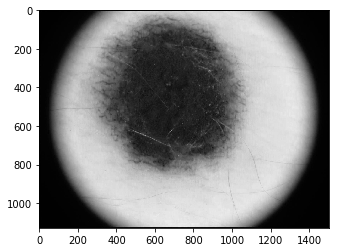

In [36]:
plt.imshow(im2,cmap='gray')

In [28]:
im[5]

array([255,   0,   0, ...,   0,   0, 255], dtype=uint8)

In [30]:
im[12]

array([254,   5,   0, ...,   0,   4, 253], dtype=uint8)

In [29]:
im

array([[255, 255, 255, ..., 255, 255, 255],
       [255,  28,   0, ...,   0,  27, 255],
       [255,   0,   0, ...,   0,   0, 255],
       ...,
       [252,   3,   0, ...,   0,   3, 253],
       [252,   3,   0, ...,   0,   3, 253],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)